In [1]:
import os
import sys
sys.path.append('/mnt/mnt/5TB_slot2/Tobias')
sys.path.append('/mnt/mnt/5TB_slot2/Tobias/TobiasPy/fastMRI')
sys.path.append('/mnt/mnt/4TB_pcie/fastBrain/')
import h5py
import numpy as np
import numpy.fft as nf
import matplotlib.pyplot as plt
import torch
from torch.utils.data import DataLoader
from models.unet.unet_model import UnetModel as UnetModel
from FF_net import FF_net
from FF_net import FF_simple_net
from FF_net import FF_net_tanh
from FF_net import Complex_net
import argparse
from common.args import Args
import models.unet.run_unet  as Run
import torch.nn as nn
import logging
import pathlib
import random
from torch.utils.data import Dataset
import time
from torch.nn import functional as F
import shutil
from tensorboardX import SummaryWriter
import torchvision
from torchvision import transforms, utils
import net_utils as nu
import calendar
import datetime
from longOne import ComplexFourier,ComplexEndToEnd
from complex_unet_model import ComplexUnetModel
from complex_end_to_end import ComplexEndToEnd, td_fourier_net

import sigpy as sp
import sigpy.plot as pl
import vd_spiral

from FF_net import Complex_net_ext

%load_ext autoreload
%reload_ext autoreload
%autoreload 2

In [2]:
sys.argv=['']
def create_arg_parser():
    timestamp = calendar.timegm(time.gmtime())
    human_readable = datetime.datetime.fromtimestamp(timestamp).isoformat()
    #human_readable="pure_inverse_fourier"
    human_readable="ComplexEndToEnd_Kspace_FourierTransform_Pure"
    parser = argparse.ArgumentParser(description="ML parameters")
    parser.add_argument('--num-pools', type=int, default=4, help='Number of U-Net pooling layers')
    parser.add_argument('--drop-prob', type=float, default=0.0, help='Dropout probability')
    parser.add_argument('--num-chans', type=int, default=32, help='Number of U-Net channels')

    parser.add_argument('--batch-size', default=8, type=int, help='Mini batch size')
    parser.add_argument('--num-epochs', type=int, default=250, help='Number of training epochs')
    parser.add_argument('--lr', type=float, default=0.0001, help='Learning rate')
    parser.add_argument('--lr-step-size', type=int, default=100,
                        help='Period of learning rate decay')
    parser.add_argument('--lr-gamma', type=float, default=0.1,
                        help='Multiplicative factor of learning rate decay')
    parser.add_argument('--weight-decay', type=float, default=0.01,
                        help='Strength of weight decay regularization')
    parser.add_argument('--momentum', type=float, default=0.1,
                        help='Strength of optimizer momentum')

    parser.add_argument('--report-interval', type=int, default=10000, help='Period of loss reporting')
    parser.add_argument('--data-parallel', default=True,
                        help='If set, use multiple GPUs using data parallelism')
    parser.add_argument('--device', type=str, default='cuda',
                        help='Which device to train on. Set to "cuda" to use the GPU')
    parser.add_argument('--exp-dir', type=pathlib.Path, default='/mnt/mnt/5TB_slot2/Tobias/Thesis/FF_lrelu_'+str(human_readable),
                        help='Path where model and results should be saved')
    parser.add_argument('--resume', action='store_true', default=False,
                        help='If set, resume the training from a previous model checkpoint. '
                             '"--checkpoint" should be set with this')
    parser.add_argument('--checkpoint', type=str, default='/mnt/mnt/5TB_slot2/Tobias/Thesis/FF_lrelu_'+str(human_readable)+'/best_model.pt',
                        help='Path to an existing checkpoint. Used along with "--resume"')
    parser.add_argument('--logdir', type=str, default='/mnt/mnt/5TB_slot2/Tobias/Thesis/log/ff_lrelu_'+str(human_readable),
                        help='Path to an existing checkpoint. Used along with "--resume"')
    parser.add_argument('--seed', default=42, type=int, help='Seed for random number generators')
    parser.add_argument('--resolution', default=128, type=int, help='Resolution of images')
    parser.add_argument('--device_ids', default=[0] , help='GPUS used')
    return parser
args=create_arg_parser().parse_args()
print("save to",args.checkpoint)

save to /mnt/mnt/5TB_slot2/Tobias/Thesis/FF_lrelu_ComplexEndToEnd_Kspace_FourierTransform_Pure/best_model.pt


In [3]:
def test_fourier():
    sig = np.random.randn(args.resolution) + 1j*np.random.randn(320)
    F = np.fft.ifft(sig, axis=-1)
    # First half of inputs/outputs is real part, second half is imaginary part
    X = torch.from_numpy(np.hstack([sig.real, sig.imag])).double()
    Y = torch.from_numpy((F.real**2+F.imag**2)**(1/2)).double()
    return X,Y

class SliceData(Dataset):
    """
    A PyTorch Dataset that provides access to MR image slices.
    """
    
    def __init__(self, root="/mnt/mnt/5TB_slot2/fastMRI/multicoil_train", sample_rate=1.):
        self.examples = []
        #potential to apply pre-process transform
        files = list(pathlib.Path(root).iterdir())
        if sample_rate < 1:
            #random.shuffle(files)
            num_files = round(len(files) * sample_rate)
            files = files[:num_files]
        for fname in sorted(files):
            print(fname)
            try:
                #print(h5py.File(fname, 'r').keys())
                #maybe also only randomly select parts of slices. Otherwise lot of outer noise-like structures.
                xml = h5py.File(fname, 'r')['ismrmrd_header']
                kspace = h5py.File(fname, 'r')['kspace']
                num_slices = kspace.shape[0]
                num_channels=kspace.shape[1]
                if (kspace.shape[-2]<args.resolution) or (kspace.shape[-1]<args.resolution):# or num_channels!=16:
                    continue
                print(len(self.examples))
                for slice in range(num_slices):
                    crop_size = (min(args.resolution, kspace.shape[-2]),min(args.resolution, kspace.shape[-1]))
                    k=nu.center_crop(kspace[slice], crop_size)[0]
                    target=abs(nu.make_ift(k))
                    m=np.max(target)
                    if m>0:
                        target/=m
                    else:
                        continue
                    k=nu.to_tensor(k).unsqueeze(0)
                    #us=nu.apply_mask(k,r=3)[0]#*args.resolution no undersampling for now
                    us=k
                    us/=m
                    if np.isnan(np.sum(target)):
                        continue
                    X=us#.flatten()
                    print(X.shape)
                    #print(X.shape)
                    Y=nu.to_tensor(target)
                    #print(Y.shape)
                    #X,Y=test_fourier()
                    self.examples += [(fname, slice, X, Y)]
            except:
                print("Couldn't open file")
    
    def __len__(self):
        return len(self.examples)
    
    def __getitem__(self, i):
        fname, slice, f, t = self.examples[i]
#         with h5py.File(fname, 'r') as data:
#             full=to_tensor(data['kspace'][slice])
#             crop_size = (min(args.resolution, full.shape[-3]),min(args.resolution, full.shape[-2]))          
#             full=complex_center_crop(full,crop_size)
            
#             kspace = to_tensor(data['kspace'][slice])
#             crop_size = (min(args.resolution, kspace.shape[-3]), min(args.resolution, kspace.shape[-2]))
#             kspace=apply_mask(kspace)[0]
#             kspace = complex_center_crop(kspace, crop_size)
            
        return (f, t)

In [4]:
def create_data_loaders():
    #batch_size=32
    #mask_func = None
    #if args.mask_kspace:
    #    mask_func = MaskFunc(args.center_fractions, args.accelerations)
    train_data = SliceData(root="/mnt/mnt/4TB_pcie/fastBrain/multicoil_train",sample_rate=0.25)
    dev_data = SliceData(root="/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain",sample_rate=0.25)
    test_data = SliceData(root="/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain",sample_rate=0.05)
    train_loader = DataLoader(
        dataset=train_data,
        batch_size=args.batch_size,
        shuffle=True,
        num_workers=0,
        pin_memory=True,
    )
    dev_loader = DataLoader(
        dataset=dev_data,
        batch_size=args.batch_size,
        shuffle=True,
        num_workers=0,
        pin_memory=True,
    )
    test_loader=None
#     test_loader = DataLoader(
#         dataset=test_data,
#         num_workers=0,
#         pin_memory=True,
#     )
    return train_loader, dev_loader, test_loader

In [5]:
t=time.time()
train_loader, dev_loader, test_loader= create_data_loaders()
print("Time taken to load data: ",time.time()-t)

/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXFLAIR_200_6002442.h5
0
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXFLAIR_200_6002466.h5
16
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2]

torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXFLAIR_201_6002917.h5
256
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXFLAIR_201_6002923.h5
272
torch.Size([1, 128, 128,

torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXFLAIR_201_6003008.h5
494
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXFLAIR_201_6003009.h5
510
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128,

torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXFLAIR_202_6000563.h5
746
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXFLAIR_202_6000576.h5
762
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128,

torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXT2_200_2000311.h5
1002
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fas

torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXT2_200_2000450.h5
1242
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXT2_200_2000453.h5
1258
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])

torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXT2_200_6001980.h5
1482
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXT2_200_6001994.h5
1498
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])

torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXT2_209_2090175.h5
1738
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXT2_209_2090185.h5
1754

torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXT2_209_2090242.h5
1976
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXT2_209_2090243.h5
1992
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])

torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXT2_209_2090389.h5
2228
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 1

torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXFLAIR_200_6002564.h5
14
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXFLAIR_200_6002625.h5
30
torch.Size([1, 128, 128, 2])
torch.Size([1, 1

torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT1POST_202_6000293.h5
248
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT1POST_202_6000378.h5
264
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([

torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT1POST_208_2080407.h5
520
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT1POST_208_2080427.h5
536
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([

torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT1_202_6000357.h5
776
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT1_206_2060052.h5
788
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 

torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT2_200_6002431.h5
1012
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT2_200_6002495.h5
1026
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128

torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT2_202_2020375.h5
1266
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT2_202_2020417.h5
1280
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128

torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT2_206_2060032.h5
1520
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT2_206_2060069.h5
1536
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128

torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT2_208_2080123.h5
1776
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT2_208_2080177.h5
1792
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128

torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT2_209_6001021.h5
2014
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT2_209_6001065.h5
2030
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128

torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT1POST_205_6000098.h5
78
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT1POST_207_2070053.h5
94
torch.Size([1,

torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT2_207_2070240.h5
318
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT2_207_2070513.h5
334
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 

with torch.no_grad():
        for (f, t) in train_loader:
            print(f.shape,t.shape)
            plt.imshow(abs(nu.make_ift(nu.to_complex(f)))[0,0,:,:])
            plt.show()
            plt.imshow(t[0,:,:])
            plt.show()

In [6]:
def build_model(args,chans=args.num_chans,num_pool_layers=args.num_pools,drop_prob=0.05):
    #check every time which gpus are available!
    #device_ids=[2,3,1]
    device_ids=args.device_ids
    model=td_fourier_net(in_chans=1,out_chans=1,drop_prob=args.drop_prob,resolution=args.resolution).to(args.device)
    model=model.double()
    if args.data_parallel and args.device=="cuda":
        model = nn.DataParallel(model,device_ids=device_ids)
    print("Model build successfully")
    #vis_weights(model)
    return model

def vis_weights(model):
    for name, param in model.named_parameters():
        if param.requires_grad:
            print(name, param.data)
            # Heat map of neuron weights
            plt.imshow(param.data.cpu(), vmin=np.min(param.data.cpu().numpy()), vmax=np.max(param.data.cpu().numpy()), cmap='coolwarm')
            plt.show()
#            fig,ax=plt.subplots(320,1,figsize=(16,16))
#             for i in range(320):
#                 ax[i].plot(param.data.cpu()[i,:320])
#             plt.show()

def build_optim(args,params):
    optimizer = torch.optim.Adadelta(params)
    return optimizer

def load_model(checkpoint_file,args):
    checkpoint = torch.load(checkpoint_file)
    args = checkpoint['args']
    model = build_model(args)
    model.load_state_dict(checkpoint['model'])

    optimizer = build_optim(args, model.parameters())
    optimizer.load_state_dict(checkpoint['optimizer'])
    print("Model load successfully")
    return checkpoint, model, optimizer

def save_model(args, exp_dir, epoch, model, optimizer, best_dev_loss, is_new_best):
    torch.save(
        {
            'epoch': epoch,
            'args': args,
            'model': model.state_dict(),
            'optimizer': optimizer.state_dict(),
            'best_dev_loss': best_dev_loss,
            'exp_dir': exp_dir
        },
        f=exp_dir / 'model.pt'
    )
    if is_new_best:
        shutil.copyfile(exp_dir / 'model.pt', exp_dir / 'best_model.pt')
        
def visualize(args, epoch, model, data_loader, writer):
    def save_image(image, tag):
        image -= image.min()
        image /= image.max()
        grid = torchvision.utils.make_grid(image, nrow=4, pad_value=1)
        writer.add_image(tag, grid, epoch)
    model.eval()
    
    with torch.no_grad():
        for iter, data in enumerate(data_loader):
            input, target = data
            input = input.unsqueeze(1).to(f'{args.device}:{args.device_ids[0]}')
            target = target.unsqueeze(1).to(f'{args.device}:{args.device_ids[0]}')
            output = model(input)
            save_image(target[0,:,:], 'Target')
            save_image(output[0,:,:], 'Reconstruction')
            save_image(torch.abs(target - output)[0,:,:], 'Error')
            break

In [7]:
def train_epoch(args, epoch, model, data_loader, optimizer, writer):
    model.train()
    print(model.device_ids)
    avg_loss = 0.
    start_epoch = start_iter = time.perf_counter()
    global_step = epoch * len(data_loader)
    for iter, data in enumerate(data_loader):
        f, t = data
        input = f.to(f'{args.device}:{model.device_ids[0]}')
        target = t.to(f'{args.device}:{model.device_ids[0]}')
        output_r,output_i = model(input)
        output = (output_r.squeeze(1)**2+output_i.squeeze(1)**2)**(1/2)
        
        loss = F.mse_loss(output, target)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        avg_loss = 0.99 * avg_loss + 0.01 * loss.item() if iter > 0 else loss.item()
        writer.add_scalar('TrainLoss', loss.item(), global_step + iter)

#         if iter % args.report_interval == 0:
#             print(f'Epoch = [{epoch:3d}/{args.num_epochs:3d}] ',
#                 f'Iter = [{iter:4d}/{len(data_loader):4d}] ',
#                 f'Loss = {loss.item():.4g} Avg Loss = {avg_loss:.4g} ',
#                 f'Time = {time.perf_counter() - start_iter:.4f}s')
#             logging.info(
#                 f'Epoch = [{epoch:3d}/{args.num_epochs:3d}] '
#                 f'Iter = [{iter:4d}/{len(data_loader):4d}] '
#                 f'Loss = {loss.item():.4g} Avg Loss = {avg_loss:.4g} '
#                 f'Time = {time.perf_counter() - start_iter:.4f}s',
#             )
        start_iter = time.perf_counter()
    return avg_loss, time.perf_counter() - start_epoch

def evaluate(args, epoch, model, data_loader, writer):
    model.eval()
    losses = []
    start = time.perf_counter()
    with torch.no_grad():
        for iter, data in enumerate(data_loader):
            f, t = data
            input = f.to(f'{args.device}:{model.device_ids[0]}')
            target = t.to(f'{args.device}:{model.device_ids[0]}')
            output_r,output_i = model(input)
            output = (output_r.squeeze(1)**2+output_i.squeeze(1)**2)**(1/2)

            #mean = mean.unsqueeze(1).unsqueeze(2).to(args.device)
            #std = std.unsqueeze(1).unsqueeze(2).to(args.device)
            #target = target * std + mean
            #output = output * std + mean

            #norm = norm.unsqueeze(1).unsqueeze(2).to(args.device)
            #loss = F.mse_loss(output / norm, target / norm, size_average=False)
            loss = F.mse_loss(output, target)
            losses.append(loss.item())
        writer.add_scalar('Dev_Loss', np.mean(losses), epoch)
        print('Dev_Loss', np.mean(losses),'Epoch', epoch)
    return np.mean(losses), time.perf_counter() - start

Model build successfully
[0]


/opt/conda/lib/python3.6/site-packages/torch/optim/lr_scheduler.py:143: UserWarning: The epoch parameter in `scheduler.step()` was not necessary and is being deprecated where possible. Please use `scheduler.step()` to step the scheduler. During the deprecation, if epoch is different from None, the closed form is used instead of the new chainable form, where available. Please open an issue if you are unable to replicate your use case: https://github.com/pytorch/pytorch/issues/new/choose.
  warnings.warn(EPOCH_DEPRECATION_WARNING, UserWarning)


Dev_Loss 0.002728589957273625 Epoch 0
Epoch = [   0/ 250] TrainLoss = 5.212  DevLoss = 0.002729 TrainTime = 11.9409s DevTime = 6.3963s


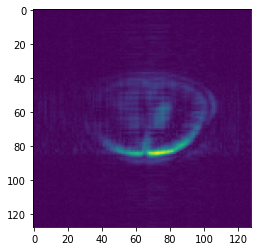

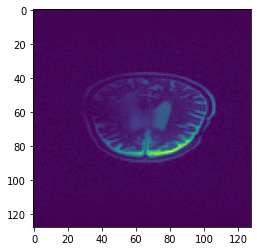

Time taken for epoch:  18.690068244934082
[0]
Dev_Loss 0.0040118547879018345 Epoch 1
Epoch = [   1/ 250] TrainLoss = 0.003288  DevLoss = 0.004012 TrainTime = 4.7450s DevTime = 0.7513s


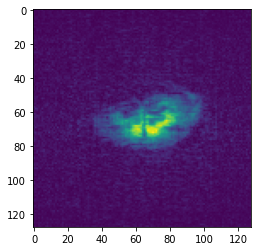

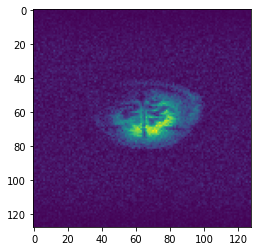

Time taken for epoch:  5.793711185455322
[0]
Dev_Loss 0.001047800942495581 Epoch 2
Epoch = [   2/ 250] TrainLoss = 0.002919  DevLoss = 0.001048 TrainTime = 1.7062s DevTime = 0.8115s


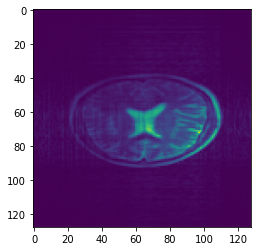

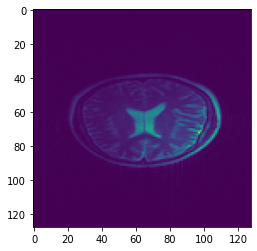

Time taken for epoch:  2.788651704788208
[0]
Dev_Loss 0.0006203935584654087 Epoch 3
Epoch = [   3/ 250] TrainLoss = 0.002271  DevLoss = 0.0006204 TrainTime = 1.4883s DevTime = 0.6660s


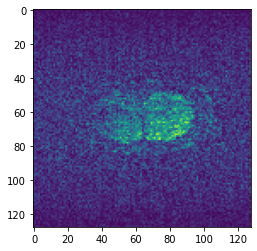

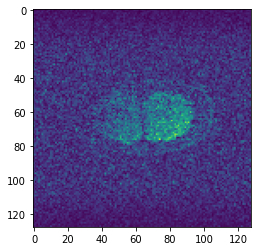

Time taken for epoch:  2.5513293743133545
[0]
Dev_Loss 0.0016173807750275784 Epoch 4
Epoch = [   4/ 250] TrainLoss = 0.00253  DevLoss = 0.001617 TrainTime = 1.9398s DevTime = 0.7632s


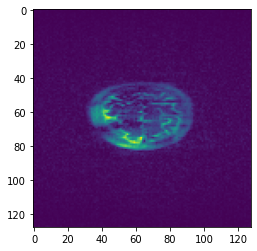

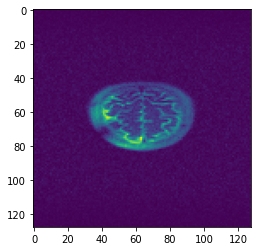

Time taken for epoch:  2.9898178577423096
[0]
Dev_Loss 0.0010005467119372964 Epoch 5
Epoch = [   5/ 250] TrainLoss = 0.001964  DevLoss = 0.001001 TrainTime = 1.5438s DevTime = 0.6691s


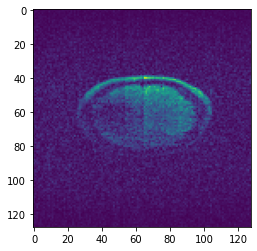

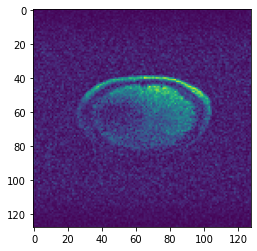

Time taken for epoch:  2.5119247436523438
[0]
Dev_Loss 0.0005626744912766154 Epoch 6
Epoch = [   6/ 250] TrainLoss = 0.001766  DevLoss = 0.0005627 TrainTime = 1.6075s DevTime = 0.7987s


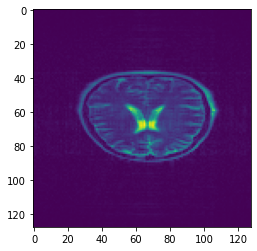

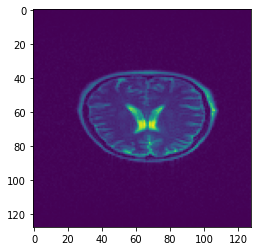

Time taken for epoch:  2.6830267906188965
[0]
Dev_Loss 0.0003864442418968769 Epoch 7
Epoch = [   7/ 250] TrainLoss = 0.001444  DevLoss = 0.0003864 TrainTime = 1.5914s DevTime = 0.6722s


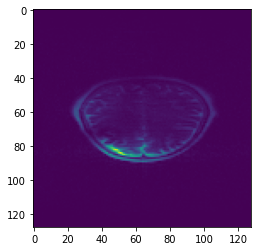

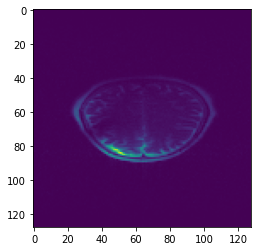

Time taken for epoch:  2.5490989685058594
[0]
Dev_Loss 0.001886529625120345 Epoch 8
Epoch = [   8/ 250] TrainLoss = 0.001433  DevLoss = 0.001887 TrainTime = 1.5318s DevTime = 0.6736s


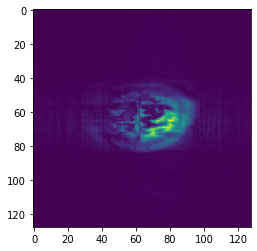

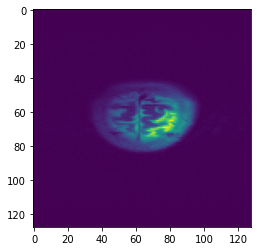

Time taken for epoch:  2.46657133102417
[0]
Dev_Loss 0.00046175341843690835 Epoch 9
Epoch = [   9/ 250] TrainLoss = 0.001348  DevLoss = 0.0004618 TrainTime = 1.9667s DevTime = 0.7658s


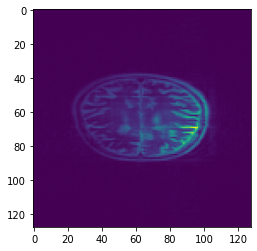

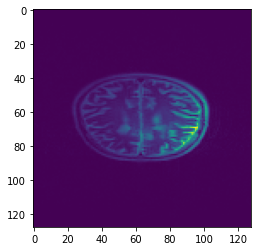

Time taken for epoch:  2.9900455474853516
[0]
Dev_Loss 0.003945112917089657 Epoch 10
Epoch = [  10/ 250] TrainLoss = 0.001056  DevLoss = 0.003945 TrainTime = 1.6336s DevTime = 0.7157s


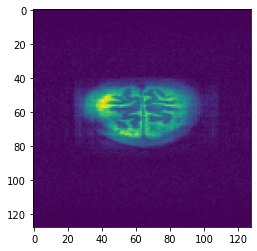

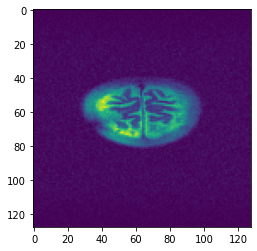

Time taken for epoch:  2.6317474842071533
[0]
Dev_Loss 0.0004761841649259883 Epoch 11
Epoch = [  11/ 250] TrainLoss = 0.001198  DevLoss = 0.0004762 TrainTime = 1.7592s DevTime = 0.7074s


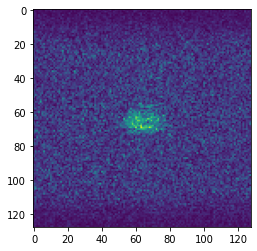

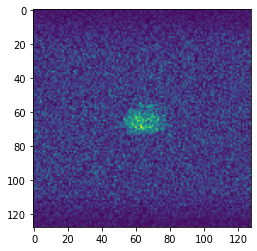

Time taken for epoch:  2.7576100826263428
[0]
Dev_Loss 0.0031663962287263943 Epoch 12
Epoch = [  12/ 250] TrainLoss = 0.001052  DevLoss = 0.003166 TrainTime = 1.5935s DevTime = 0.6924s


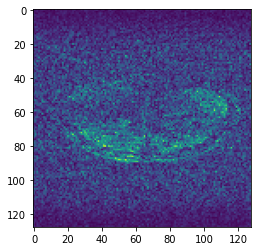

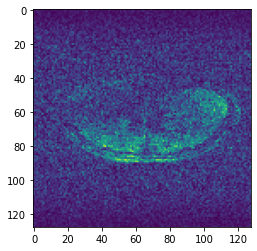

Time taken for epoch:  2.6643741130828857
[0]
Dev_Loss 0.0008592325238024474 Epoch 13
Epoch = [  13/ 250] TrainLoss = 0.001096  DevLoss = 0.0008592 TrainTime = 1.5246s DevTime = 0.7760s


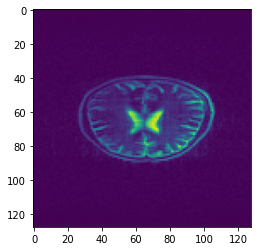

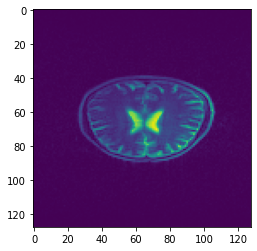

Time taken for epoch:  2.568960189819336
[0]
Dev_Loss 0.00023123576782513964 Epoch 14
Epoch = [  14/ 250] TrainLoss = 0.0009223  DevLoss = 0.0002312 TrainTime = 1.7660s DevTime = 0.7062s


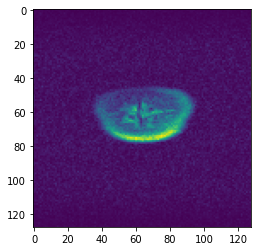

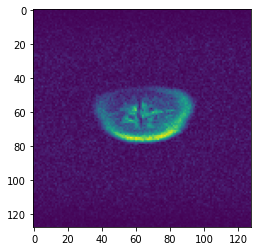

Time taken for epoch:  2.7718889713287354
[0]
Dev_Loss 0.0002295438702240773 Epoch 15
Epoch = [  15/ 250] TrainLoss = 0.0008023  DevLoss = 0.0002295 TrainTime = 1.8587s DevTime = 0.7194s


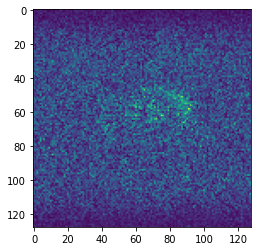

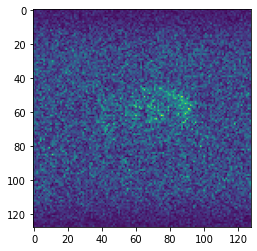

Time taken for epoch:  2.8774449825286865
[0]
Dev_Loss 0.000858269471869915 Epoch 16
Epoch = [  16/ 250] TrainLoss = 0.0007595  DevLoss = 0.0008583 TrainTime = 2.0218s DevTime = 0.9139s


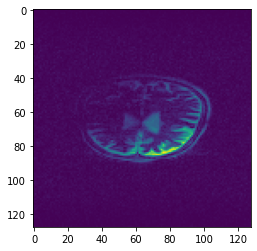

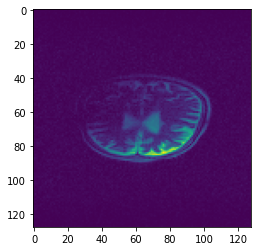

Time taken for epoch:  3.215496063232422
[0]
Dev_Loss 0.004385403163622579 Epoch 17
Epoch = [  17/ 250] TrainLoss = 0.000819  DevLoss = 0.004385 TrainTime = 1.6441s DevTime = 0.7540s


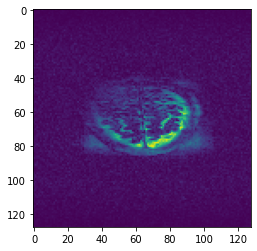

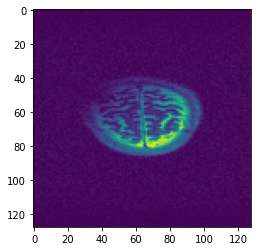

Time taken for epoch:  2.732943058013916
[0]
Dev_Loss 0.0012198316752418186 Epoch 18
Epoch = [  18/ 250] TrainLoss = 0.0009886  DevLoss = 0.00122 TrainTime = 1.8239s DevTime = 0.7081s


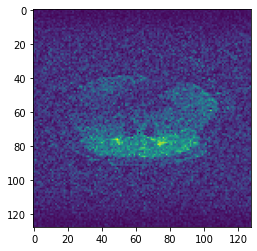

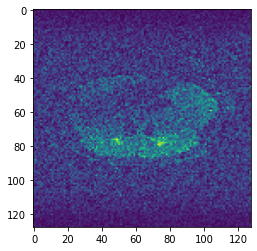

Time taken for epoch:  2.816014289855957
[0]
Dev_Loss 0.0012743637519577334 Epoch 19
Epoch = [  19/ 250] TrainLoss = 0.0007246  DevLoss = 0.001274 TrainTime = 1.5629s DevTime = 0.7155s


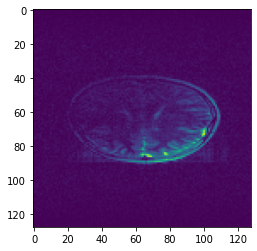

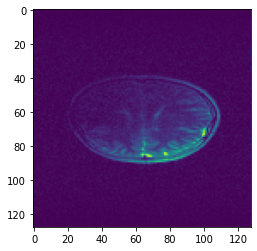

Time taken for epoch:  2.561612606048584
[0]
Dev_Loss 0.002398212770098178 Epoch 20
Epoch = [  20/ 250] TrainLoss = 0.0008638  DevLoss = 0.002398 TrainTime = 1.5533s DevTime = 0.7108s


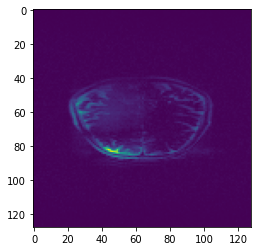

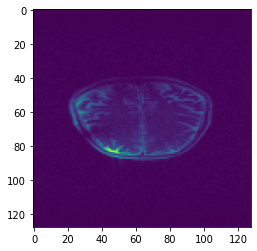

Time taken for epoch:  2.5338985919952393
[0]
Dev_Loss 0.0007649806562650979 Epoch 21
Epoch = [  21/ 250] TrainLoss = 0.0008098  DevLoss = 0.000765 TrainTime = 1.5283s DevTime = 0.6675s


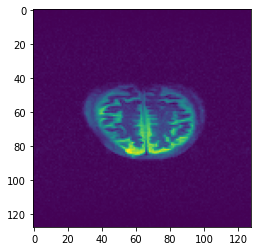

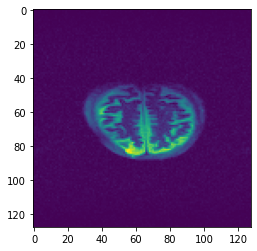

Time taken for epoch:  2.475994110107422
[0]
Dev_Loss 0.008586575870336096 Epoch 22
Epoch = [  22/ 250] TrainLoss = 0.0008493  DevLoss = 0.008587 TrainTime = 1.5110s DevTime = 0.7078s


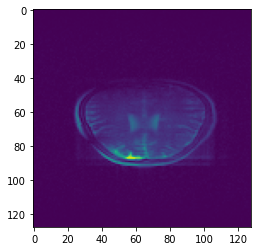

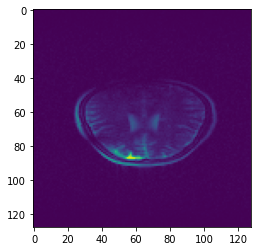

Time taken for epoch:  2.5874106884002686
[0]
Dev_Loss 0.00017100225725723162 Epoch 23
Epoch = [  23/ 250] TrainLoss = 0.0008942  DevLoss = 0.000171 TrainTime = 1.6557s DevTime = 0.7940s


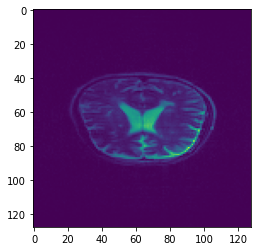

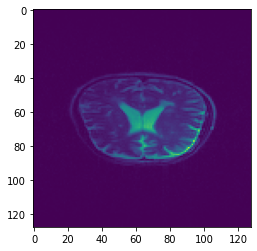

Time taken for epoch:  2.7086944580078125
[0]
Dev_Loss 0.00041500483558316783 Epoch 24
Epoch = [  24/ 250] TrainLoss = 0.0007271  DevLoss = 0.000415 TrainTime = 1.5401s DevTime = 0.6768s


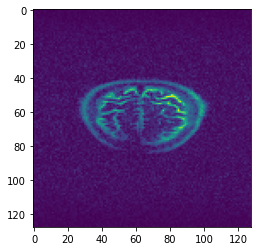

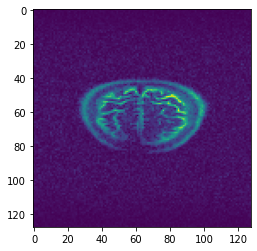

Time taken for epoch:  2.5092296600341797
[0]
Dev_Loss 0.0002558637222667641 Epoch 25
Epoch = [  25/ 250] TrainLoss = 0.0005994  DevLoss = 0.0002559 TrainTime = 1.5106s DevTime = 0.6994s


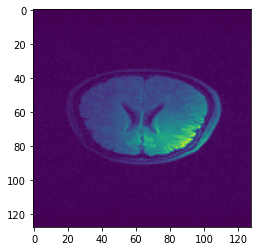

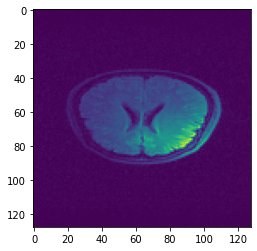

Time taken for epoch:  2.4864890575408936
[0]
Dev_Loss 0.0013263629668728008 Epoch 26
Epoch = [  26/ 250] TrainLoss = 0.0006601  DevLoss = 0.001326 TrainTime = 1.5156s DevTime = 0.7020s


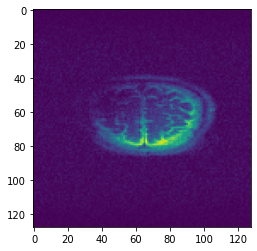

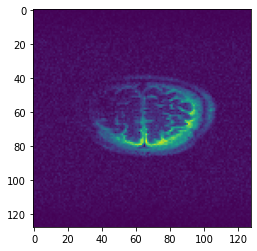

Time taken for epoch:  2.503934383392334
[0]
Dev_Loss 0.0009315896677446703 Epoch 27
Epoch = [  27/ 250] TrainLoss = 0.0008085  DevLoss = 0.0009316 TrainTime = 1.5116s DevTime = 0.6687s


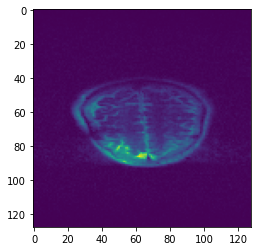

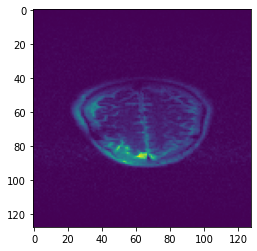

Time taken for epoch:  2.4549496173858643
[0]
Dev_Loss 0.0020671274575553168 Epoch 28
Epoch = [  28/ 250] TrainLoss = 0.0009131  DevLoss = 0.002067 TrainTime = 1.6221s DevTime = 0.7042s


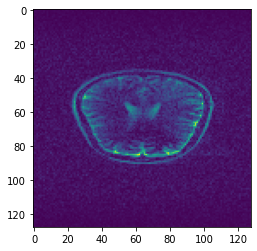

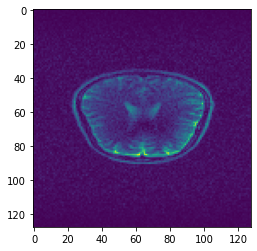

Time taken for epoch:  2.615756034851074
[0]
Dev_Loss 7.842584751302345e-05 Epoch 29
Epoch = [  29/ 250] TrainLoss = 0.0006459  DevLoss = 7.843e-05 TrainTime = 1.5904s DevTime = 0.7948s


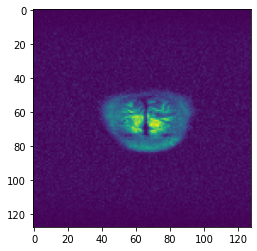

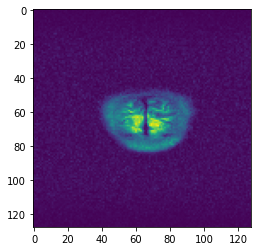

Time taken for epoch:  2.6687631607055664
[0]
Dev_Loss 0.0005017269465626953 Epoch 30
Epoch = [  30/ 250] TrainLoss = 0.0006043  DevLoss = 0.0005017 TrainTime = 1.5143s DevTime = 0.6715s


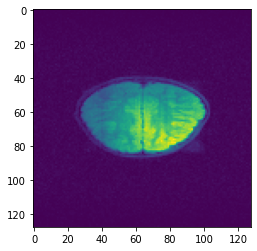

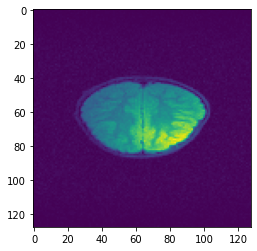

Time taken for epoch:  2.46319842338562
[0]
Dev_Loss 0.00030361508297331336 Epoch 31
Epoch = [  31/ 250] TrainLoss = 0.0005899  DevLoss = 0.0003036 TrainTime = 1.5313s DevTime = 0.7058s


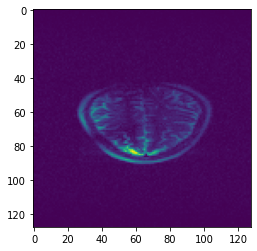

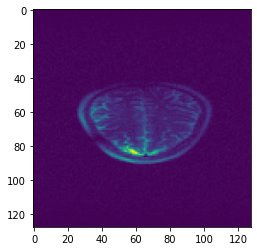

Time taken for epoch:  2.6102073192596436
[0]
Dev_Loss 0.00024135674599751208 Epoch 32
Epoch = [  32/ 250] TrainLoss = 0.0008993  DevLoss = 0.0002414 TrainTime = 1.5627s DevTime = 0.6739s


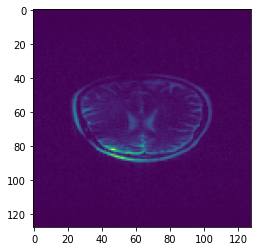

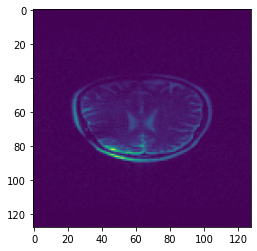

Time taken for epoch:  2.527411460876465
[0]
Dev_Loss 0.00016370912992883844 Epoch 33
Epoch = [  33/ 250] TrainLoss = 0.0006244  DevLoss = 0.0001637 TrainTime = 1.5568s DevTime = 0.6890s


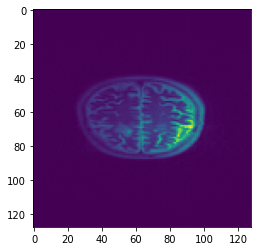

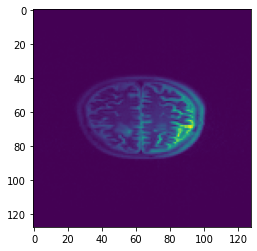

Time taken for epoch:  2.5026233196258545
[0]
Dev_Loss 0.005121342066189229 Epoch 34
Epoch = [  34/ 250] TrainLoss = 0.0006868  DevLoss = 0.005121 TrainTime = 1.5430s DevTime = 0.7318s


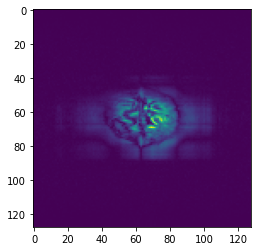

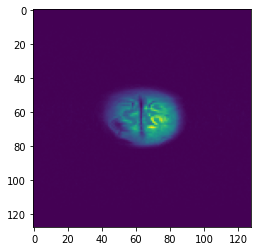

Time taken for epoch:  2.5280606746673584
[0]
Dev_Loss 0.0006468422464258845 Epoch 35
Epoch = [  35/ 250] TrainLoss = 0.001004  DevLoss = 0.0006468 TrainTime = 1.5809s DevTime = 0.6854s


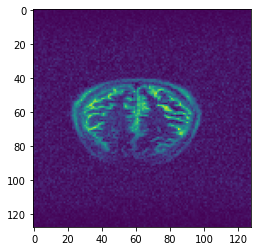

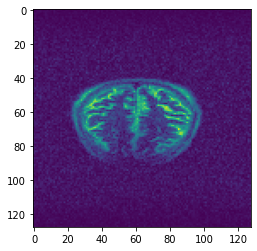

Time taken for epoch:  2.5611631870269775
[0]
Dev_Loss 0.000630415368228954 Epoch 36
Epoch = [  36/ 250] TrainLoss = 0.000592  DevLoss = 0.0006304 TrainTime = 1.5376s DevTime = 0.6859s


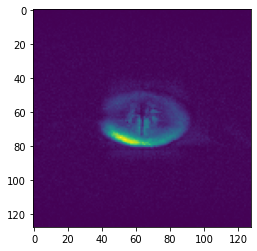

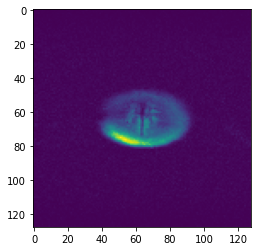

Time taken for epoch:  2.5060229301452637
[0]
Dev_Loss 0.000866820901193203 Epoch 37
Epoch = [  37/ 250] TrainLoss = 0.0006495  DevLoss = 0.0008668 TrainTime = 1.6006s DevTime = 0.7430s


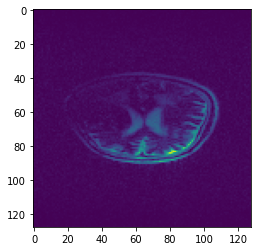

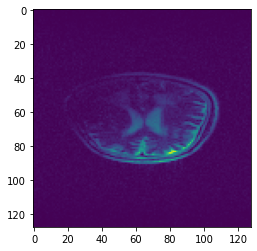

Time taken for epoch:  2.6285276412963867
[0]
Dev_Loss 5.753203619586856e-05 Epoch 38
Epoch = [  38/ 250] TrainLoss = 0.000701  DevLoss = 5.753e-05 TrainTime = 1.6071s DevTime = 0.7537s


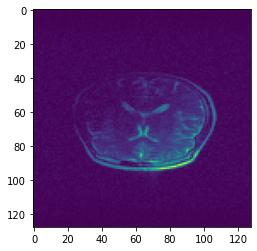

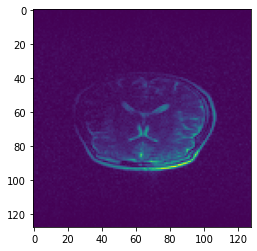

Time taken for epoch:  2.654707908630371
[0]
Dev_Loss 0.0001728961698180268 Epoch 39
Epoch = [  39/ 250] TrainLoss = 0.0006375  DevLoss = 0.0001729 TrainTime = 1.5484s DevTime = 0.6995s


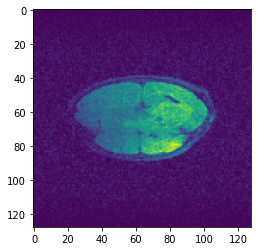

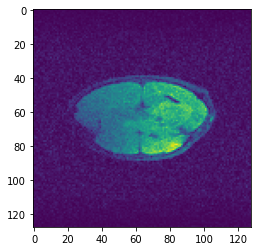

Time taken for epoch:  2.5424787998199463
[0]
Dev_Loss 0.0004541820434329498 Epoch 40
Epoch = [  40/ 250] TrainLoss = 0.0006182  DevLoss = 0.0004542 TrainTime = 1.5476s DevTime = 0.7280s


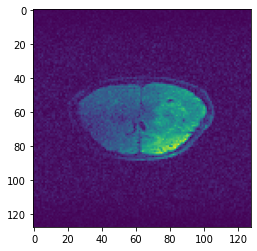

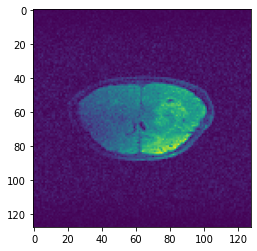

Time taken for epoch:  2.5673062801361084
[0]
Dev_Loss 0.0001254739812395239 Epoch 41
Epoch = [  41/ 250] TrainLoss = 0.000789  DevLoss = 0.0001255 TrainTime = 1.5455s DevTime = 0.6960s


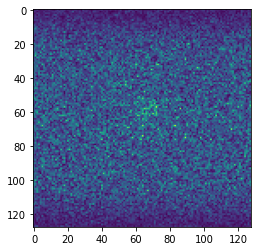

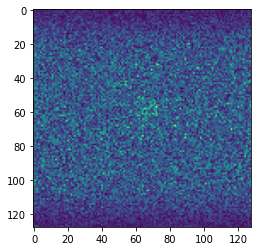

Time taken for epoch:  2.6279094219207764
[0]
Dev_Loss 0.011093259211969164 Epoch 42
Epoch = [  42/ 250] TrainLoss = 0.0007336  DevLoss = 0.01109 TrainTime = 1.5414s DevTime = 0.7096s


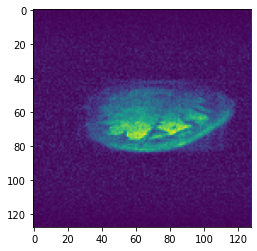

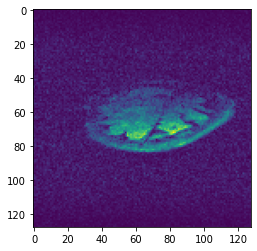

Time taken for epoch:  2.5549869537353516
[0]
Dev_Loss 0.00011051385423280487 Epoch 43
Epoch = [  43/ 250] TrainLoss = 0.001142  DevLoss = 0.0001105 TrainTime = 2.3398s DevTime = 0.6886s


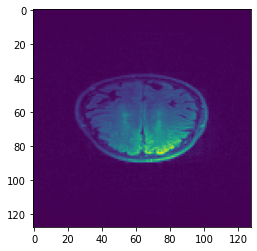

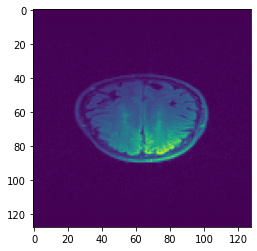

Time taken for epoch:  3.3010716438293457
[0]
Dev_Loss 0.0001369136845305714 Epoch 44
Epoch = [  44/ 250] TrainLoss = 0.0007044  DevLoss = 0.0001369 TrainTime = 1.6804s DevTime = 0.7391s


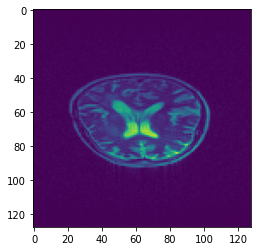

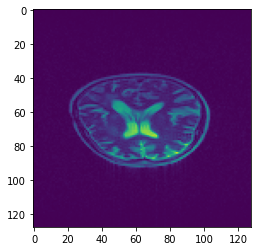

Time taken for epoch:  2.6811161041259766
[0]
Dev_Loss 4.441552263377532e-05 Epoch 45
Epoch = [  45/ 250] TrainLoss = 0.0007646  DevLoss = 4.442e-05 TrainTime = 1.5585s DevTime = 0.7741s


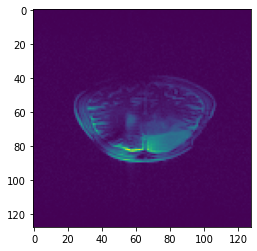

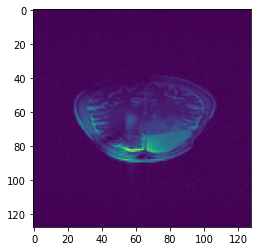

Time taken for epoch:  2.6137092113494873
[0]
Dev_Loss 0.002820762838769413 Epoch 46
Epoch = [  46/ 250] TrainLoss = 0.000737  DevLoss = 0.002821 TrainTime = 1.7197s DevTime = 0.9611s


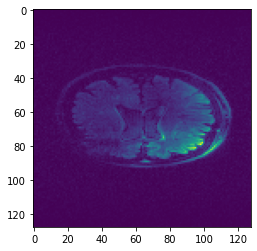

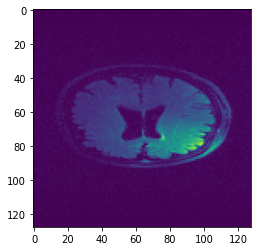

Time taken for epoch:  3.01470947265625
[0]
Dev_Loss 6.251330489524661e-05 Epoch 47
Epoch = [  47/ 250] TrainLoss = 0.0008315  DevLoss = 6.251e-05 TrainTime = 2.5208s DevTime = 0.6746s


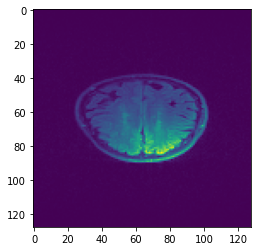

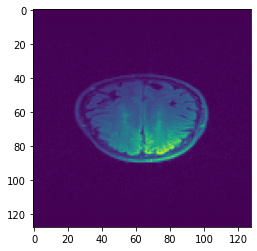

Time taken for epoch:  3.478400230407715
[0]
Dev_Loss 4.3029870584125166e-05 Epoch 48
Epoch = [  48/ 250] TrainLoss = 0.0006523  DevLoss = 4.303e-05 TrainTime = 1.5098s DevTime = 0.8544s


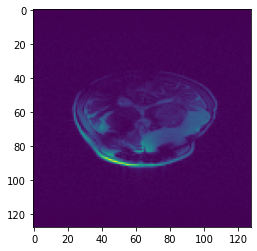

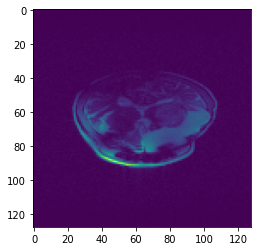

Time taken for epoch:  2.6414618492126465
[0]
Dev_Loss 0.00014211941602117176 Epoch 49
Epoch = [  49/ 250] TrainLoss = 0.0006847  DevLoss = 0.0001421 TrainTime = 1.5183s DevTime = 0.6733s


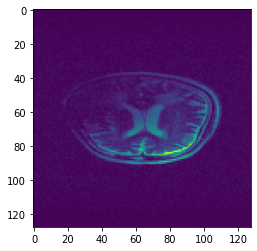

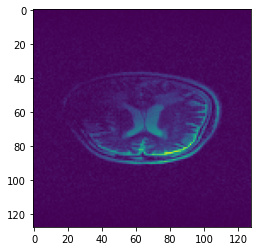

Time taken for epoch:  2.462277412414551
[0]
Dev_Loss 0.00023804754384496818 Epoch 50
Epoch = [  50/ 250] TrainLoss = 0.0005122  DevLoss = 0.000238 TrainTime = 1.5215s DevTime = 0.8090s


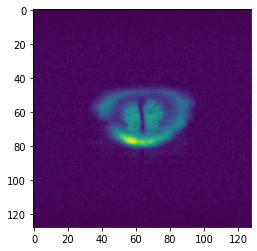

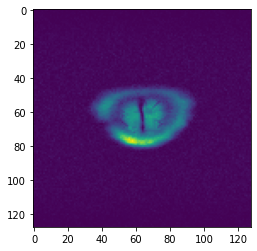

Time taken for epoch:  2.704110860824585
[0]
Dev_Loss 7.161972805070109e-05 Epoch 51
Epoch = [  51/ 250] TrainLoss = 0.0006068  DevLoss = 7.162e-05 TrainTime = 1.6786s DevTime = 0.7270s


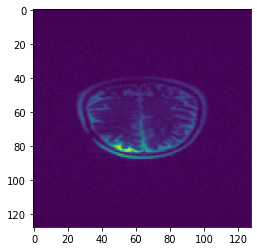

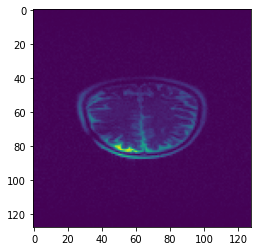

Time taken for epoch:  2.68501877784729
[0]
Dev_Loss 0.010552038705515332 Epoch 52
Epoch = [  52/ 250] TrainLoss = 0.0007318  DevLoss = 0.01055 TrainTime = 1.5874s DevTime = 0.6726s


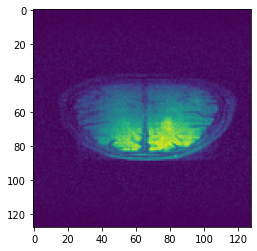

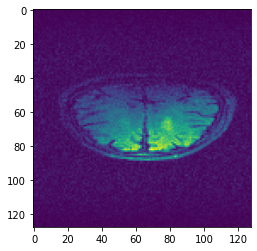

Time taken for epoch:  2.556736469268799
[0]
Dev_Loss 0.002636067478106066 Epoch 53
Epoch = [  53/ 250] TrainLoss = 0.001168  DevLoss = 0.002636 TrainTime = 1.5208s DevTime = 0.7428s


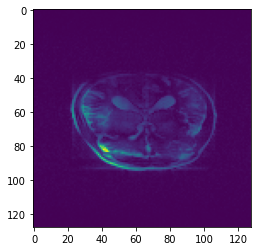

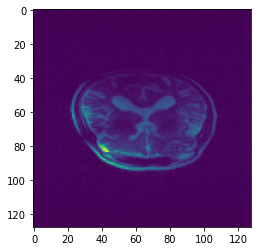

Time taken for epoch:  2.5417232513427734
[0]
Dev_Loss 0.00023029751778341263 Epoch 54
Epoch = [  54/ 250] TrainLoss = 0.0009127  DevLoss = 0.0002303 TrainTime = 1.5305s DevTime = 0.7058s


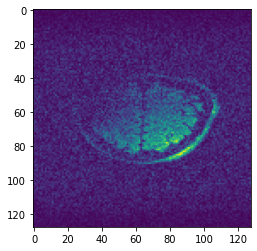

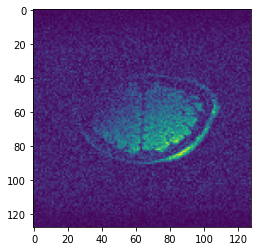

Time taken for epoch:  2.5328238010406494
[0]
Dev_Loss 0.004725313175531521 Epoch 55
Epoch = [  55/ 250] TrainLoss = 0.0006395  DevLoss = 0.004725 TrainTime = 1.5190s DevTime = 0.6756s


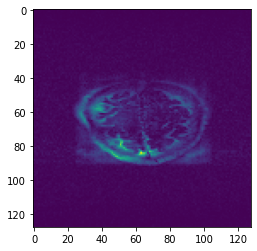

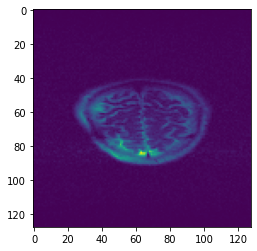

Time taken for epoch:  2.4729886054992676
[0]
Dev_Loss 2.2358714948936315e-05 Epoch 56
Epoch = [  56/ 250] TrainLoss = 0.0006566  DevLoss = 2.236e-05 TrainTime = 1.4820s DevTime = 0.7131s


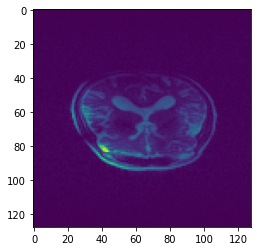

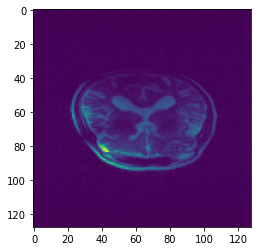

Time taken for epoch:  2.479875087738037
[0]
Dev_Loss 0.00016698117723975295 Epoch 57
Epoch = [  57/ 250] TrainLoss = 0.0006264  DevLoss = 0.000167 TrainTime = 1.5143s DevTime = 0.7040s


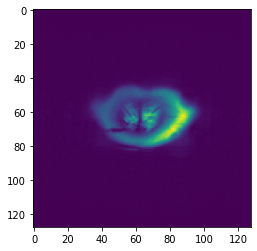

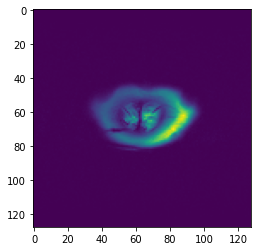

Time taken for epoch:  2.484734296798706
[0]
Dev_Loss 0.0060364187575979045 Epoch 58
Epoch = [  58/ 250] TrainLoss = 0.0005238  DevLoss = 0.006036 TrainTime = 1.5601s DevTime = 0.6947s


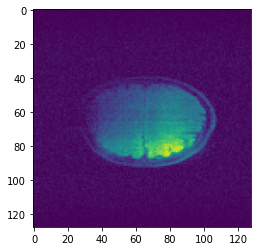

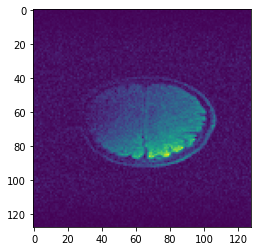

Time taken for epoch:  2.537238121032715
[0]
Dev_Loss 0.000548075645764206 Epoch 59
Epoch = [  59/ 250] TrainLoss = 0.0008428  DevLoss = 0.0005481 TrainTime = 1.6128s DevTime = 0.7049s


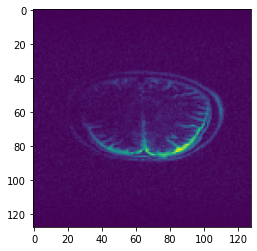

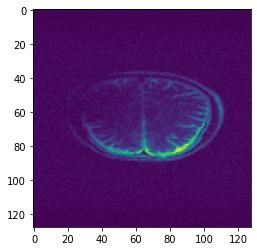

Time taken for epoch:  2.595191240310669
[0]
Dev_Loss 0.0008622251679788365 Epoch 60
Epoch = [  60/ 250] TrainLoss = 0.0007139  DevLoss = 0.0008622 TrainTime = 1.5230s DevTime = 0.7784s


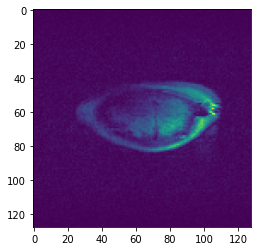

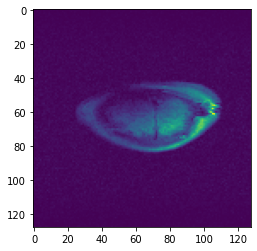

Time taken for epoch:  2.67331862449646
[0]
Dev_Loss 6.475211692751415e-05 Epoch 61
Epoch = [  61/ 250] TrainLoss = 0.0007061  DevLoss = 6.475e-05 TrainTime = 1.5590s DevTime = 0.6697s


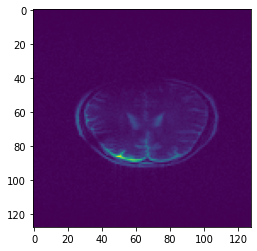

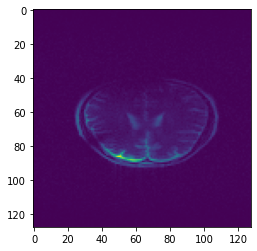

Time taken for epoch:  2.4910318851470947
[0]
Dev_Loss 0.0005292337581063555 Epoch 62
Epoch = [  62/ 250] TrainLoss = 0.0005831  DevLoss = 0.0005292 TrainTime = 1.9428s DevTime = 0.6858s


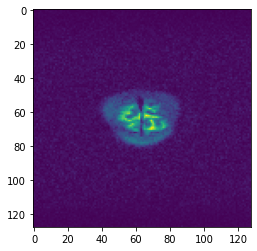

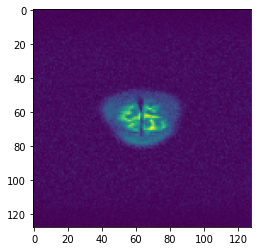

Time taken for epoch:  2.914936065673828
[0]
Dev_Loss 0.000767668090469177 Epoch 63
Epoch = [  63/ 250] TrainLoss = 0.0006377  DevLoss = 0.0007677 TrainTime = 1.5503s DevTime = 0.7129s


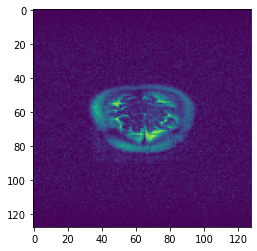

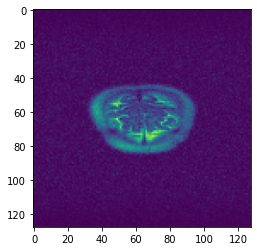

Time taken for epoch:  2.5416810512542725
[0]
Dev_Loss 0.00010935914330385062 Epoch 64
Epoch = [  64/ 250] TrainLoss = 0.0007209  DevLoss = 0.0001094 TrainTime = 1.5569s DevTime = 0.6692s


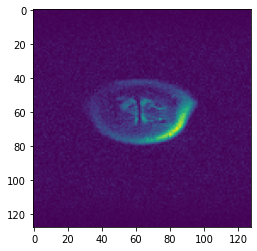

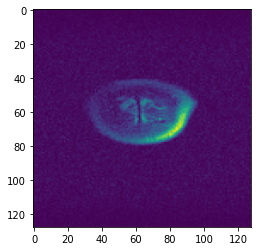

Time taken for epoch:  2.516679048538208
[0]
Dev_Loss 0.0006559988413050931 Epoch 65
Epoch = [  65/ 250] TrainLoss = 0.0006742  DevLoss = 0.000656 TrainTime = 1.5134s DevTime = 0.6680s


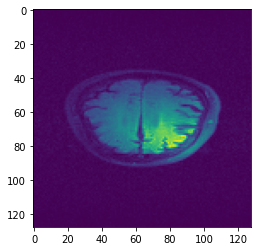

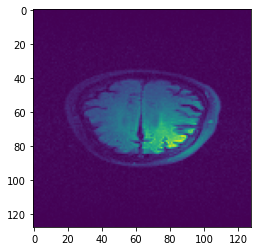

Time taken for epoch:  2.469365119934082
[0]
Dev_Loss 0.000897318096041826 Epoch 66
Epoch = [  66/ 250] TrainLoss = 0.0007603  DevLoss = 0.0008973 TrainTime = 1.5977s DevTime = 0.7396s


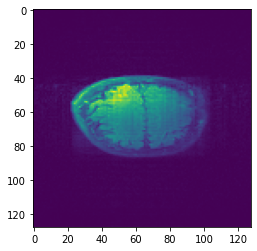

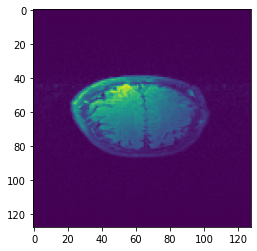

Time taken for epoch:  2.6051888465881348
[0]
Dev_Loss 0.00040044978467723935 Epoch 67
Epoch = [  67/ 250] TrainLoss = 0.0007528  DevLoss = 0.0004004 TrainTime = 1.6212s DevTime = 0.6943s


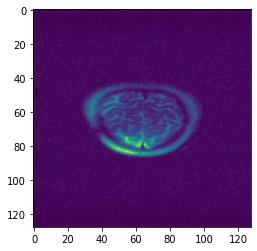

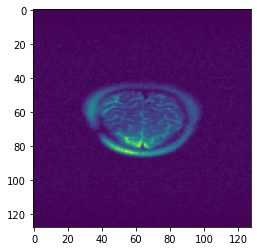

Time taken for epoch:  2.602607488632202
[0]
Dev_Loss 0.0025458517604703243 Epoch 68
Epoch = [  68/ 250] TrainLoss = 0.0006875  DevLoss = 0.002546 TrainTime = 1.5127s DevTime = 0.7442s


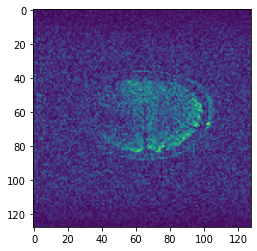

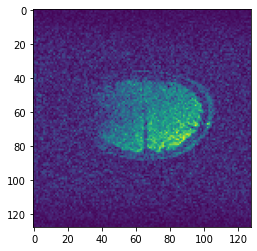

Time taken for epoch:  2.554236888885498
[0]
Dev_Loss 0.00013275090906180465 Epoch 69
Epoch = [  69/ 250] TrainLoss = 0.0007973  DevLoss = 0.0001328 TrainTime = 1.5581s DevTime = 0.7218s


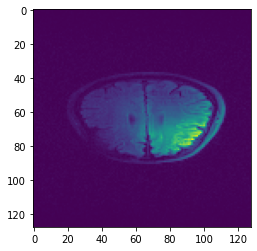

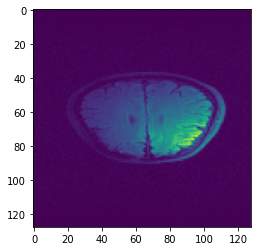

Time taken for epoch:  2.6421172618865967
[0]
Dev_Loss 0.00011280365933368114 Epoch 70
Epoch = [  70/ 250] TrainLoss = 0.000693  DevLoss = 0.0001128 TrainTime = 1.5740s DevTime = 0.6918s


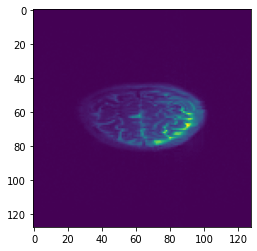

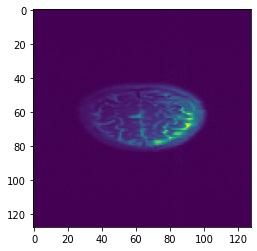

Time taken for epoch:  2.529784917831421
[0]
Dev_Loss 0.0002372718733284107 Epoch 71
Epoch = [  71/ 250] TrainLoss = 0.0006858  DevLoss = 0.0002373 TrainTime = 1.5322s DevTime = 0.6902s


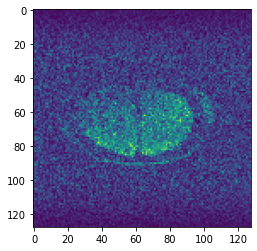

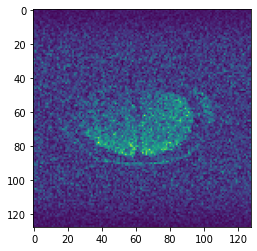

Time taken for epoch:  2.5169122219085693
[0]
Dev_Loss 0.000260875038369372 Epoch 72
Epoch = [  72/ 250] TrainLoss = 0.0006115  DevLoss = 0.0002609 TrainTime = 1.5891s DevTime = 0.8341s


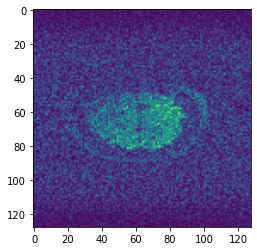

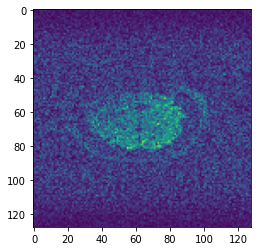

Time taken for epoch:  2.717034339904785
[0]
Dev_Loss 0.00017147523128529984 Epoch 73
Epoch = [  73/ 250] TrainLoss = 0.0005733  DevLoss = 0.0001715 TrainTime = 1.6484s DevTime = 0.7462s


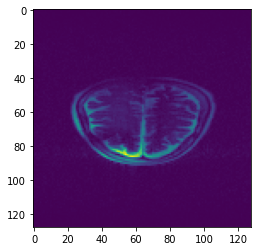

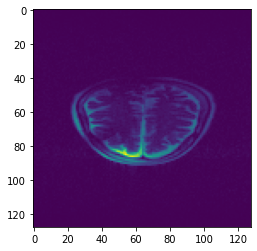

Time taken for epoch:  2.674452066421509
[0]
Dev_Loss 0.00012152626299285447 Epoch 74
Epoch = [  74/ 250] TrainLoss = 0.000682  DevLoss = 0.0001215 TrainTime = 1.6117s DevTime = 0.7625s


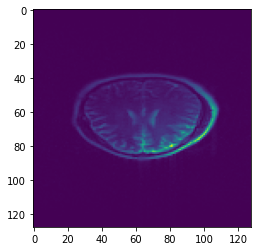

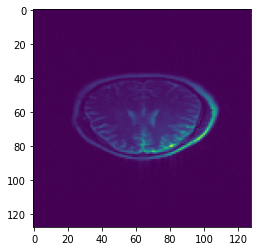

Time taken for epoch:  2.627535104751587
[0]
Dev_Loss 0.0007300600915667995 Epoch 75
Epoch = [  75/ 250] TrainLoss = 0.0006433  DevLoss = 0.0007301 TrainTime = 1.5438s DevTime = 0.7260s


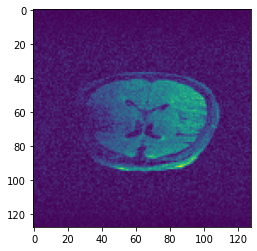

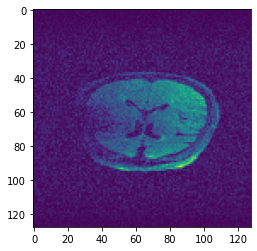

Time taken for epoch:  2.5628161430358887
[0]
Dev_Loss 7.895629750751394e-05 Epoch 76
Epoch = [  76/ 250] TrainLoss = 0.0006052  DevLoss = 7.896e-05 TrainTime = 1.5349s DevTime = 0.7264s


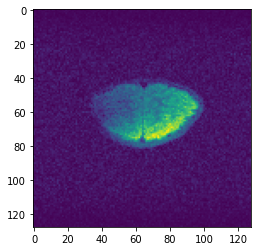

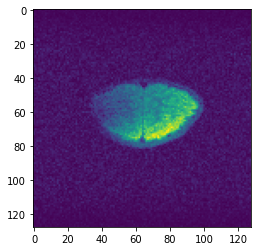

Time taken for epoch:  2.5490264892578125
[0]
Dev_Loss 0.0057249807638315555 Epoch 77
Epoch = [  77/ 250] TrainLoss = 0.0006359  DevLoss = 0.005725 TrainTime = 1.5338s DevTime = 0.6897s


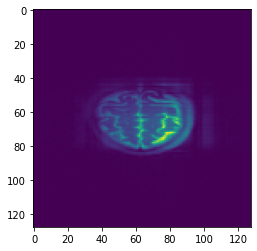

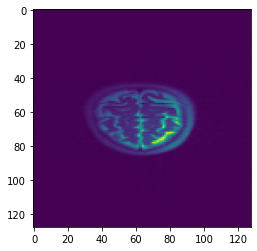

Time taken for epoch:  2.4730725288391113
[0]
Dev_Loss 0.0017425182590803765 Epoch 78
Epoch = [  78/ 250] TrainLoss = 0.000851  DevLoss = 0.001743 TrainTime = 1.6098s DevTime = 1.0492s


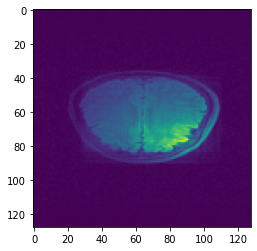

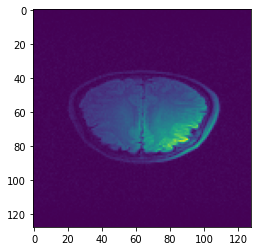

Time taken for epoch:  2.9263601303100586
[0]
Dev_Loss 0.000435853917112194 Epoch 79
Epoch = [  79/ 250] TrainLoss = 0.0006576  DevLoss = 0.0004359 TrainTime = 1.5835s DevTime = 1.1570s


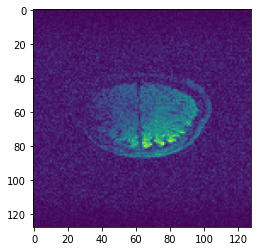

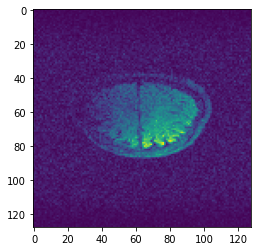

Time taken for epoch:  3.1228296756744385
[0]
Dev_Loss 0.0003111284019749194 Epoch 80
Epoch = [  80/ 250] TrainLoss = 0.0006941  DevLoss = 0.0003111 TrainTime = 1.9454s DevTime = 0.9522s


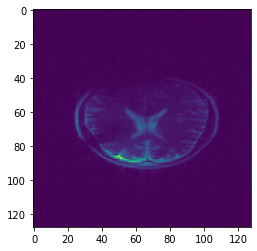

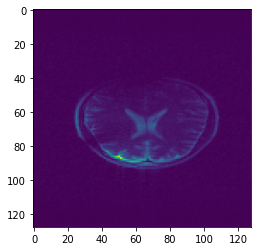

Time taken for epoch:  3.1752054691314697
[0]
Dev_Loss 0.0008665943864093626 Epoch 81
Epoch = [  81/ 250] TrainLoss = 0.0006179  DevLoss = 0.0008666 TrainTime = 1.5411s DevTime = 0.7165s


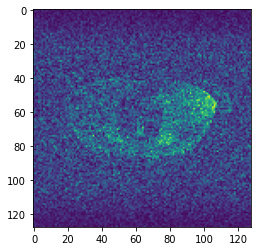

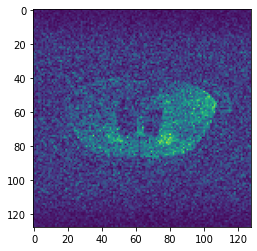

Time taken for epoch:  2.5465826988220215
[0]
Dev_Loss 0.002559014232404893 Epoch 82
Epoch = [  82/ 250] TrainLoss = 0.0008155  DevLoss = 0.002559 TrainTime = 1.5267s DevTime = 0.6822s


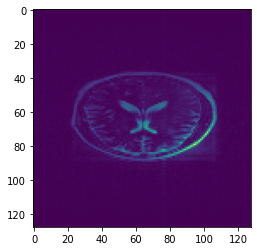

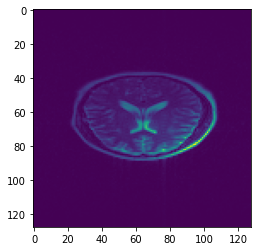

Time taken for epoch:  2.4903576374053955
[0]
Dev_Loss 0.0019592591486358095 Epoch 83
Epoch = [  83/ 250] TrainLoss = 0.0006776  DevLoss = 0.001959 TrainTime = 2.3077s DevTime = 0.7043s


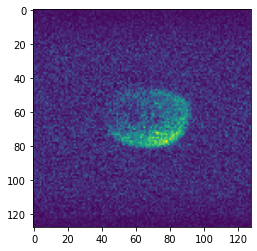

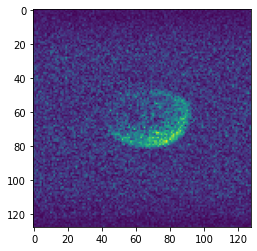

Time taken for epoch:  3.303666830062866
[0]
Dev_Loss 0.0005931508679021515 Epoch 84
Epoch = [  84/ 250] TrainLoss = 0.0006963  DevLoss = 0.0005932 TrainTime = 1.5197s DevTime = 0.6709s


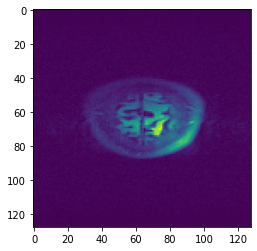

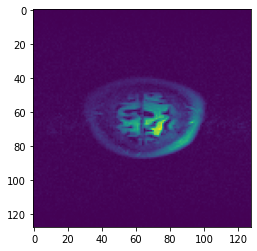

Time taken for epoch:  2.4689180850982666
[0]
Dev_Loss 0.014465731847278685 Epoch 85
Epoch = [  85/ 250] TrainLoss = 0.0008623  DevLoss = 0.01447 TrainTime = 1.5199s DevTime = 0.7068s


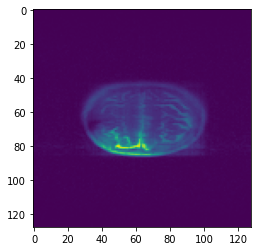

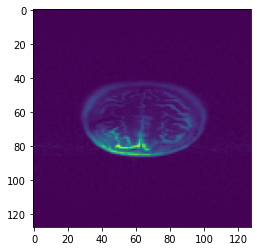

Time taken for epoch:  2.488248109817505
[0]
Dev_Loss 0.00011346699104571613 Epoch 86
Epoch = [  86/ 250] TrainLoss = 0.001276  DevLoss = 0.0001135 TrainTime = 1.5785s DevTime = 0.7780s


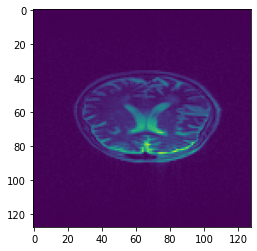

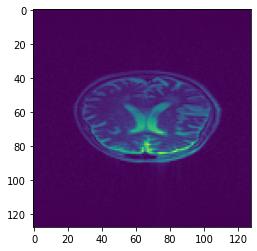

Time taken for epoch:  2.618830442428589
[0]
Dev_Loss 0.0006107048227805802 Epoch 87
Epoch = [  87/ 250] TrainLoss = 0.0005775  DevLoss = 0.0006107 TrainTime = 1.5799s DevTime = 0.7025s


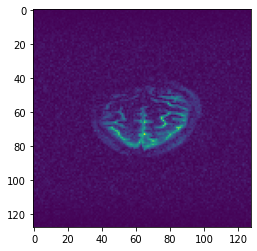

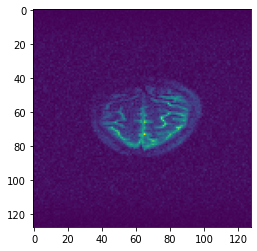

Time taken for epoch:  2.559744119644165
[0]
Dev_Loss 0.00022200446309517872 Epoch 88
Epoch = [  88/ 250] TrainLoss = 0.0008801  DevLoss = 0.000222 TrainTime = 1.5139s DevTime = 0.7124s


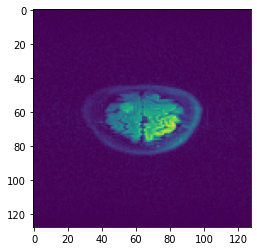

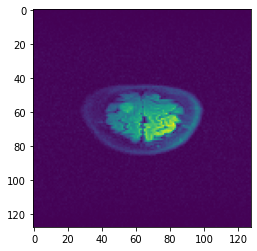

Time taken for epoch:  2.6063406467437744
[0]
Dev_Loss 0.003923415834968728 Epoch 89
Epoch = [  89/ 250] TrainLoss = 0.0006937  DevLoss = 0.003923 TrainTime = 1.5150s DevTime = 0.6999s


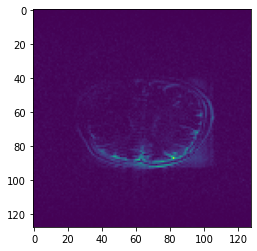

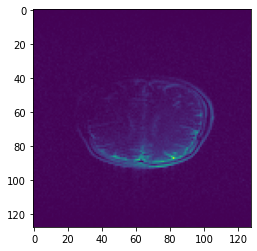

Time taken for epoch:  2.5001444816589355
[0]
Dev_Loss 0.0002940767485069249 Epoch 90
Epoch = [  90/ 250] TrainLoss = 0.0006392  DevLoss = 0.0002941 TrainTime = 1.5219s DevTime = 0.6714s


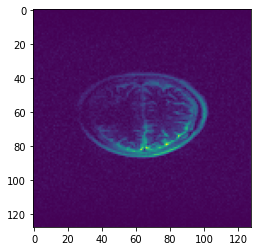

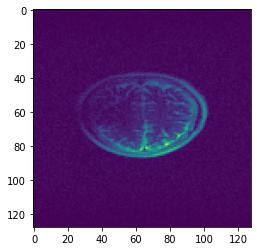

Time taken for epoch:  2.4793198108673096
[0]
Dev_Loss 0.00040875476660001583 Epoch 91
Epoch = [  91/ 250] TrainLoss = 0.000664  DevLoss = 0.0004088 TrainTime = 1.5312s DevTime = 0.7574s


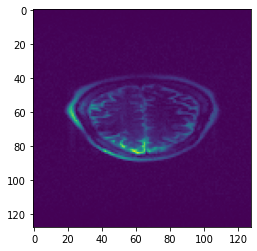

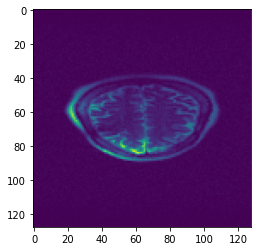

Time taken for epoch:  2.561011552810669
[0]
Dev_Loss 0.00043474431184597253 Epoch 92
Epoch = [  92/ 250] TrainLoss = 0.0008759  DevLoss = 0.0004347 TrainTime = 1.6608s DevTime = 0.7906s


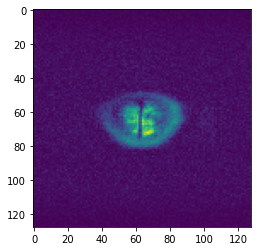

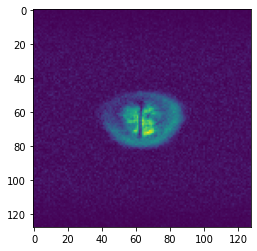

Time taken for epoch:  2.728721857070923
[0]
Dev_Loss 0.006005424226593494 Epoch 93
Epoch = [  93/ 250] TrainLoss = 0.0006332  DevLoss = 0.006005 TrainTime = 1.5196s DevTime = 0.6717s


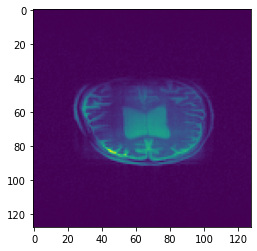

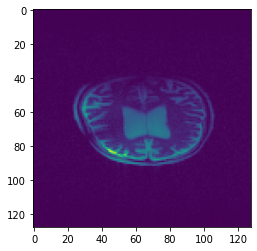

Time taken for epoch:  2.4521126747131348
[0]
Dev_Loss 3.913129363245257e-05 Epoch 94
Epoch = [  94/ 250] TrainLoss = 0.0007341  DevLoss = 3.913e-05 TrainTime = 1.8177s DevTime = 0.6782s


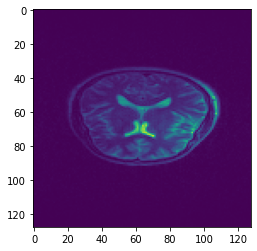

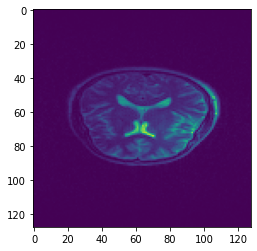

Time taken for epoch:  2.7578606605529785
[0]
Dev_Loss 0.00030093317401868236 Epoch 95
Epoch = [  95/ 250] TrainLoss = 0.0006938  DevLoss = 0.0003009 TrainTime = 1.5194s DevTime = 0.7071s


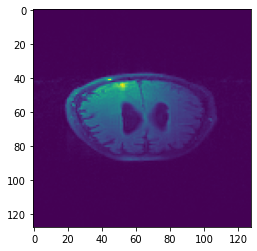

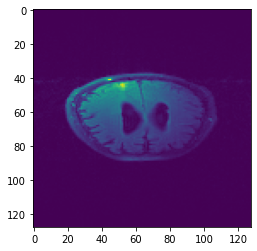

Time taken for epoch:  2.4786651134490967
[0]
Dev_Loss 5.45401700809536e-05 Epoch 96
Epoch = [  96/ 250] TrainLoss = 0.00073  DevLoss = 5.454e-05 TrainTime = 1.5280s DevTime = 0.6719s


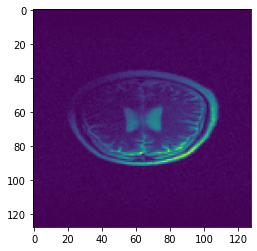

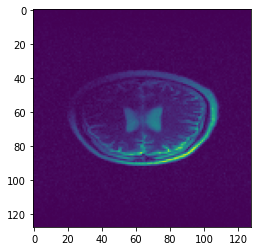

Time taken for epoch:  2.4703638553619385
[0]
Dev_Loss 0.0006713728429647556 Epoch 97
Epoch = [  97/ 250] TrainLoss = 0.0005892  DevLoss = 0.0006714 TrainTime = 1.5277s DevTime = 0.7060s


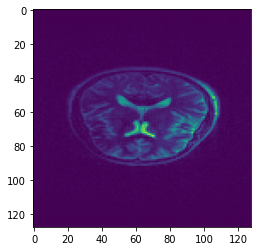

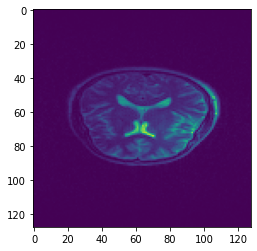

Time taken for epoch:  2.4932644367218018
[0]
Dev_Loss 0.00020732532919343413 Epoch 98
Epoch = [  98/ 250] TrainLoss = 0.0008053  DevLoss = 0.0002073 TrainTime = 1.5984s DevTime = 0.6830s


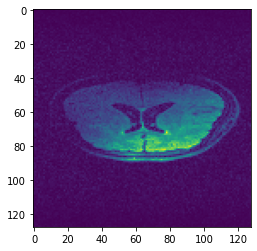

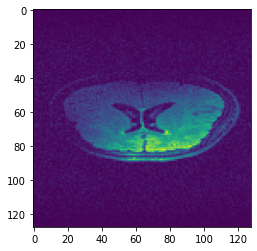

Time taken for epoch:  2.6687166690826416
[0]
Dev_Loss 0.0007640217126583134 Epoch 99
Epoch = [  99/ 250] TrainLoss = 0.0006753  DevLoss = 0.000764 TrainTime = 1.6045s DevTime = 0.7550s


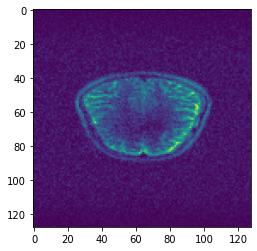

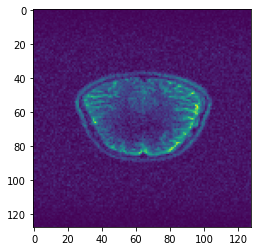

Time taken for epoch:  2.6518352031707764
[0]
Dev_Loss 4.526290730368869e-06 Epoch 100
Epoch = [ 100/ 250] TrainLoss = 1.359e-05  DevLoss = 4.526e-06 TrainTime = 1.5185s DevTime = 0.7186s


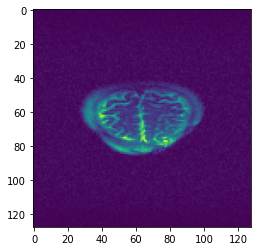

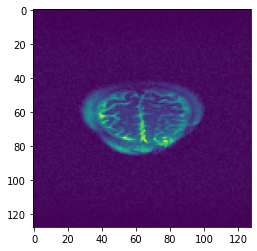

Time taken for epoch:  2.5289978981018066
[0]
Dev_Loss 1.841647333689226e-06 Epoch 101
Epoch = [ 101/ 250] TrainLoss = 2.625e-06  DevLoss = 1.842e-06 TrainTime = 1.5226s DevTime = 0.8140s


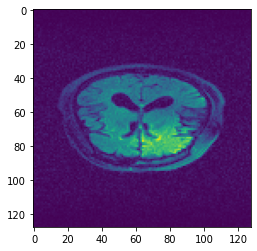

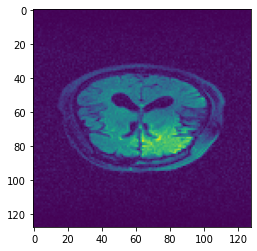

Time taken for epoch:  2.6367697715759277
[0]
Dev_Loss 9.583809998060664e-07 Epoch 102
Epoch = [ 102/ 250] TrainLoss = 1.267e-06  DevLoss = 9.584e-07 TrainTime = 2.0844s DevTime = 1.1580s


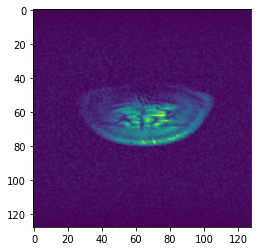

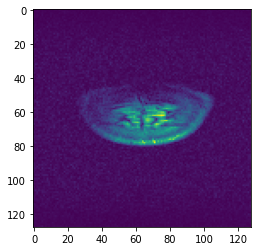

Time taken for epoch:  3.54984712600708
[0]
Dev_Loss 5.273438642966361e-07 Epoch 103
Epoch = [ 103/ 250] TrainLoss = 7.77e-07  DevLoss = 5.273e-07 TrainTime = 1.5516s DevTime = 0.7055s


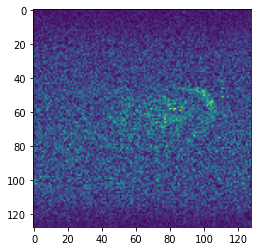

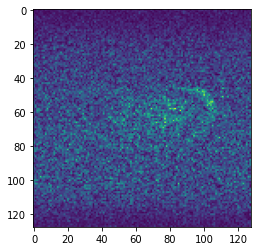

Time taken for epoch:  2.552001714706421
[0]
Dev_Loss 3.1347181700196394e-07 Epoch 104
Epoch = [ 104/ 250] TrainLoss = 4.735e-07  DevLoss = 3.135e-07 TrainTime = 1.5352s DevTime = 0.6708s


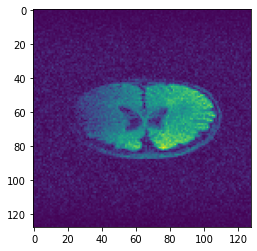

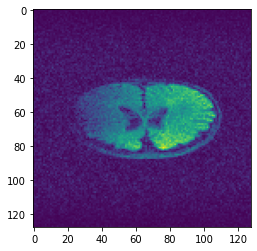

Time taken for epoch:  2.619091510772705
[0]
Dev_Loss 1.9553677933583089e-07 Epoch 105
Epoch = [ 105/ 250] TrainLoss = 3.544e-07  DevLoss = 1.955e-07 TrainTime = 1.7797s DevTime = 0.6709s


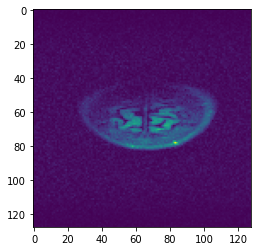

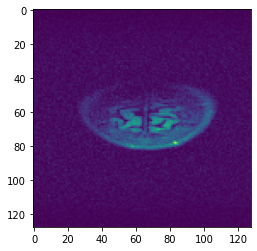

Time taken for epoch:  2.730560541152954
[0]
Dev_Loss 1.2885083976584113e-07 Epoch 106
Epoch = [ 106/ 250] TrainLoss = 2.227e-07  DevLoss = 1.289e-07 TrainTime = 2.8247s DevTime = 0.8024s


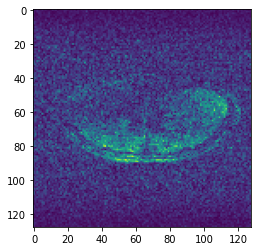

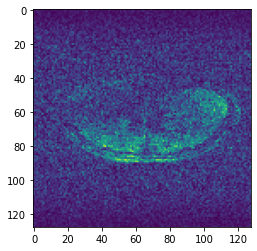

Time taken for epoch:  3.9243955612182617
[0]
Dev_Loss 8.43367090733511e-08 Epoch 107
Epoch = [ 107/ 250] TrainLoss = 1.648e-07  DevLoss = 8.434e-08 TrainTime = 1.6023s DevTime = 0.6926s


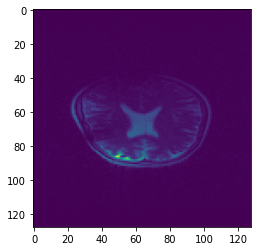

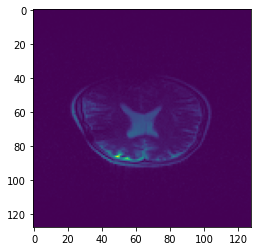

Time taken for epoch:  2.6812262535095215
[0]
Dev_Loss 5.867004952970885e-08 Epoch 108
Epoch = [ 108/ 250] TrainLoss = 1.23e-07  DevLoss = 5.867e-08 TrainTime = 1.5046s DevTime = 0.6917s


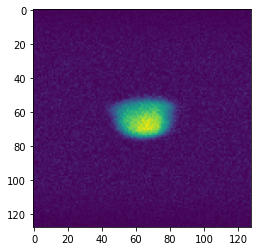

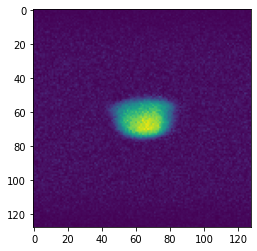

Time taken for epoch:  2.4961674213409424
[0]
Dev_Loss 3.929069410645373e-08 Epoch 109
Epoch = [ 109/ 250] TrainLoss = 9.632e-08  DevLoss = 3.929e-08 TrainTime = 1.7279s DevTime = 0.7102s


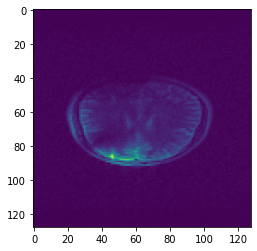

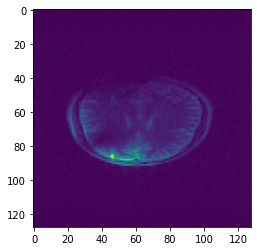

Time taken for epoch:  2.7099390029907227
[0]
Dev_Loss 2.7796839757729743e-08 Epoch 110
Epoch = [ 110/ 250] TrainLoss = 8.018e-08  DevLoss = 2.78e-08 TrainTime = 1.5332s DevTime = 0.6760s


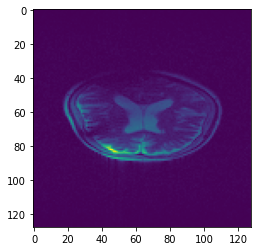

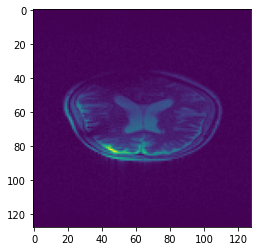

Time taken for epoch:  2.4827258586883545
[0]
Dev_Loss 2.138235914806506e-08 Epoch 111
Epoch = [ 111/ 250] TrainLoss = 6.173e-08  DevLoss = 2.138e-08 TrainTime = 1.5647s DevTime = 0.6989s


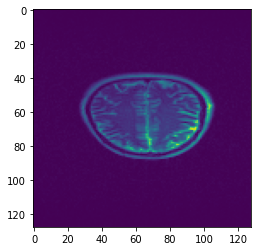

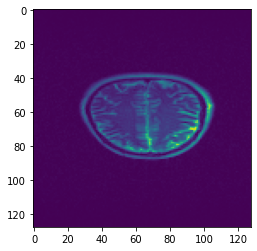

Time taken for epoch:  2.53527569770813
[0]
Dev_Loss 1.6223362712816916e-08 Epoch 112
Epoch = [ 112/ 250] TrainLoss = 5.102e-08  DevLoss = 1.622e-08 TrainTime = 1.6442s DevTime = 0.7396s


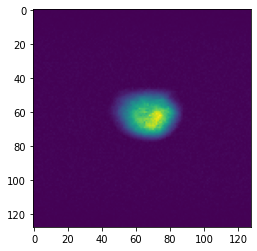

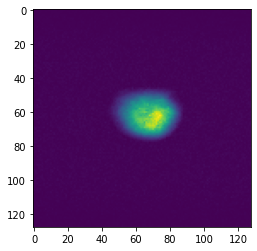

Time taken for epoch:  2.648116111755371
[0]
Dev_Loss 1.3208148532393456e-08 Epoch 113
Epoch = [ 113/ 250] TrainLoss = 4.619e-08  DevLoss = 1.321e-08 TrainTime = 1.5977s DevTime = 0.7291s


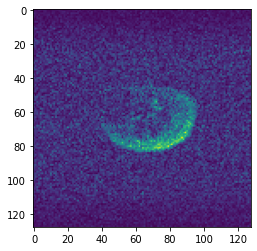

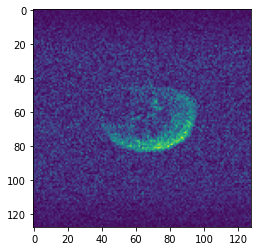

Time taken for epoch:  2.6207244396209717
[0]
Dev_Loss 1.0485547783077218e-08 Epoch 114
Epoch = [ 114/ 250] TrainLoss = 3.584e-08  DevLoss = 1.049e-08 TrainTime = 1.5580s DevTime = 0.6904s


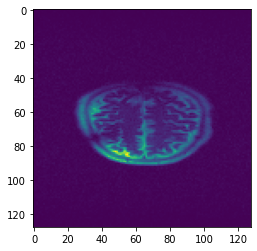

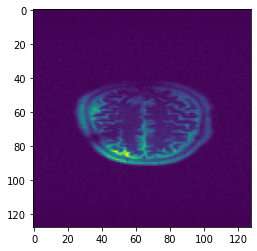

Time taken for epoch:  2.531313180923462
[0]
Dev_Loss 8.686728799619761e-09 Epoch 115
Epoch = [ 115/ 250] TrainLoss = 3.402e-08  DevLoss = 8.687e-09 TrainTime = 1.5239s DevTime = 0.7098s


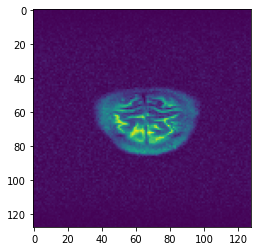

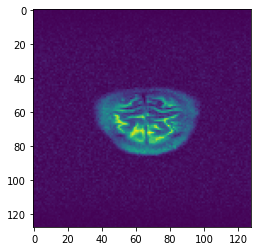

Time taken for epoch:  2.521179437637329
[0]
Dev_Loss 7.401387746738391e-09 Epoch 116
Epoch = [ 116/ 250] TrainLoss = 2.579e-08  DevLoss = 7.401e-09 TrainTime = 1.5309s DevTime = 0.6765s


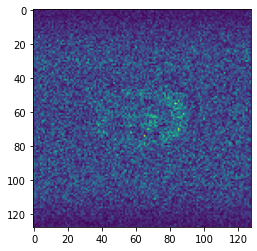

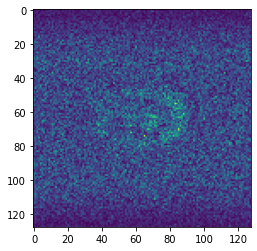

Time taken for epoch:  2.493377208709717
[0]
Dev_Loss 6.4752076055646426e-09 Epoch 117
Epoch = [ 117/ 250] TrainLoss = 2.267e-08  DevLoss = 6.475e-09 TrainTime = 1.5293s DevTime = 0.7106s


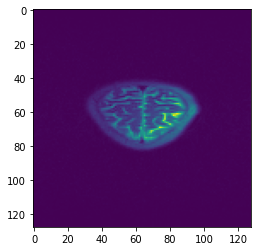

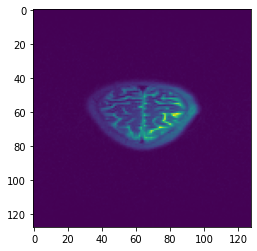

Time taken for epoch:  2.604551076889038
[0]
Dev_Loss 5.6311926204726386e-09 Epoch 118
Epoch = [ 118/ 250] TrainLoss = 2.093e-08  DevLoss = 5.631e-09 TrainTime = 1.6665s DevTime = 0.7413s


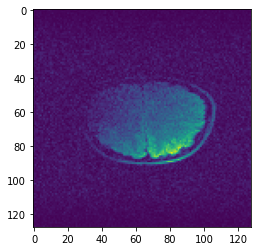

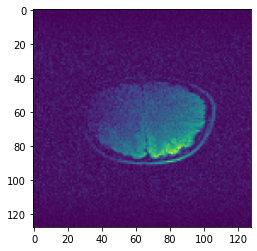

Time taken for epoch:  2.693408727645874
[0]
Dev_Loss 4.959062188059539e-09 Epoch 119
Epoch = [ 119/ 250] TrainLoss = 1.882e-08  DevLoss = 4.959e-09 TrainTime = 1.5397s DevTime = 0.6721s


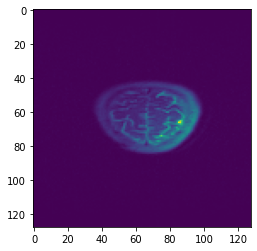

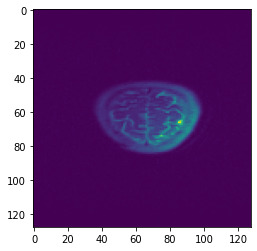

Time taken for epoch:  2.474797010421753
[0]
Dev_Loss 4.5121067420632205e-09 Epoch 120
Epoch = [ 120/ 250] TrainLoss = 1.772e-08  DevLoss = 4.512e-09 TrainTime = 1.5408s DevTime = 0.7478s


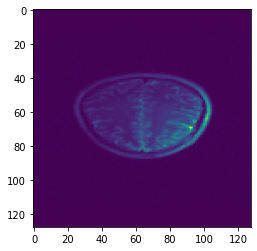

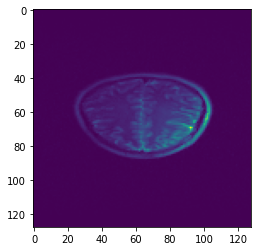

Time taken for epoch:  2.5551130771636963
[0]
Dev_Loss 4.079822671627457e-09 Epoch 121
Epoch = [ 121/ 250] TrainLoss = 1.539e-08  DevLoss = 4.08e-09 TrainTime = 1.5230s DevTime = 0.7207s


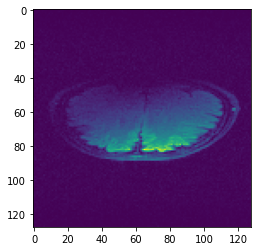

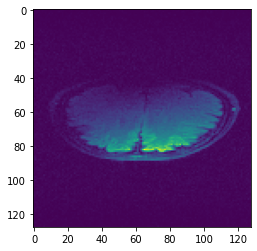

Time taken for epoch:  2.533261775970459
[0]
Dev_Loss 3.7158590295205016e-09 Epoch 122
Epoch = [ 122/ 250] TrainLoss = 1.352e-08  DevLoss = 3.716e-09 TrainTime = 1.5443s DevTime = 0.6842s


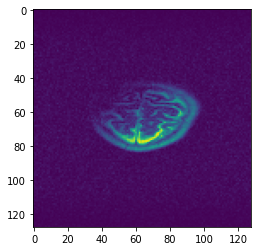

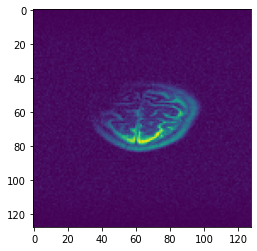

Time taken for epoch:  2.518956184387207
[0]
Dev_Loss 3.370957724602227e-09 Epoch 123
Epoch = [ 123/ 250] TrainLoss = 1.294e-08  DevLoss = 3.371e-09 TrainTime = 2.0364s DevTime = 0.6907s


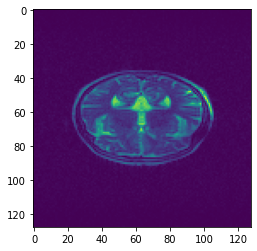

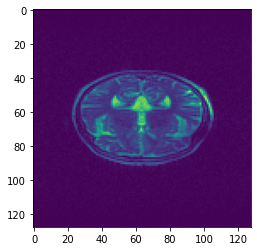

Time taken for epoch:  3.00472092628479
[0]
Dev_Loss 3.129374107976196e-09 Epoch 124
Epoch = [ 124/ 250] TrainLoss = 1.212e-08  DevLoss = 3.129e-09 TrainTime = 1.5306s DevTime = 0.7621s


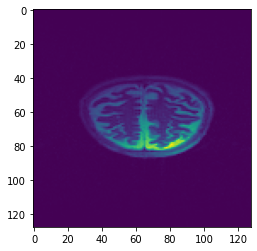

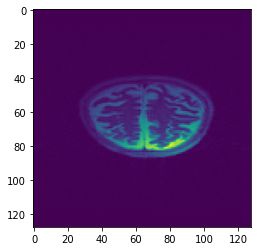

Time taken for epoch:  2.547881841659546
[0]
Dev_Loss 2.869996956746313e-09 Epoch 125
Epoch = [ 125/ 250] TrainLoss = 1.131e-08  DevLoss = 2.87e-09 TrainTime = 1.5325s DevTime = 0.7163s


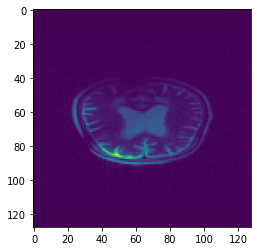

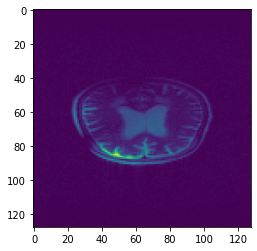

Time taken for epoch:  2.517728328704834
[0]
Dev_Loss 2.6536561065683254e-09 Epoch 126
Epoch = [ 126/ 250] TrainLoss = 9.607e-09  DevLoss = 2.654e-09 TrainTime = 1.5461s DevTime = 0.6842s


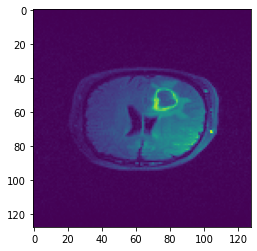

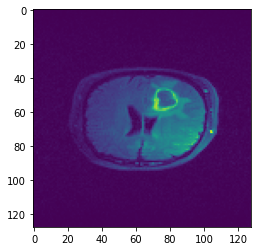

Time taken for epoch:  2.612870693206787
[0]
Dev_Loss 2.479507926602528e-09 Epoch 127
Epoch = [ 127/ 250] TrainLoss = 1.028e-08  DevLoss = 2.48e-09 TrainTime = 1.5322s DevTime = 0.7170s


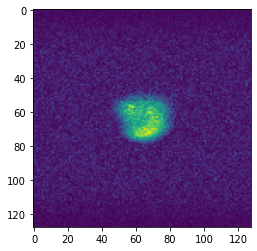

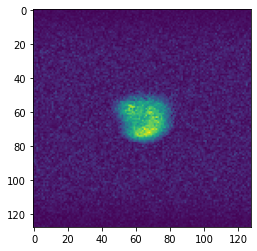

Time taken for epoch:  2.5418577194213867
[0]
Dev_Loss 2.356597864874527e-09 Epoch 128
Epoch = [ 128/ 250] TrainLoss = 9.856e-09  DevLoss = 2.357e-09 TrainTime = 1.6501s DevTime = 1.0085s


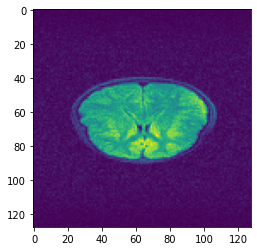

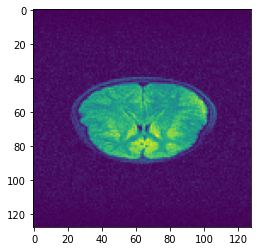

Time taken for epoch:  2.955162763595581
[0]
Dev_Loss 2.1906159705385406e-09 Epoch 129
Epoch = [ 129/ 250] TrainLoss = 8.843e-09  DevLoss = 2.191e-09 TrainTime = 1.8930s DevTime = 0.7193s


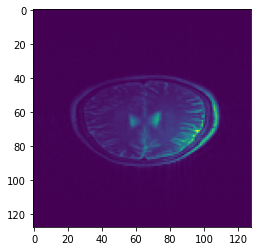

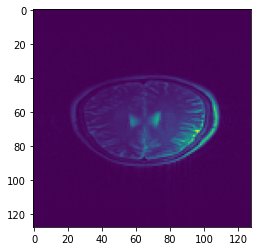

Time taken for epoch:  2.87507700920105
[0]
Dev_Loss 1.9744180941834716e-09 Epoch 130
Epoch = [ 130/ 250] TrainLoss = 7.69e-09  DevLoss = 1.974e-09 TrainTime = 1.5246s DevTime = 0.6775s


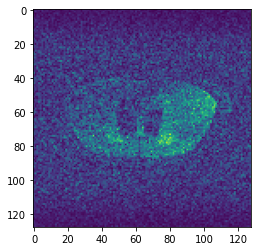

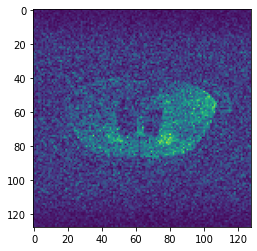

Time taken for epoch:  2.4995877742767334
[0]
Dev_Loss 1.8408462260737997e-09 Epoch 131
Epoch = [ 131/ 250] TrainLoss = 6.738e-09  DevLoss = 1.841e-09 TrainTime = 1.5236s DevTime = 1.3874s


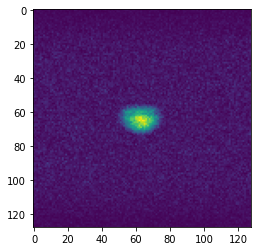

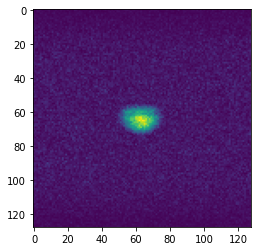

Time taken for epoch:  3.21388578414917
[0]
Dev_Loss 1.7619385794592219e-09 Epoch 132
Epoch = [ 132/ 250] TrainLoss = 7.557e-09  DevLoss = 1.762e-09 TrainTime = 1.5527s DevTime = 0.6927s


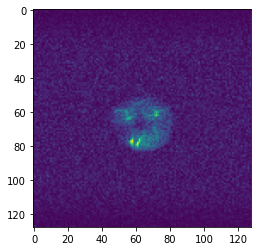

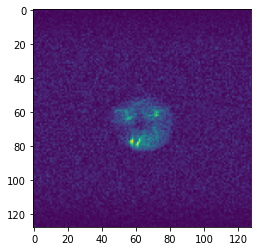

Time taken for epoch:  2.5406363010406494
[0]
Dev_Loss 1.614491094891416e-09 Epoch 133
Epoch = [ 133/ 250] TrainLoss = 7.422e-09  DevLoss = 1.614e-09 TrainTime = 1.6016s DevTime = 0.8111s


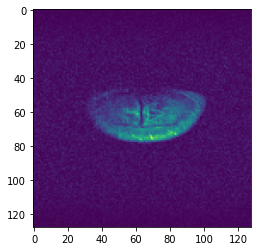

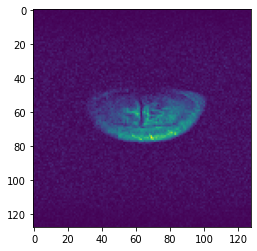

Time taken for epoch:  2.706490993499756
[0]
Dev_Loss 1.5064180139241956e-09 Epoch 134
Epoch = [ 134/ 250] TrainLoss = 6.378e-09  DevLoss = 1.506e-09 TrainTime = 1.5885s DevTime = 0.6790s


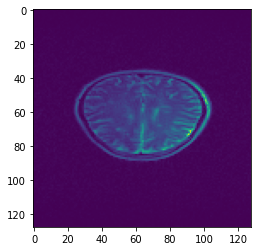

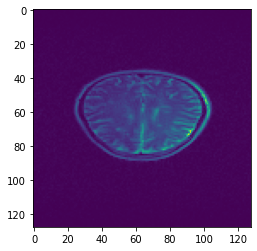

Time taken for epoch:  2.5443031787872314
[0]
Dev_Loss 1.4121859250766273e-09 Epoch 135
Epoch = [ 135/ 250] TrainLoss = 5.77e-09  DevLoss = 1.412e-09 TrainTime = 1.7167s DevTime = 0.6752s


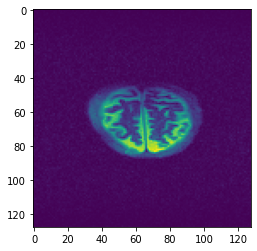

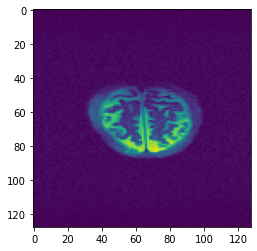

Time taken for epoch:  2.674492835998535
[0]
Dev_Loss 1.320705420559013e-09 Epoch 136
Epoch = [ 136/ 250] TrainLoss = 4.917e-09  DevLoss = 1.321e-09 TrainTime = 1.5461s DevTime = 0.7459s


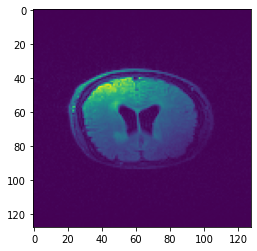

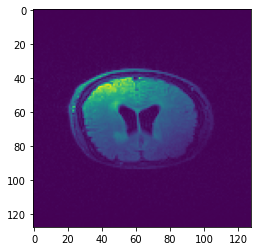

Time taken for epoch:  2.675910234451294
[0]
Dev_Loss 1.2458838317040075e-09 Epoch 137
Epoch = [ 137/ 250] TrainLoss = 4.766e-09  DevLoss = 1.246e-09 TrainTime = 1.5643s DevTime = 1.9300s


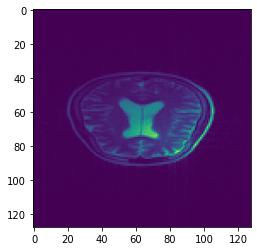

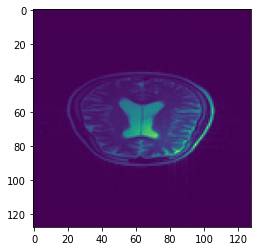

Time taken for epoch:  3.763309955596924
[0]
Dev_Loss 1.1654522755454378e-09 Epoch 138
Epoch = [ 138/ 250] TrainLoss = 4.957e-09  DevLoss = 1.165e-09 TrainTime = 1.6495s DevTime = 0.7805s


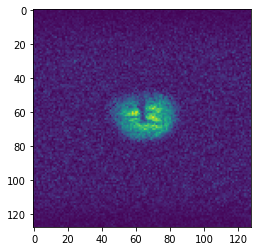

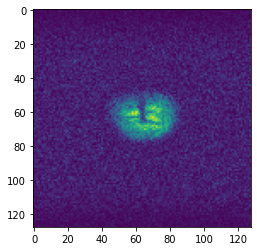

Time taken for epoch:  2.7323009967803955
[0]
Dev_Loss 1.0962577308813735e-09 Epoch 139
Epoch = [ 139/ 250] TrainLoss = 4.094e-09  DevLoss = 1.096e-09 TrainTime = 1.5513s DevTime = 0.7130s


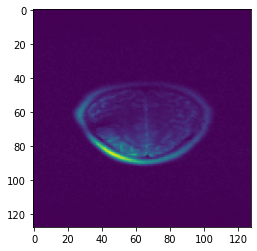

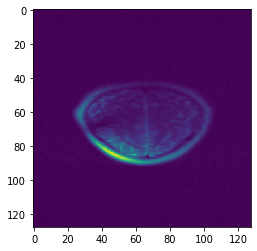

Time taken for epoch:  2.5398058891296387
[0]
Dev_Loss 1.0344548637864908e-09 Epoch 140
Epoch = [ 140/ 250] TrainLoss = 3.923e-09  DevLoss = 1.034e-09 TrainTime = 1.5262s DevTime = 0.6743s


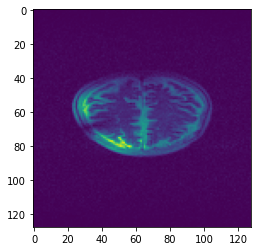

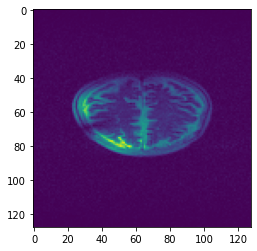

Time taken for epoch:  2.479860305786133
[0]
Dev_Loss 9.627591193171466e-10 Epoch 141
Epoch = [ 141/ 250] TrainLoss = 3.949e-09  DevLoss = 9.628e-10 TrainTime = 1.5887s DevTime = 0.6934s


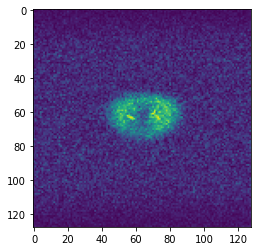

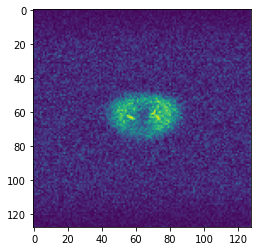

Time taken for epoch:  2.5707576274871826
[0]
Dev_Loss 9.256517638654936e-10 Epoch 142
Epoch = [ 142/ 250] TrainLoss = 3.567e-09  DevLoss = 9.257e-10 TrainTime = 1.7519s DevTime = 0.7892s


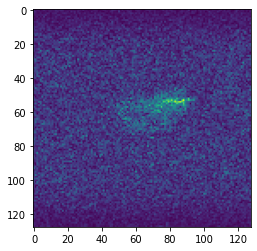

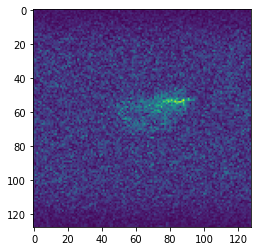

Time taken for epoch:  2.8220295906066895
[0]
Dev_Loss 8.46234749639513e-10 Epoch 143
Epoch = [ 143/ 250] TrainLoss = 3.398e-09  DevLoss = 8.462e-10 TrainTime = 1.5402s DevTime = 0.7104s


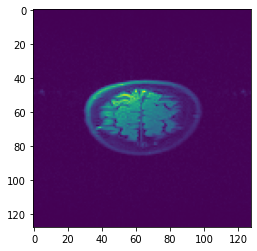

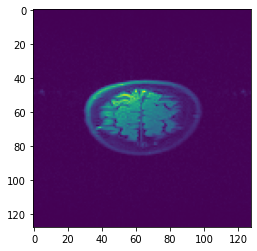

Time taken for epoch:  2.5305612087249756
[0]
Dev_Loss 7.902344716039674e-10 Epoch 144
Epoch = [ 144/ 250] TrainLoss = 3.115e-09  DevLoss = 7.902e-10 TrainTime = 1.5285s DevTime = 0.6708s


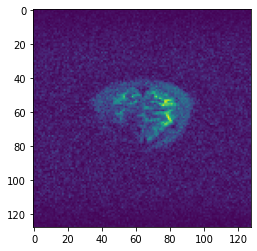

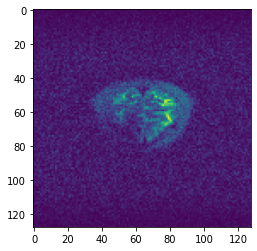

Time taken for epoch:  2.4915082454681396
[0]
Dev_Loss 7.407558473274682e-10 Epoch 145
Epoch = [ 145/ 250] TrainLoss = 2.825e-09  DevLoss = 7.408e-10 TrainTime = 1.5388s DevTime = 1.0159s


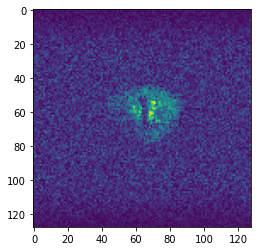

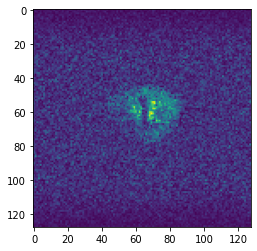

Time taken for epoch:  2.955143928527832
[0]
Dev_Loss 6.956665701343319e-10 Epoch 146
Epoch = [ 146/ 250] TrainLoss = 2.646e-09  DevLoss = 6.957e-10 TrainTime = 1.5396s DevTime = 0.9805s


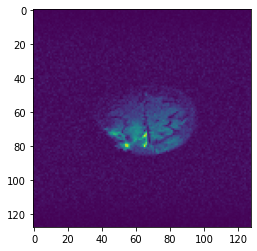

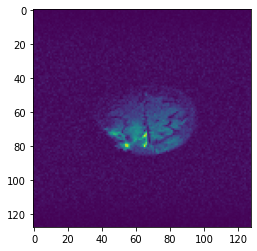

Time taken for epoch:  2.8181471824645996
[0]
Dev_Loss 6.563231578082175e-10 Epoch 147
Epoch = [ 147/ 250] TrainLoss = 2.531e-09  DevLoss = 6.563e-10 TrainTime = 1.5797s DevTime = 0.8933s


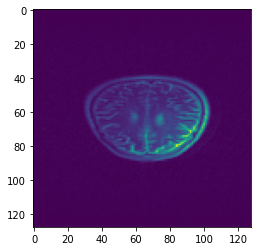

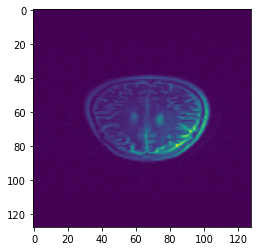

Time taken for epoch:  2.764094829559326
[0]
Dev_Loss 6.159413645106364e-10 Epoch 148
Epoch = [ 148/ 250] TrainLoss = 2.431e-09  DevLoss = 6.159e-10 TrainTime = 2.3339s DevTime = 0.7396s


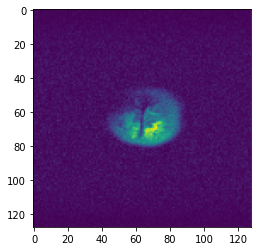

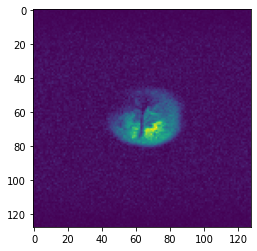

Time taken for epoch:  3.3592371940612793
[0]
Dev_Loss 5.834732945622302e-10 Epoch 149
Epoch = [ 149/ 250] TrainLoss = 2.297e-09  DevLoss = 5.835e-10 TrainTime = 1.8468s DevTime = 0.7101s


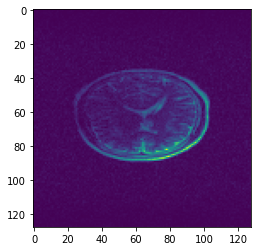

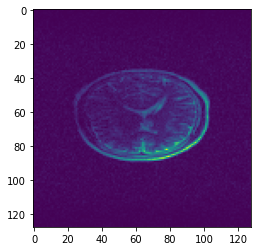

Time taken for epoch:  2.8518478870391846
[0]
Dev_Loss 5.695978916309834e-10 Epoch 150
Epoch = [ 150/ 250] TrainLoss = 2.396e-09  DevLoss = 5.696e-10 TrainTime = 1.5468s DevTime = 0.6853s


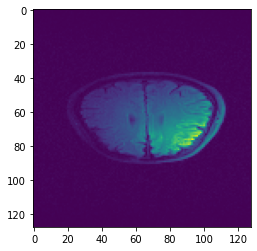

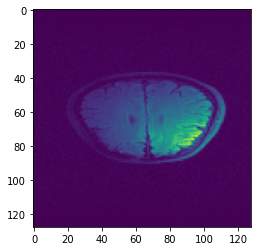

Time taken for epoch:  2.5218517780303955
[0]
Dev_Loss 5.1258061472803e-10 Epoch 151
Epoch = [ 151/ 250] TrainLoss = 2.136e-09  DevLoss = 5.126e-10 TrainTime = 1.5333s DevTime = 0.6790s


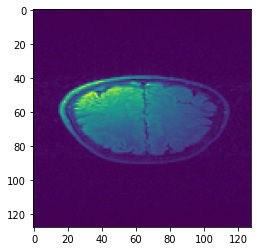

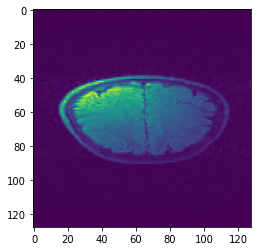

Time taken for epoch:  2.4876468181610107
[0]
Dev_Loss 4.93875148990724e-10 Epoch 152
Epoch = [ 152/ 250] TrainLoss = 2.101e-09  DevLoss = 4.939e-10 TrainTime = 1.5365s DevTime = 0.7173s


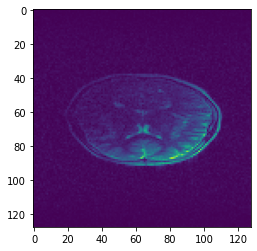

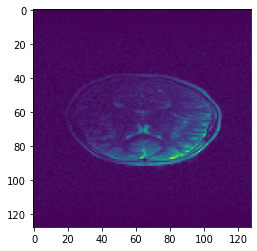

Time taken for epoch:  2.539602041244507
[0]
Dev_Loss 4.5269422984230007e-10 Epoch 153
Epoch = [ 153/ 250] TrainLoss = 1.906e-09  DevLoss = 4.527e-10 TrainTime = 1.5414s DevTime = 0.6784s


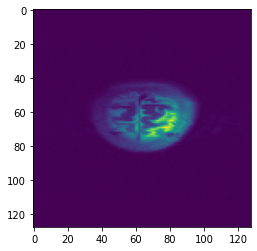

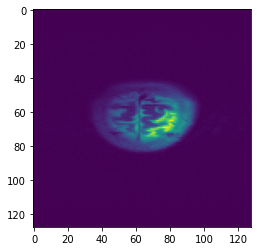

Time taken for epoch:  2.4835643768310547
[0]
Dev_Loss 4.269584589373009e-10 Epoch 154
Epoch = [ 154/ 250] TrainLoss = 1.754e-09  DevLoss = 4.27e-10 TrainTime = 1.5834s DevTime = 0.7280s


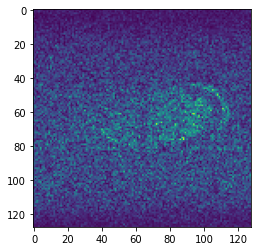

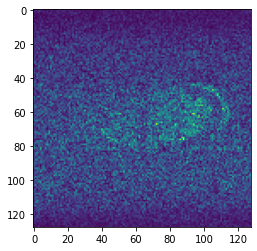

Time taken for epoch:  2.7483835220336914
[0]
Dev_Loss 4.0318864517534517e-10 Epoch 155
Epoch = [ 155/ 250] TrainLoss = 1.713e-09  DevLoss = 4.032e-10 TrainTime = 2.5044s DevTime = 0.7866s


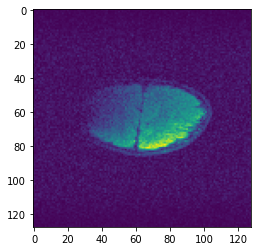

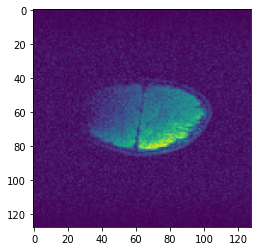

Time taken for epoch:  3.67984938621521
[0]
Dev_Loss 3.826273208426853e-10 Epoch 156
Epoch = [ 156/ 250] TrainLoss = 1.474e-09  DevLoss = 3.826e-10 TrainTime = 1.5775s DevTime = 0.6971s


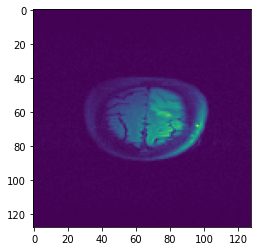

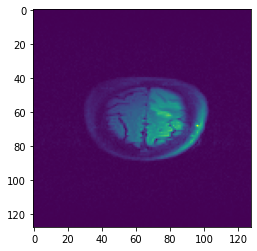

Time taken for epoch:  2.551858425140381
[0]
Dev_Loss 3.5992834421676784e-10 Epoch 157
Epoch = [ 157/ 250] TrainLoss = 1.445e-09  DevLoss = 3.599e-10 TrainTime = 1.5723s DevTime = 0.7115s


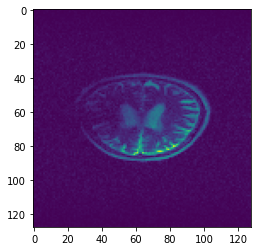

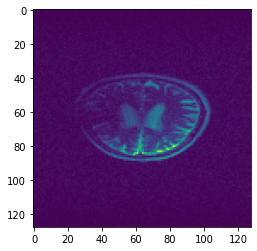

Time taken for epoch:  2.569091796875
[0]
Dev_Loss 3.4850887516852654e-10 Epoch 158
Epoch = [ 158/ 250] TrainLoss = 1.496e-09  DevLoss = 3.485e-10 TrainTime = 1.5809s DevTime = 0.6839s


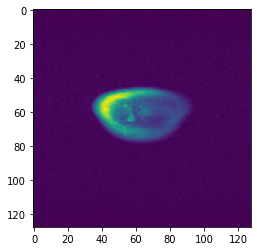

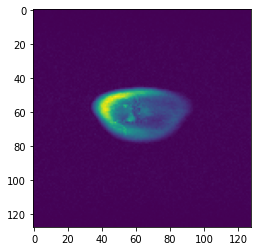

Time taken for epoch:  2.5424294471740723
[0]
Dev_Loss 3.1538882218580295e-10 Epoch 159
Epoch = [ 159/ 250] TrainLoss = 1.36e-09  DevLoss = 3.154e-10 TrainTime = 1.5393s DevTime = 0.6817s


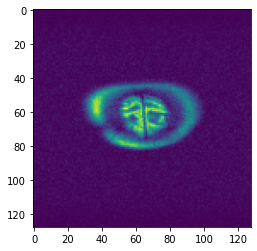

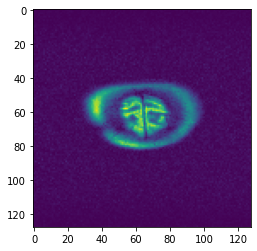

Time taken for epoch:  2.513047456741333
[0]
Dev_Loss 2.976942839992188e-10 Epoch 160
Epoch = [ 160/ 250] TrainLoss = 1.206e-09  DevLoss = 2.977e-10 TrainTime = 1.5395s DevTime = 0.7145s


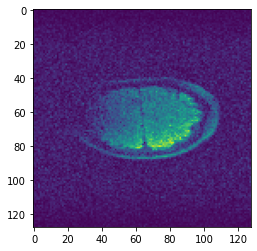

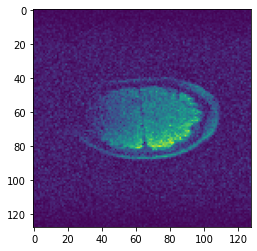

Time taken for epoch:  2.55133056640625
[0]
Dev_Loss 2.831875483260079e-10 Epoch 161
Epoch = [ 161/ 250] TrainLoss = 1.165e-09  DevLoss = 2.832e-10 TrainTime = 1.5366s DevTime = 0.6836s


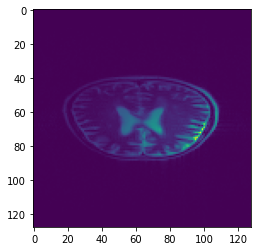

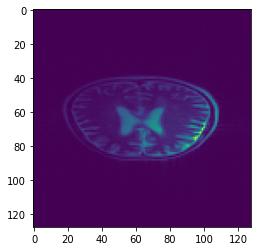

Time taken for epoch:  2.4732890129089355
[0]
Dev_Loss 2.691608146641984e-10 Epoch 162
Epoch = [ 162/ 250] TrainLoss = 9.704e-10  DevLoss = 2.692e-10 TrainTime = 1.5477s DevTime = 0.7412s


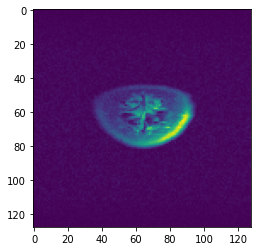

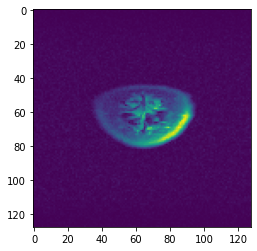

Time taken for epoch:  2.5643293857574463
[0]
Dev_Loss 2.5095963872016365e-10 Epoch 163
Epoch = [ 163/ 250] TrainLoss = 9.95e-10  DevLoss = 2.51e-10 TrainTime = 1.6546s DevTime = 0.7951s


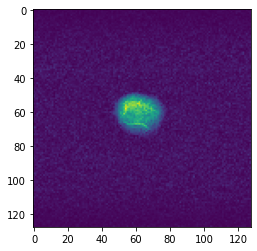

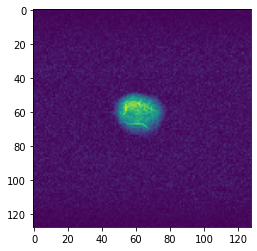

Time taken for epoch:  2.734105348587036
[0]
Dev_Loss 2.413528247311825e-10 Epoch 164
Epoch = [ 164/ 250] TrainLoss = 9.407e-10  DevLoss = 2.414e-10 TrainTime = 1.5451s DevTime = 0.6864s


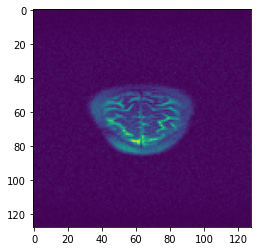

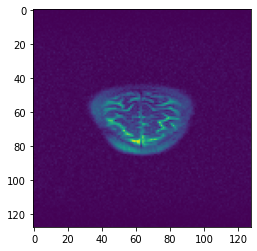

Time taken for epoch:  2.686660051345825
[0]
Dev_Loss 2.2138938412363716e-10 Epoch 165
Epoch = [ 165/ 250] TrainLoss = 8.854e-10  DevLoss = 2.214e-10 TrainTime = 1.5355s DevTime = 0.6899s


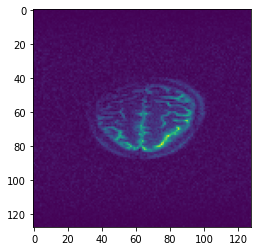

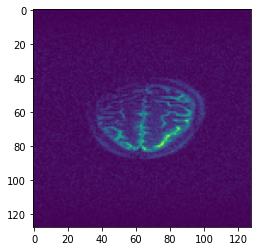

Time taken for epoch:  2.5165135860443115
[0]
Dev_Loss 2.0823094953811908e-10 Epoch 166
Epoch = [ 166/ 250] TrainLoss = 8.412e-10  DevLoss = 2.082e-10 TrainTime = 1.5340s DevTime = 0.7158s


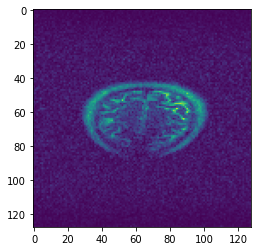

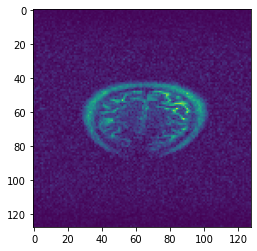

Time taken for epoch:  2.547894239425659
[0]
Dev_Loss 2.044635951101192e-10 Epoch 167
Epoch = [ 167/ 250] TrainLoss = 7.657e-10  DevLoss = 2.045e-10 TrainTime = 1.5522s DevTime = 0.6863s


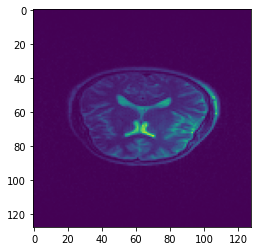

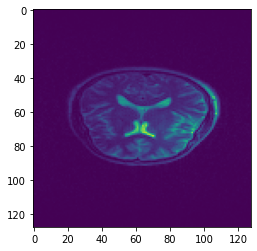

Time taken for epoch:  2.5117764472961426
[0]
Dev_Loss 1.8630178684687354e-10 Epoch 168
Epoch = [ 168/ 250] TrainLoss = 7.358e-10  DevLoss = 1.863e-10 TrainTime = 1.5711s DevTime = 0.6785s


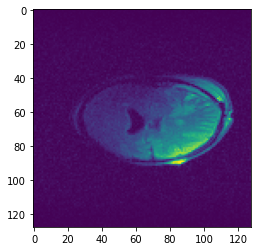

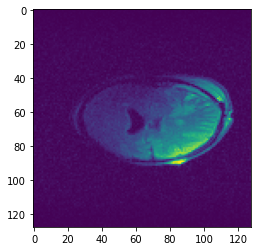

Time taken for epoch:  2.537090539932251
[0]
Dev_Loss 1.7596390197547794e-10 Epoch 169
Epoch = [ 169/ 250] TrainLoss = 7.809e-10  DevLoss = 1.76e-10 TrainTime = 1.5971s DevTime = 0.8162s


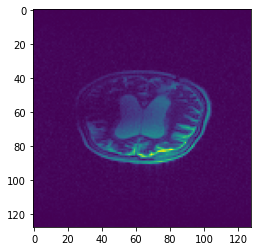

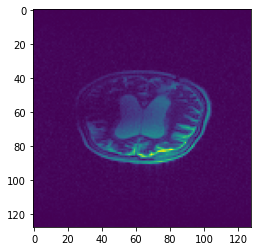

Time taken for epoch:  2.6968905925750732
[0]
Dev_Loss 1.7181747591413477e-10 Epoch 170
Epoch = [ 170/ 250] TrainLoss = 6.397e-10  DevLoss = 1.718e-10 TrainTime = 1.5610s DevTime = 0.6724s


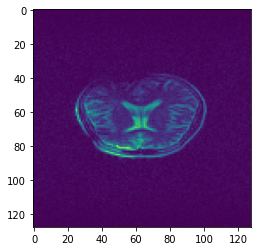

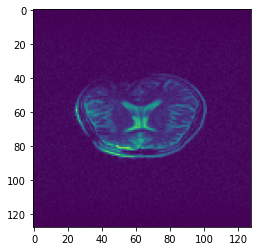

Time taken for epoch:  2.532104253768921
[0]
Dev_Loss 1.567442056710439e-10 Epoch 171
Epoch = [ 171/ 250] TrainLoss = 6.569e-10  DevLoss = 1.567e-10 TrainTime = 1.5519s DevTime = 0.6758s


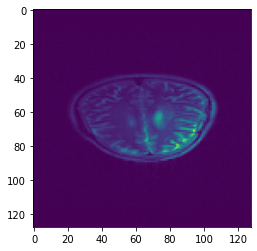

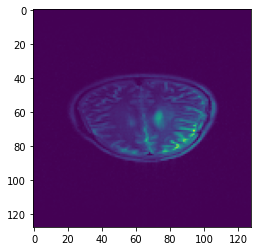

Time taken for epoch:  2.495184898376465
[0]
Dev_Loss 1.484348112978017e-10 Epoch 172
Epoch = [ 172/ 250] TrainLoss = 5.526e-10  DevLoss = 1.484e-10 TrainTime = 1.5313s DevTime = 0.7190s


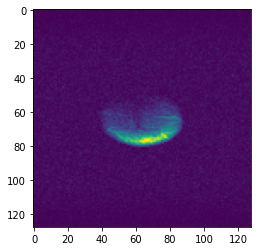

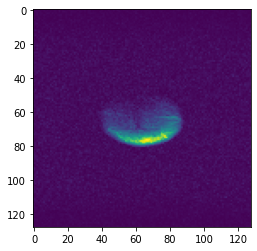

Time taken for epoch:  2.537075996398926
[0]
Dev_Loss 1.418252709479342e-10 Epoch 173
Epoch = [ 173/ 250] TrainLoss = 6.308e-10  DevLoss = 1.418e-10 TrainTime = 1.7167s DevTime = 0.6960s


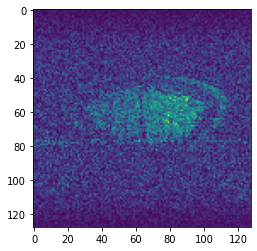

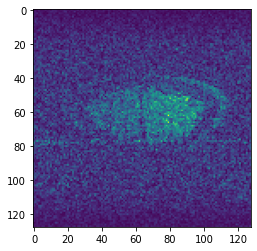

Time taken for epoch:  2.69974946975708
[0]
Dev_Loss 1.3115161222652194e-10 Epoch 174
Epoch = [ 174/ 250] TrainLoss = 4.971e-10  DevLoss = 1.312e-10 TrainTime = 1.5854s DevTime = 0.6857s


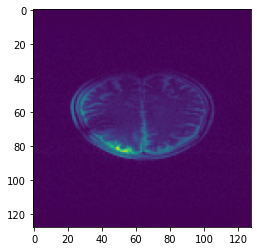

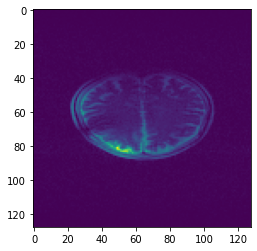

Time taken for epoch:  2.6340270042419434
[0]
Dev_Loss 1.245865750453196e-10 Epoch 175
Epoch = [ 175/ 250] TrainLoss = 5.505e-10  DevLoss = 1.246e-10 TrainTime = 1.6002s DevTime = 0.7222s


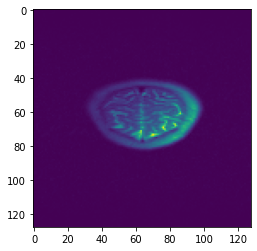

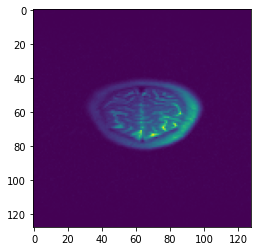

Time taken for epoch:  2.579857587814331
[0]
Dev_Loss 1.1701053852917745e-10 Epoch 176
Epoch = [ 176/ 250] TrainLoss = 4.483e-10  DevLoss = 1.17e-10 TrainTime = 1.6073s DevTime = 0.7460s


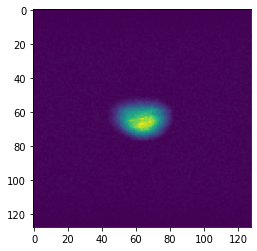

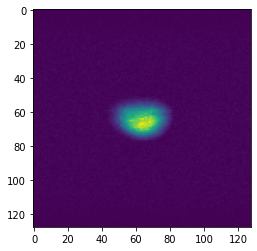

Time taken for epoch:  2.6206438541412354
[0]
Dev_Loss 1.1081554714694739e-10 Epoch 177
Epoch = [ 177/ 250] TrainLoss = 4.552e-10  DevLoss = 1.108e-10 TrainTime = 1.6256s DevTime = 0.7650s


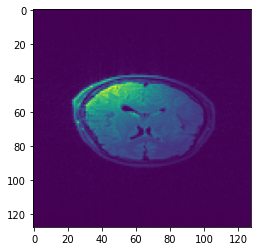

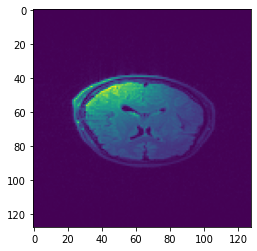

Time taken for epoch:  2.6543471813201904
[0]
Dev_Loss 1.0451138806072353e-10 Epoch 178
Epoch = [ 178/ 250] TrainLoss = 4.353e-10  DevLoss = 1.045e-10 TrainTime = 1.5565s DevTime = 0.7190s


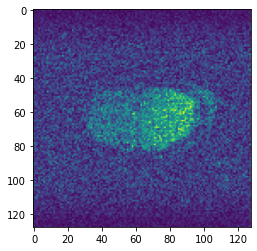

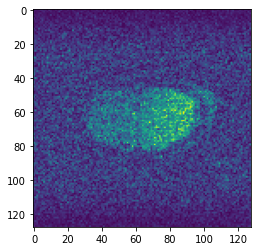

Time taken for epoch:  2.5556602478027344
[0]
Dev_Loss 1.0080115284691102e-10 Epoch 179
Epoch = [ 179/ 250] TrainLoss = 3.958e-10  DevLoss = 1.008e-10 TrainTime = 1.5510s DevTime = 1.6120s


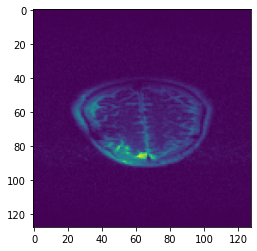

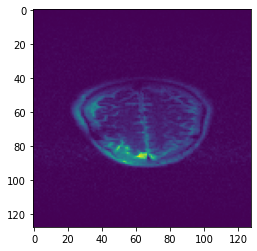

Time taken for epoch:  3.444774866104126
[0]
Dev_Loss 9.522355353056898e-11 Epoch 180
Epoch = [ 180/ 250] TrainLoss = 3.563e-10  DevLoss = 9.522e-11 TrainTime = 1.7699s DevTime = 0.6712s


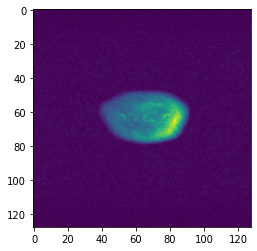

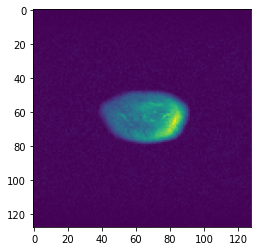

Time taken for epoch:  2.7209270000457764
[0]
Dev_Loss 8.825033740020426e-11 Epoch 181
Epoch = [ 181/ 250] TrainLoss = 3.581e-10  DevLoss = 8.825e-11 TrainTime = 1.5456s DevTime = 0.9632s


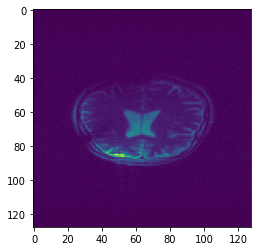

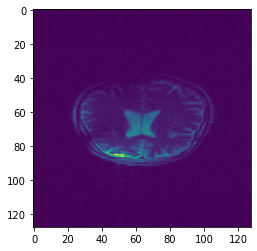

Time taken for epoch:  2.7871201038360596
[0]
Dev_Loss 8.266086774405389e-11 Epoch 182
Epoch = [ 182/ 250] TrainLoss = 3.299e-10  DevLoss = 8.266e-11 TrainTime = 1.5428s DevTime = 0.6795s


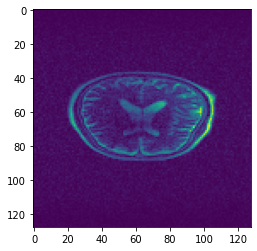

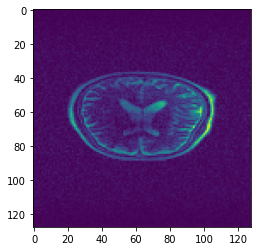

Time taken for epoch:  2.511383056640625
[0]
Dev_Loss 7.867258679934334e-11 Epoch 183
Epoch = [ 183/ 250] TrainLoss = 3.254e-10  DevLoss = 7.867e-11 TrainTime = 1.5359s DevTime = 0.6784s


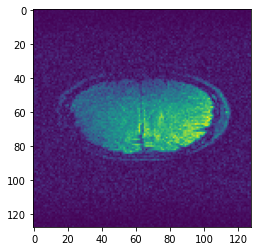

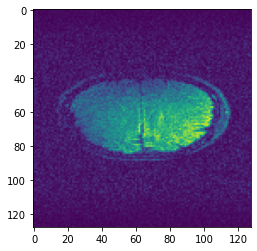

Time taken for epoch:  2.601957082748413
[0]
Dev_Loss 7.358490609185882e-11 Epoch 184
Epoch = [ 184/ 250] TrainLoss = 3e-10  DevLoss = 7.358e-11 TrainTime = 1.6266s DevTime = 0.7335s


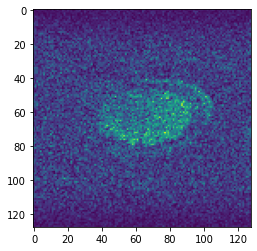

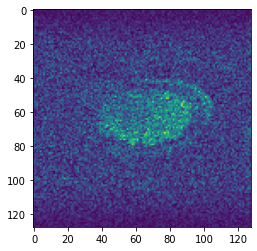

Time taken for epoch:  2.6417698860168457
[0]
Dev_Loss 7.317866882538602e-11 Epoch 185
Epoch = [ 185/ 250] TrainLoss = 3.043e-10  DevLoss = 7.318e-11 TrainTime = 1.5895s DevTime = 0.7092s


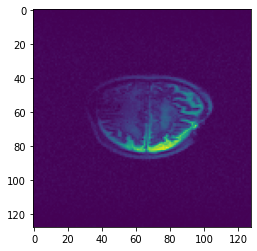

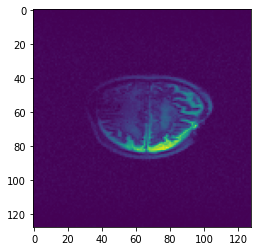

Time taken for epoch:  2.599485158920288
[0]
Dev_Loss 6.553074083218015e-11 Epoch 186
Epoch = [ 186/ 250] TrainLoss = 2.742e-10  DevLoss = 6.553e-11 TrainTime = 1.5449s DevTime = 0.7248s


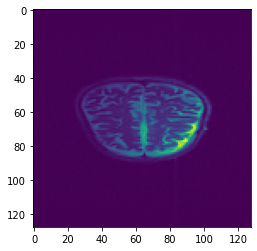

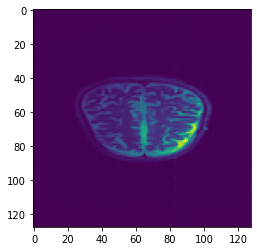

Time taken for epoch:  2.530507802963257
[0]
Dev_Loss 6.21809779781939e-11 Epoch 187
Epoch = [ 187/ 250] TrainLoss = 2.467e-10  DevLoss = 6.218e-11 TrainTime = 1.5178s DevTime = 0.7030s


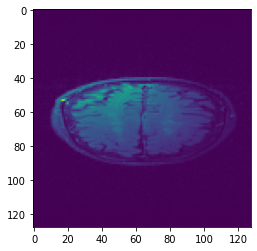

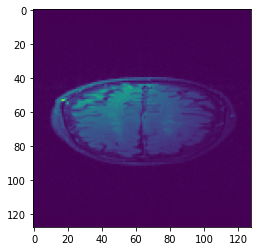

Time taken for epoch:  2.486017942428589
[0]
Dev_Loss 5.930885678347e-11 Epoch 188
Epoch = [ 188/ 250] TrainLoss = 2.423e-10  DevLoss = 5.931e-11 TrainTime = 1.5722s DevTime = 0.7342s


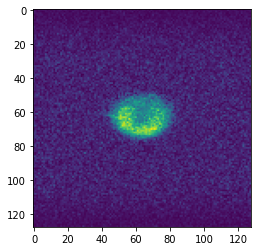

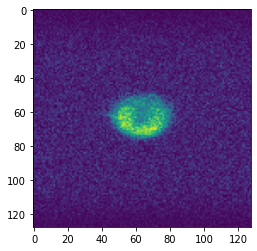

Time taken for epoch:  2.600358486175537
[0]
Dev_Loss 5.786697380405116e-11 Epoch 189
Epoch = [ 189/ 250] TrainLoss = 2.363e-10  DevLoss = 5.787e-11 TrainTime = 1.6210s DevTime = 0.7044s


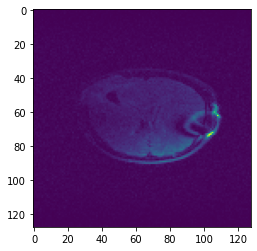

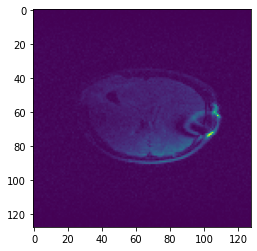

Time taken for epoch:  2.6162993907928467
[0]
Dev_Loss 5.30707851670409e-11 Epoch 190
Epoch = [ 190/ 250] TrainLoss = 1.958e-10  DevLoss = 5.307e-11 TrainTime = 1.5221s DevTime = 0.7155s


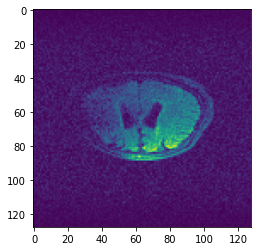

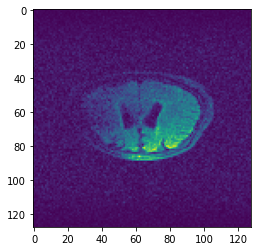

Time taken for epoch:  2.518049716949463
[0]
Dev_Loss 4.9534762585510334e-11 Epoch 191
Epoch = [ 191/ 250] TrainLoss = 1.941e-10  DevLoss = 4.953e-11 TrainTime = 1.5408s DevTime = 0.6785s


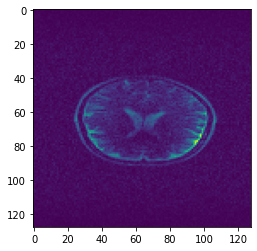

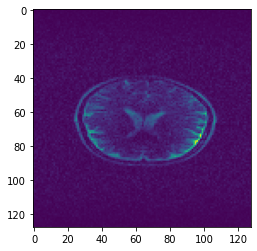

Time taken for epoch:  2.504974126815796
[0]
Dev_Loss 4.924341369226791e-11 Epoch 192
Epoch = [ 192/ 250] TrainLoss = 1.864e-10  DevLoss = 4.924e-11 TrainTime = 1.7795s DevTime = 0.6717s


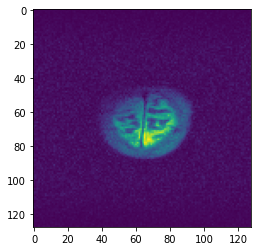

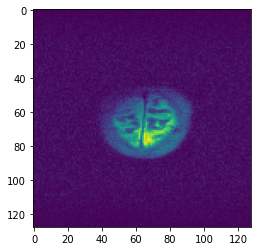

Time taken for epoch:  2.7390477657318115
[0]
Dev_Loss 4.412481623592368e-11 Epoch 193
Epoch = [ 193/ 250] TrainLoss = 1.753e-10  DevLoss = 4.412e-11 TrainTime = 1.5534s DevTime = 0.7152s


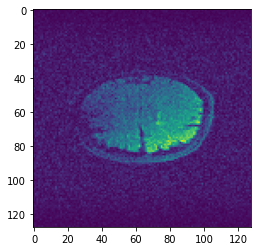

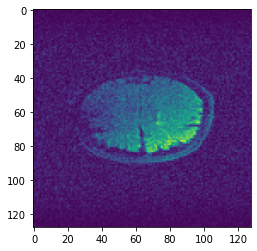

Time taken for epoch:  2.661773681640625
[0]
Dev_Loss 4.196851044312133e-11 Epoch 194
Epoch = [ 194/ 250] TrainLoss = 1.502e-10  DevLoss = 4.197e-11 TrainTime = 1.5247s DevTime = 0.7069s


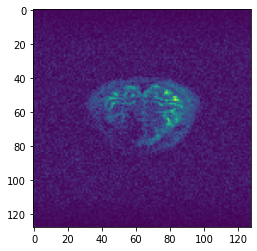

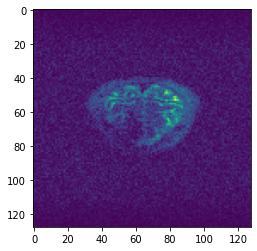

Time taken for epoch:  2.517770528793335
[0]
Dev_Loss 4.064028062670936e-11 Epoch 195
Epoch = [ 195/ 250] TrainLoss = 1.588e-10  DevLoss = 4.064e-11 TrainTime = 1.5264s DevTime = 0.6713s


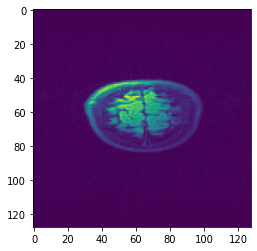

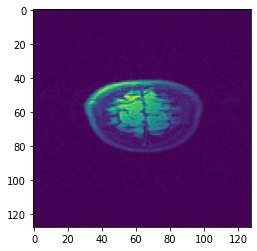

Time taken for epoch:  2.4623231887817383
[0]
Dev_Loss 3.750748313236947e-11 Epoch 196
Epoch = [ 196/ 250] TrainLoss = 1.487e-10  DevLoss = 3.751e-11 TrainTime = 1.5376s DevTime = 0.7040s


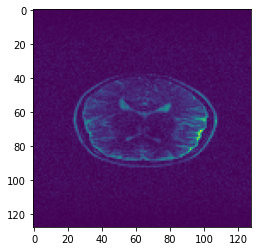

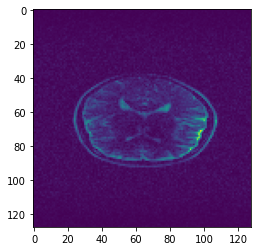

Time taken for epoch:  2.5227134227752686
[0]
Dev_Loss 3.5364807406136644e-11 Epoch 197
Epoch = [ 197/ 250] TrainLoss = 1.458e-10  DevLoss = 3.536e-11 TrainTime = 1.5220s DevTime = 0.6695s


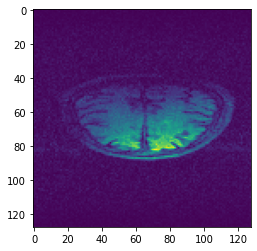

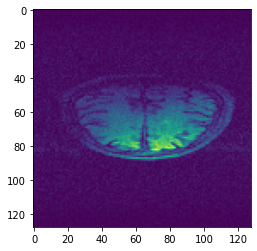

Time taken for epoch:  2.4845166206359863
[0]
Dev_Loss 3.4479825511342584e-11 Epoch 198
Epoch = [ 198/ 250] TrainLoss = 1.229e-10  DevLoss = 3.448e-11 TrainTime = 1.6348s DevTime = 0.7724s


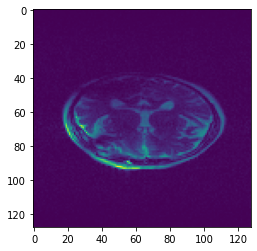

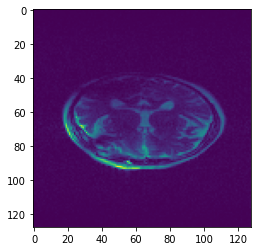

Time taken for epoch:  2.6907196044921875
[0]
Dev_Loss 3.166088595778496e-11 Epoch 199
Epoch = [ 199/ 250] TrainLoss = 1.264e-10  DevLoss = 3.166e-11 TrainTime = 1.5936s DevTime = 0.7270s


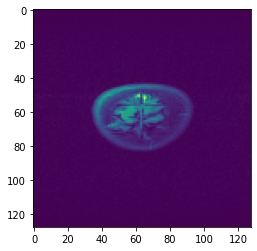

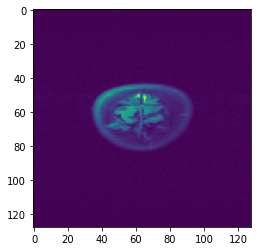

Time taken for epoch:  2.5832531452178955
[0]
Dev_Loss 3.117572832264298e-11 Epoch 200
Epoch = [ 200/ 250] TrainLoss = 1.227e-10  DevLoss = 3.118e-11 TrainTime = 1.5532s DevTime = 0.6768s


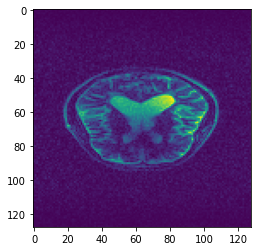

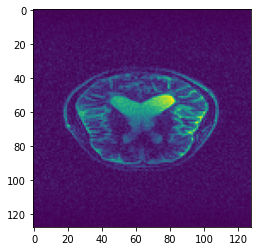

Time taken for epoch:  2.5296630859375
[0]
Dev_Loss 3.1065608440739596e-11 Epoch 201
Epoch = [ 201/ 250] TrainLoss = 1.302e-10  DevLoss = 3.107e-11 TrainTime = 1.5387s DevTime = 0.6797s


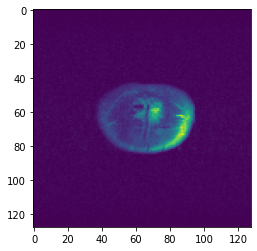

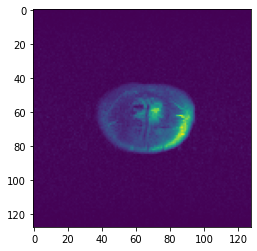

Time taken for epoch:  2.4990906715393066
[0]
Dev_Loss 3.080808356475521e-11 Epoch 202
Epoch = [ 202/ 250] TrainLoss = 1.223e-10  DevLoss = 3.081e-11 TrainTime = 1.5242s DevTime = 1.6367s


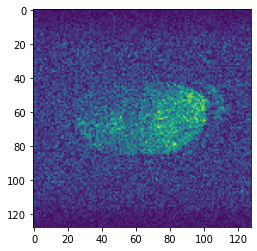

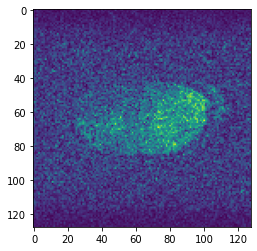

Time taken for epoch:  3.5505871772766113
[0]
Dev_Loss 3.065436711986133e-11 Epoch 203
Epoch = [ 203/ 250] TrainLoss = 1.209e-10  DevLoss = 3.065e-11 TrainTime = 1.5423s DevTime = 0.6777s


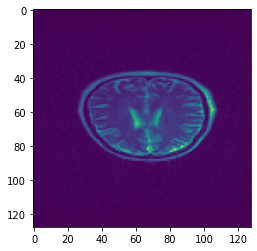

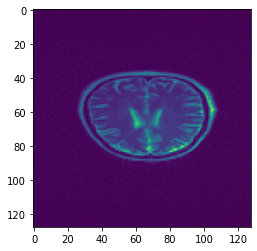

Time taken for epoch:  2.4896838665008545
[0]
Dev_Loss 3.0484647925400467e-11 Epoch 204
Epoch = [ 204/ 250] TrainLoss = 1.106e-10  DevLoss = 3.048e-11 TrainTime = 1.5836s DevTime = 0.7044s


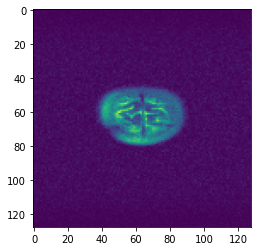

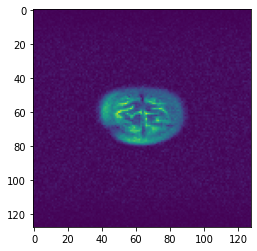

Time taken for epoch:  2.578169822692871
[0]
Dev_Loss 3.0318864886649866e-11 Epoch 205
Epoch = [ 205/ 250] TrainLoss = 1.221e-10  DevLoss = 3.032e-11 TrainTime = 1.5259s DevTime = 0.6684s


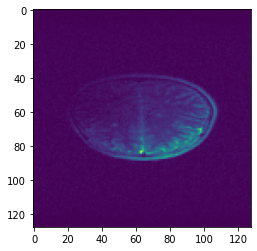

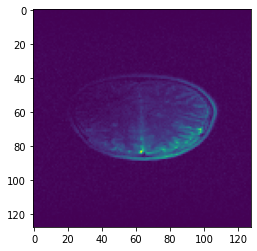

Time taken for epoch:  2.4680874347686768
[0]
Dev_Loss 3.013502954269319e-11 Epoch 206
Epoch = [ 206/ 250] TrainLoss = 1.197e-10  DevLoss = 3.014e-11 TrainTime = 1.6241s DevTime = 0.7535s


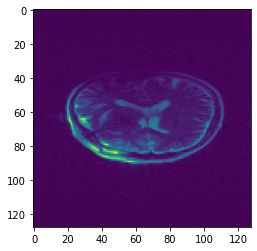

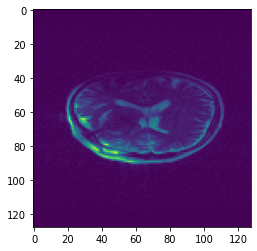

Time taken for epoch:  2.642604112625122
[0]
Dev_Loss 2.9949470050729095e-11 Epoch 207
Epoch = [ 207/ 250] TrainLoss = 1.15e-10  DevLoss = 2.995e-11 TrainTime = 1.5622s DevTime = 0.7174s


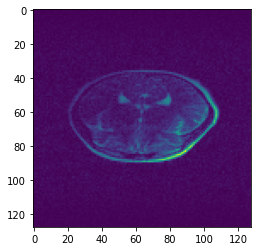

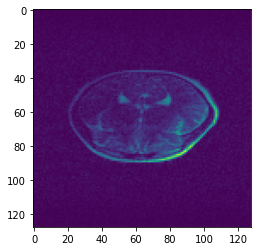

Time taken for epoch:  2.5620248317718506
[0]
Dev_Loss 2.980994020469837e-11 Epoch 208
Epoch = [ 208/ 250] TrainLoss = 1.297e-10  DevLoss = 2.981e-11 TrainTime = 1.5641s DevTime = 0.6774s


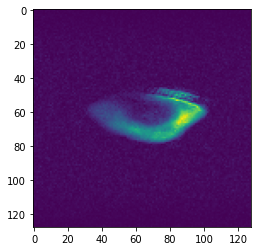

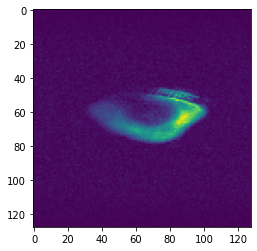

Time taken for epoch:  2.5242035388946533
[0]
Dev_Loss 2.9609122543325765e-11 Epoch 209
Epoch = [ 209/ 250] TrainLoss = 1.133e-10  DevLoss = 2.961e-11 TrainTime = 1.5111s DevTime = 0.7261s


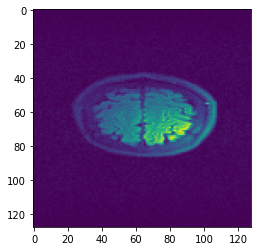

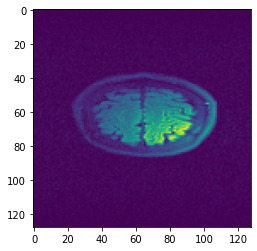

Time taken for epoch:  2.519190788269043
[0]
Dev_Loss 2.94588057310224e-11 Epoch 210
Epoch = [ 210/ 250] TrainLoss = 1.131e-10  DevLoss = 2.946e-11 TrainTime = 1.5437s DevTime = 0.7074s


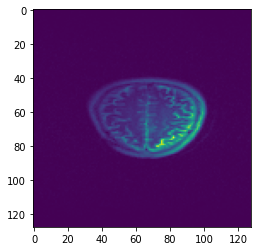

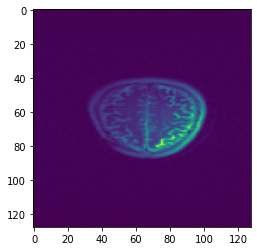

Time taken for epoch:  2.510100841522217
[0]
Dev_Loss 2.927564641166679e-11 Epoch 211
Epoch = [ 211/ 250] TrainLoss = 1.092e-10  DevLoss = 2.928e-11 TrainTime = 1.5209s DevTime = 0.6738s


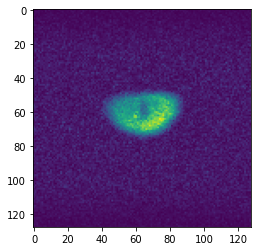

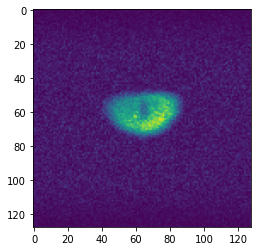

Time taken for epoch:  2.48014235496521
[0]
Dev_Loss 2.914006272490041e-11 Epoch 212
Epoch = [ 212/ 250] TrainLoss = 1.153e-10  DevLoss = 2.914e-11 TrainTime = 1.5417s DevTime = 1.0204s


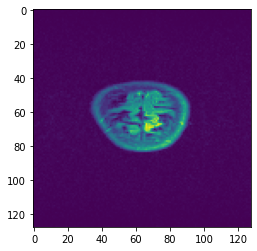

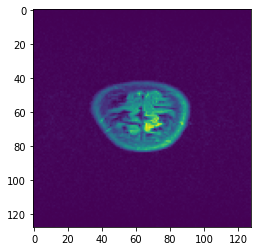

Time taken for epoch:  2.9335954189300537
[0]
Dev_Loss 2.9265851799932645e-11 Epoch 213
Epoch = [ 213/ 250] TrainLoss = 1.057e-10  DevLoss = 2.927e-11 TrainTime = 1.7075s DevTime = 0.7119s


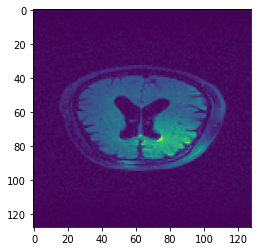

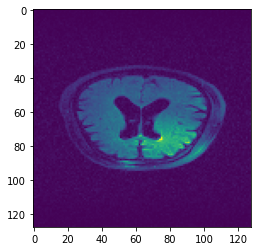

Time taken for epoch:  2.713754177093506
[0]
Dev_Loss 2.882164655745985e-11 Epoch 214
Epoch = [ 214/ 250] TrainLoss = 1.078e-10  DevLoss = 2.882e-11 TrainTime = 1.5885s DevTime = 0.7322s


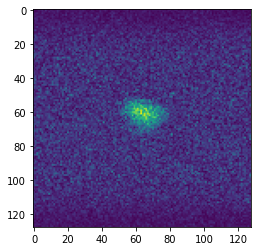

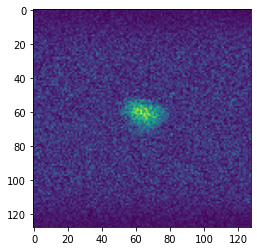

Time taken for epoch:  2.618450403213501
[0]
Dev_Loss 2.8630047444680207e-11 Epoch 215
Epoch = [ 215/ 250] TrainLoss = 1.15e-10  DevLoss = 2.863e-11 TrainTime = 1.6038s DevTime = 0.7236s


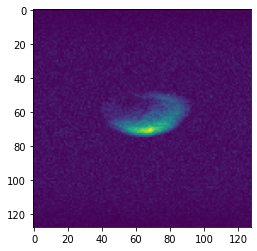

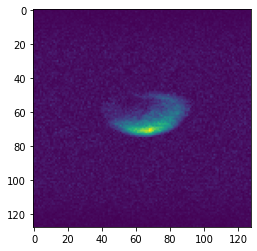

Time taken for epoch:  2.6210951805114746
[0]
Dev_Loss 2.8493796950854144e-11 Epoch 216
Epoch = [ 216/ 250] TrainLoss = 1.115e-10  DevLoss = 2.849e-11 TrainTime = 1.5474s DevTime = 0.7805s


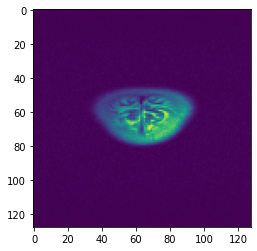

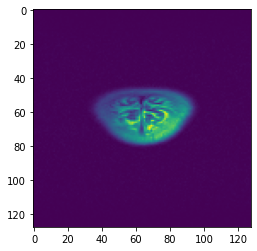

Time taken for epoch:  2.596480369567871
[0]
Dev_Loss 2.8315278107707627e-11 Epoch 217
Epoch = [ 217/ 250] TrainLoss = 1.098e-10  DevLoss = 2.832e-11 TrainTime = 1.5233s DevTime = 0.7136s


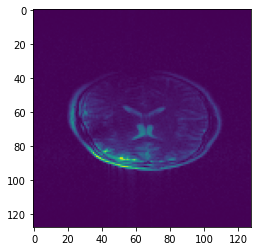

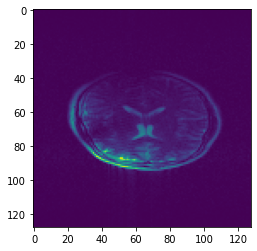

Time taken for epoch:  2.502065896987915
[0]
Dev_Loss 2.82408267686366e-11 Epoch 218
Epoch = [ 218/ 250] TrainLoss = 1.206e-10  DevLoss = 2.824e-11 TrainTime = 1.5230s DevTime = 1.7561s


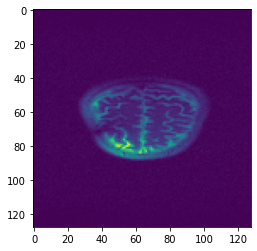

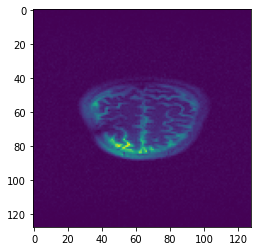

Time taken for epoch:  3.5603716373443604
[0]
Dev_Loss 2.799632496689178e-11 Epoch 219
Epoch = [ 219/ 250] TrainLoss = 1.032e-10  DevLoss = 2.8e-11 TrainTime = 1.9938s DevTime = 0.7114s


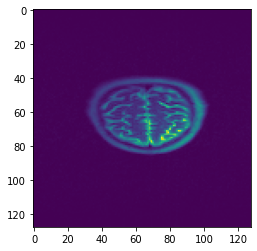

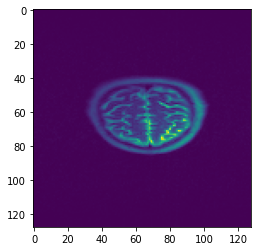

Time taken for epoch:  2.9627037048339844
[0]
Dev_Loss 2.7879184780064918e-11 Epoch 220
Epoch = [ 220/ 250] TrainLoss = 9.698e-11  DevLoss = 2.788e-11 TrainTime = 1.5654s DevTime = 0.6707s


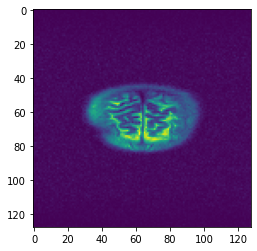

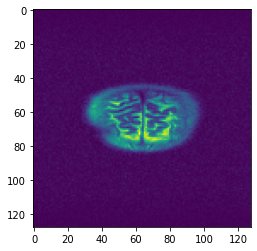

Time taken for epoch:  2.525161027908325
[0]
Dev_Loss 2.769278943404156e-11 Epoch 221
Epoch = [ 221/ 250] TrainLoss = 1.148e-10  DevLoss = 2.769e-11 TrainTime = 1.5234s DevTime = 0.6709s


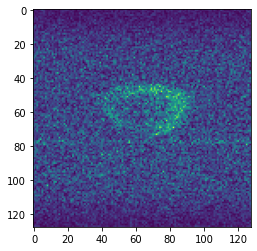

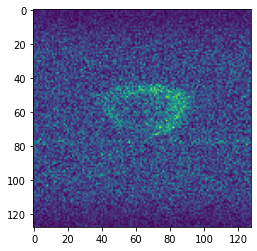

Time taken for epoch:  2.586944580078125
[0]
Dev_Loss 2.752755015699328e-11 Epoch 222
Epoch = [ 222/ 250] TrainLoss = 1.089e-10  DevLoss = 2.753e-11 TrainTime = 1.6186s DevTime = 0.7487s


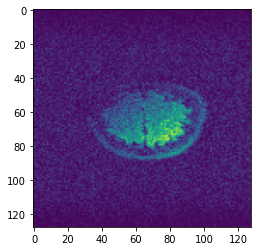

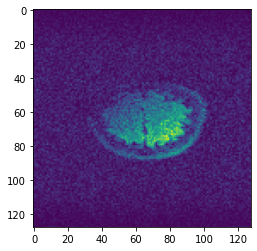

Time taken for epoch:  2.6529576778411865
[0]
Dev_Loss 2.7413110533686518e-11 Epoch 223
Epoch = [ 223/ 250] TrainLoss = 1.103e-10  DevLoss = 2.741e-11 TrainTime = 1.5574s DevTime = 0.7842s


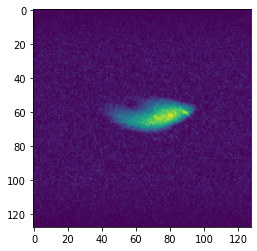

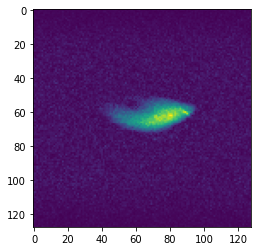

Time taken for epoch:  2.6389214992523193
[0]
Dev_Loss 2.7269161819486906e-11 Epoch 224
Epoch = [ 224/ 250] TrainLoss = 1.123e-10  DevLoss = 2.727e-11 TrainTime = 1.5388s DevTime = 0.6739s


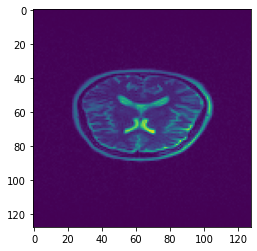

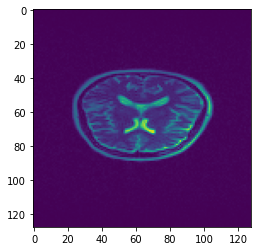

Time taken for epoch:  2.486046314239502
[0]
Dev_Loss 2.707551228158206e-11 Epoch 225
Epoch = [ 225/ 250] TrainLoss = 1.023e-10  DevLoss = 2.708e-11 TrainTime = 1.5173s DevTime = 0.7052s


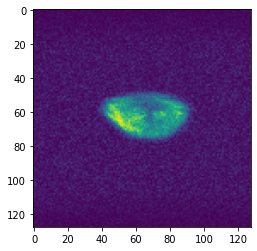

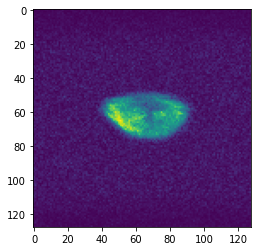

Time taken for epoch:  2.506136894226074
[0]
Dev_Loss 2.7151895895688415e-11 Epoch 226
Epoch = [ 226/ 250] TrainLoss = 1.026e-10  DevLoss = 2.715e-11 TrainTime = 1.5262s DevTime = 0.6703s


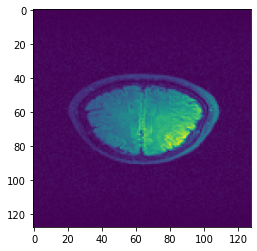

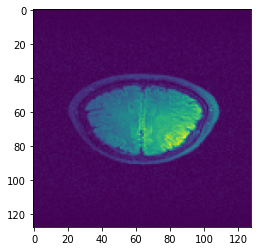

Time taken for epoch:  2.48268461227417
[0]
Dev_Loss 2.687540112848901e-11 Epoch 227
Epoch = [ 227/ 250] TrainLoss = 1.135e-10  DevLoss = 2.688e-11 TrainTime = 1.5373s DevTime = 0.6906s


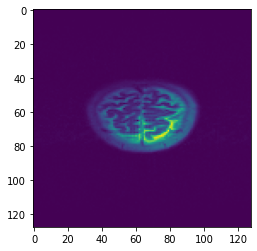

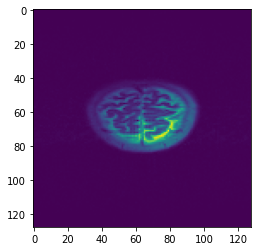

Time taken for epoch:  2.488095283508301
[0]
Dev_Loss 2.66957171998874e-11 Epoch 228
Epoch = [ 228/ 250] TrainLoss = 1.066e-10  DevLoss = 2.67e-11 TrainTime = 1.6325s DevTime = 0.7158s


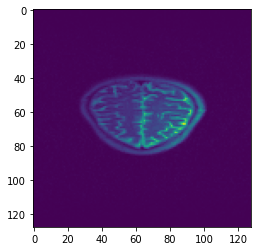

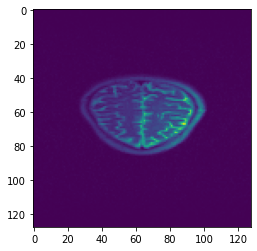

Time taken for epoch:  2.6155731678009033
[0]
Dev_Loss 2.646977410450233e-11 Epoch 229
Epoch = [ 229/ 250] TrainLoss = 1.003e-10  DevLoss = 2.647e-11 TrainTime = 1.5280s DevTime = 0.7462s


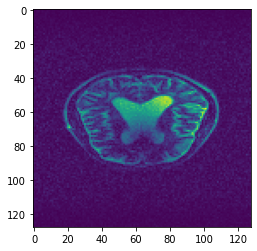

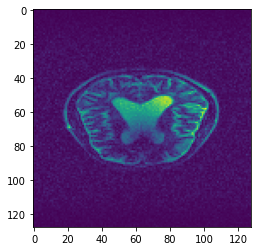

Time taken for epoch:  2.5624070167541504
[0]
Dev_Loss 2.6320360581093205e-11 Epoch 230
Epoch = [ 230/ 250] TrainLoss = 9.421e-11  DevLoss = 2.632e-11 TrainTime = 1.5479s DevTime = 0.6759s


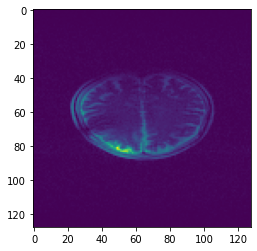

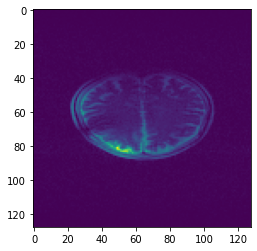

Time taken for epoch:  2.500368595123291
[0]
Dev_Loss 2.6178413129650892e-11 Epoch 231
Epoch = [ 231/ 250] TrainLoss = 9.977e-11  DevLoss = 2.618e-11 TrainTime = 1.5343s DevTime = 0.7144s


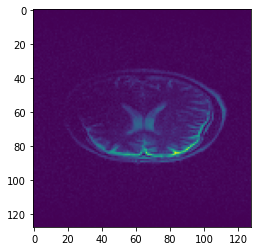

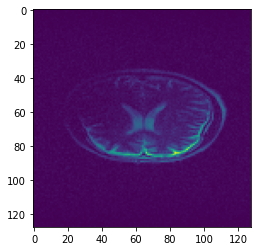

Time taken for epoch:  2.635737419128418
[0]
Dev_Loss 2.6077308566554383e-11 Epoch 232
Epoch = [ 232/ 250] TrainLoss = 9.842e-11  DevLoss = 2.608e-11 TrainTime = 1.5398s DevTime = 0.6791s


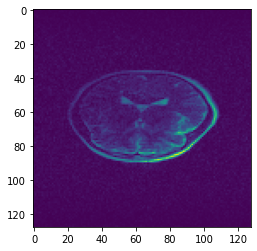

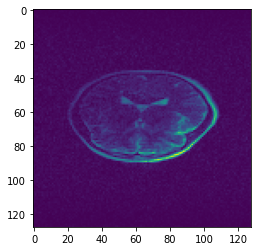

Time taken for epoch:  2.4996492862701416
[0]
Dev_Loss 2.588374838530675e-11 Epoch 233
Epoch = [ 233/ 250] TrainLoss = 1.076e-10  DevLoss = 2.588e-11 TrainTime = 1.6041s DevTime = 0.7050s


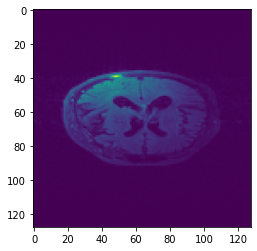

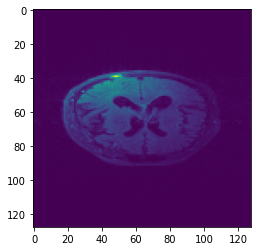

Time taken for epoch:  2.5713727474212646
[0]
Dev_Loss 2.5739514684425557e-11 Epoch 234
Epoch = [ 234/ 250] TrainLoss = 1.001e-10  DevLoss = 2.574e-11 TrainTime = 1.5937s DevTime = 0.7438s


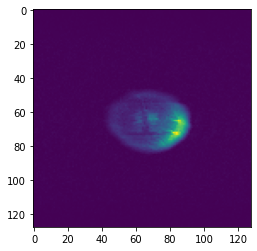

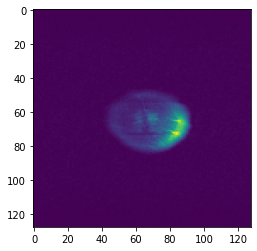

Time taken for epoch:  2.6068551540374756
[0]
Dev_Loss 2.5691331061748435e-11 Epoch 235
Epoch = [ 235/ 250] TrainLoss = 9.798e-11  DevLoss = 2.569e-11 TrainTime = 2.1142s DevTime = 0.7568s


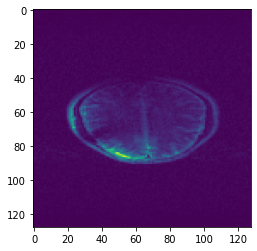

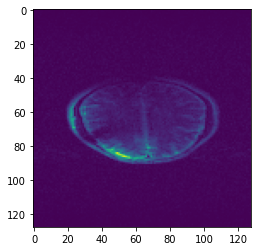

Time taken for epoch:  3.161557197570801
[0]
Dev_Loss 2.5518056508845933e-11 Epoch 236
Epoch = [ 236/ 250] TrainLoss = 9.401e-11  DevLoss = 2.552e-11 TrainTime = 1.7148s DevTime = 0.7183s


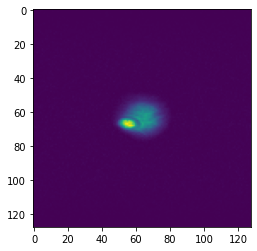

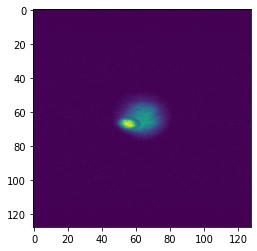

Time taken for epoch:  2.7069289684295654
[0]
Dev_Loss 2.5331859885560708e-11 Epoch 237
Epoch = [ 237/ 250] TrainLoss = 1e-10  DevLoss = 2.533e-11 TrainTime = 1.5175s DevTime = 0.6717s


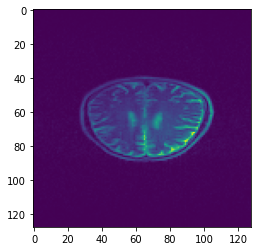

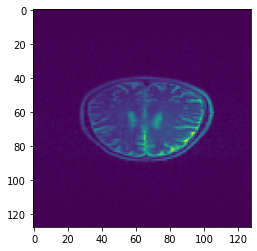

Time taken for epoch:  2.464738368988037
[0]
Dev_Loss 2.5192271518779063e-11 Epoch 238
Epoch = [ 238/ 250] TrainLoss = 1.043e-10  DevLoss = 2.519e-11 TrainTime = 1.5204s DevTime = 0.7130s


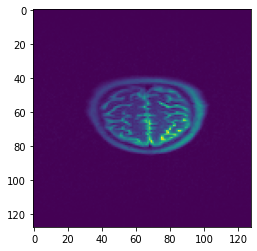

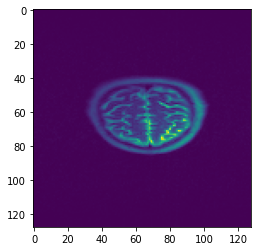

Time taken for epoch:  2.499243974685669
[0]
Dev_Loss 2.5075728495652463e-11 Epoch 239
Epoch = [ 239/ 250] TrainLoss = 9.529e-11  DevLoss = 2.508e-11 TrainTime = 1.5308s DevTime = 0.6792s


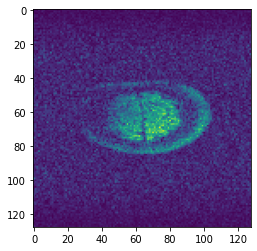

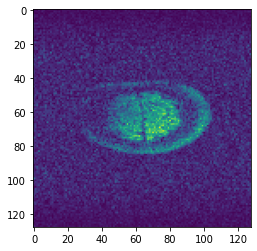

Time taken for epoch:  2.499628782272339
[0]
Dev_Loss 2.488988367305294e-11 Epoch 240
Epoch = [ 240/ 250] TrainLoss = 9.172e-11  DevLoss = 2.489e-11 TrainTime = 1.5269s DevTime = 0.6784s


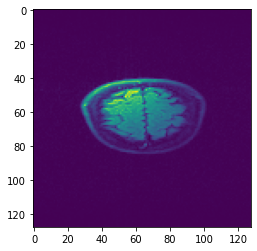

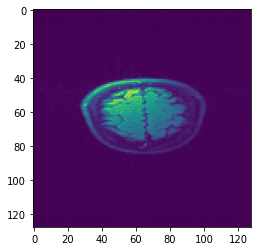

Time taken for epoch:  2.568331003189087
[0]
Dev_Loss 2.480050785830298e-11 Epoch 241
Epoch = [ 241/ 250] TrainLoss = 9.133e-11  DevLoss = 2.48e-11 TrainTime = 1.6390s DevTime = 0.7374s


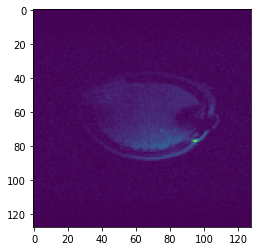

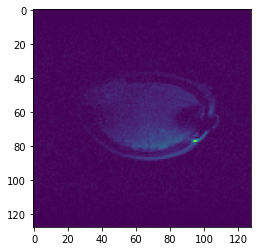

Time taken for epoch:  2.657654047012329
[0]
Dev_Loss 2.511686736488714e-11 Epoch 242
Epoch = [ 242/ 250] TrainLoss = 9.274e-11  DevLoss = 2.512e-11 TrainTime = 1.5828s DevTime = 0.6827s


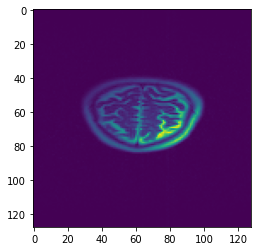

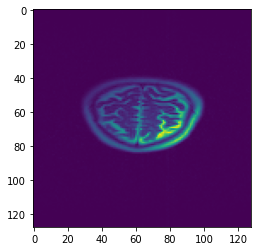

Time taken for epoch:  2.5262081623077393
[0]
Dev_Loss 2.44960541701839e-11 Epoch 243
Epoch = [ 243/ 250] TrainLoss = 9.045e-11  DevLoss = 2.45e-11 TrainTime = 1.5528s DevTime = 0.7501s


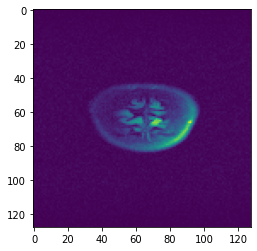

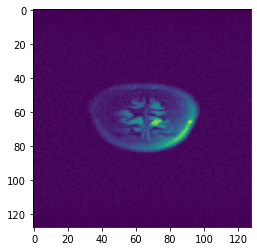

Time taken for epoch:  2.5862772464752197
[0]
Dev_Loss 2.4425997327917562e-11 Epoch 244
Epoch = [ 244/ 250] TrainLoss = 9.264e-11  DevLoss = 2.443e-11 TrainTime = 1.5298s DevTime = 0.7146s


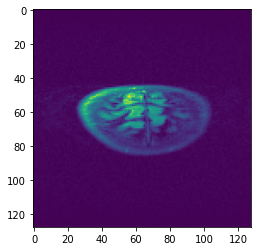

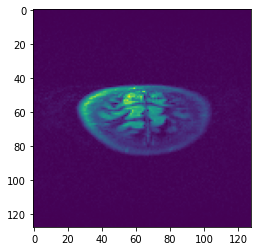

Time taken for epoch:  2.512561082839966
[0]
Dev_Loss 2.422669223078992e-11 Epoch 245
Epoch = [ 245/ 250] TrainLoss = 9.881e-11  DevLoss = 2.423e-11 TrainTime = 1.5328s DevTime = 0.6938s


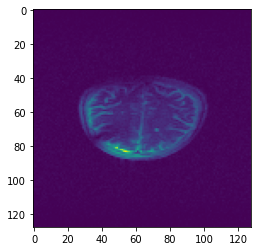

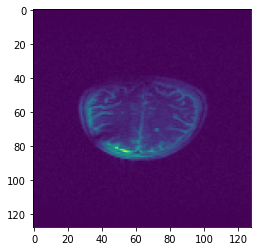

Time taken for epoch:  2.5088629722595215
[0]
Dev_Loss 2.4108928648631935e-11 Epoch 246
Epoch = [ 246/ 250] TrainLoss = 9.631e-11  DevLoss = 2.411e-11 TrainTime = 1.5359s DevTime = 0.6818s


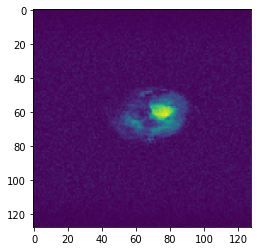

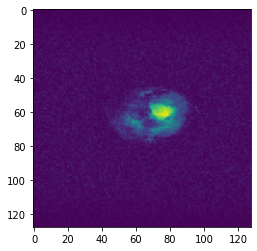

Time taken for epoch:  2.51051926612854
[0]
Dev_Loss 2.3943801287995713e-11 Epoch 247
Epoch = [ 247/ 250] TrainLoss = 9.163e-11  DevLoss = 2.394e-11 TrainTime = 1.5308s DevTime = 0.7139s


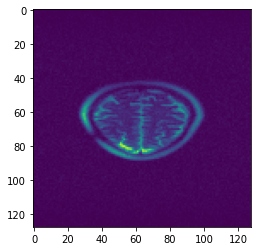

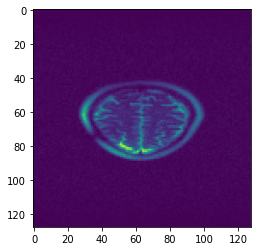

Time taken for epoch:  2.5304112434387207
[0]
Dev_Loss 2.386485895464684e-11 Epoch 248
Epoch = [ 248/ 250] TrainLoss = 8.696e-11  DevLoss = 2.386e-11 TrainTime = 1.5311s DevTime = 0.6884s


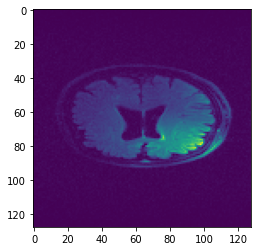

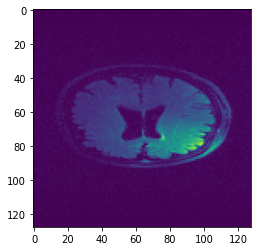

Time taken for epoch:  2.493298053741455
[0]
Dev_Loss 2.374910202971861e-11 Epoch 249
Epoch = [ 249/ 250] TrainLoss = 9.435e-11  DevLoss = 2.375e-11 TrainTime = 1.5375s DevTime = 0.7149s


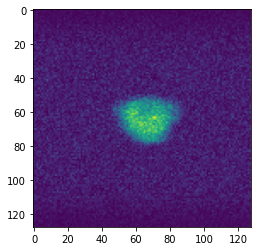

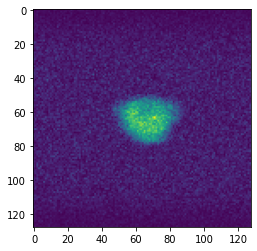

Time taken for epoch:  2.5464680194854736


2.374910202971861e-11

In [8]:
def train(args): 
    args.exp_dir.mkdir(parents=True, exist_ok=True)
    writer = SummaryWriter(logdir=str(args.logdir)) #log directory for run

    if args.resume: #be aware of the option
        checkpoint, model, optimizer = load_model(args.checkpoint,args)
        args = checkpoint['args']
        best_dev_loss = checkpoint['best_dev_loss']
        #start_epoch = checkpoint['epoch']
        start_epoch = 0
        del checkpoint
    else:
        model = build_model(args)
        optimizer = build_optim(args, model.parameters())
        best_dev_loss = 1e9
        start_epoch = 0
    logging.info(args)
    logging.info(model)

    #train_loader,dev_loader,test_loader = create_data_loaders()
    scheduler = torch.optim.lr_scheduler.StepLR(optimizer, args.lr_step_size, args.lr_gamma)
    optimizer.step()

    for epoch in range(start_epoch, args.num_epochs):
        ti=time.time()
        scheduler.step(epoch)
        train_loss, train_time = train_epoch(args, epoch, model, train_loader, optimizer, writer)
        dev_loss, dev_time = evaluate(args, epoch, model, dev_loader, writer)
        #visualize(args, epoch, model, train_loader, writer)

        is_new_best = dev_loss < best_dev_loss
        best_dev_loss = min(best_dev_loss, dev_loss)
        save_model(args, args.exp_dir, epoch, model, optimizer, best_dev_loss, is_new_best)
        print(f'Epoch = [{epoch:4d}/{args.num_epochs:4d}] TrainLoss = {train_loss:.4g} ',
        f'DevLoss = {dev_loss:.4g} TrainTime = {train_time:.4f}s DevTime = {dev_time:.4f}s')
        
        for iter, data in enumerate(train_loader):
            kspace, full = data
            input = kspace.to(f'{args.device}:{model.device_ids[0]}')
            target = full.to(f'{args.device}:{model.device_ids[0]}')
            output_r,output_i = model(input)
            output_r=output_r.to('cpu').detach().numpy()
            output_i=output_i.to('cpu').detach().numpy()
            output = output_r+output_i*1j
            image = abs(output.squeeze(1))
            #print(output)
            plt.imshow(image[0,:,:])
            plt.show()
            plt.imshow(target[0,:,:].to('cpu').detach().numpy())
            plt.show()
            break;
        
        logging.info(
            f'Epoch = [{epoch:4d}/{args.num_epochs:4d}] TrainLoss = {train_loss:.4g} '
            f'DevLoss = {dev_loss:.4g} TrainTime = {train_time:.4f}s DevTime = {dev_time:.4f}s',
        )
        print("Time taken for epoch: ",time.time()-ti)
    writer.close()
    return dev_loss
    
train(args)

In [13]:
#f ="/mnt/mnt/5TB_slot2/Tobias/Thesis/FF_lrelue_2020/best_model.pt"
checkpoint, model, optimizer = load_model(args.checkpoint,args)
model.eval()

Model build successfully
Model load successfully


DataParallel(
  (module): td_fourier_net(
    (c_layer1): ComplexConv2d(
      (conv_r): Conv2d(1, 128, kernel_size=(1, 128), stride=(1, 1), bias=False)
      (conv_i): Conv2d(1, 128, kernel_size=(1, 128), stride=(1, 1), bias=False)
    )
    (c_layer2): ComplexConv2d(
      (conv_r): Conv2d(1, 128, kernel_size=(1, 128), stride=(1, 1), bias=False)
      (conv_i): Conv2d(1, 128, kernel_size=(1, 128), stride=(1, 1), bias=False)
    )
  )
)

module.c_layer1.conv_r.weight tensor([[[[ 0.0046, -0.0046,  0.0046,  ..., -0.0046,  0.0046, -0.0046]]],


        [[[ 0.0018, -0.0021,  0.0025,  ..., -0.0006,  0.0010, -0.0014]]],


        [[[-0.0074,  0.0076, -0.0078,  ...,  0.0062, -0.0066,  0.0070]]],


        ...,


        [[[ 0.0070, -0.0075,  0.0078,  ..., -0.0048,  0.0057, -0.0064]]],


        [[[-0.0067,  0.0071, -0.0074,  ...,  0.0052, -0.0058,  0.0063]]],


        [[[-0.0032,  0.0028, -0.0025,  ...,  0.0042, -0.0039,  0.0036]]]],
       device='cuda:0', dtype=torch.float64)


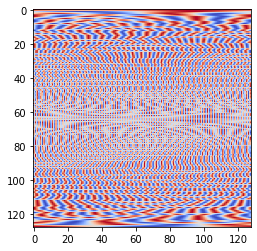

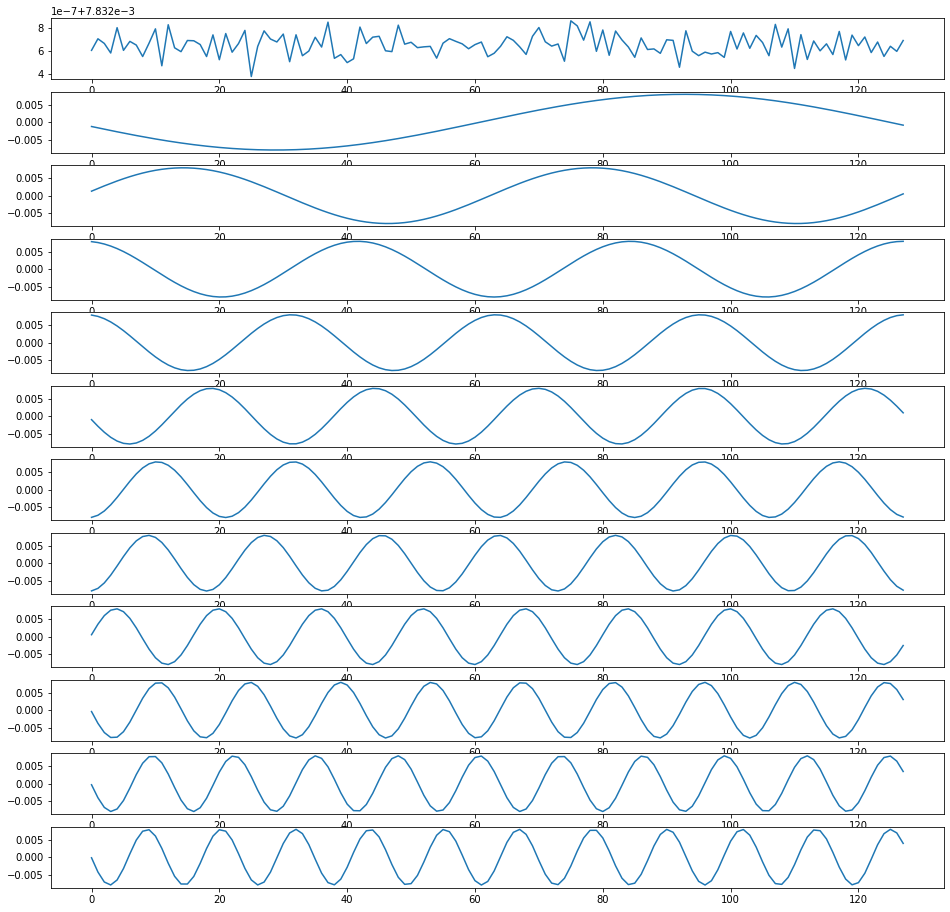

module.c_layer1.conv_i.weight tensor([[[[ 0.0065, -0.0065,  0.0065,  ..., -0.0065,  0.0065, -0.0065]]],


        [[[-0.0078,  0.0077, -0.0076,  ...,  0.0079, -0.0079,  0.0078]]],


        [[[ 0.0031, -0.0023,  0.0016,  ..., -0.0051,  0.0044, -0.0038]]],


        ...,


        [[[ 0.0037, -0.0027,  0.0015,  ..., -0.0064,  0.0056, -0.0047]]],


        [[[-0.0043,  0.0036, -0.0029,  ...,  0.0060, -0.0055,  0.0049]]],


        [[[ 0.0073, -0.0074,  0.0076,  ..., -0.0067,  0.0069, -0.0071]]]],
       device='cuda:0', dtype=torch.float64)


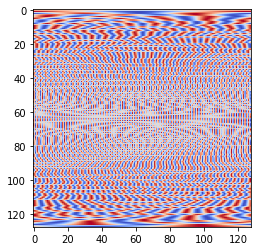

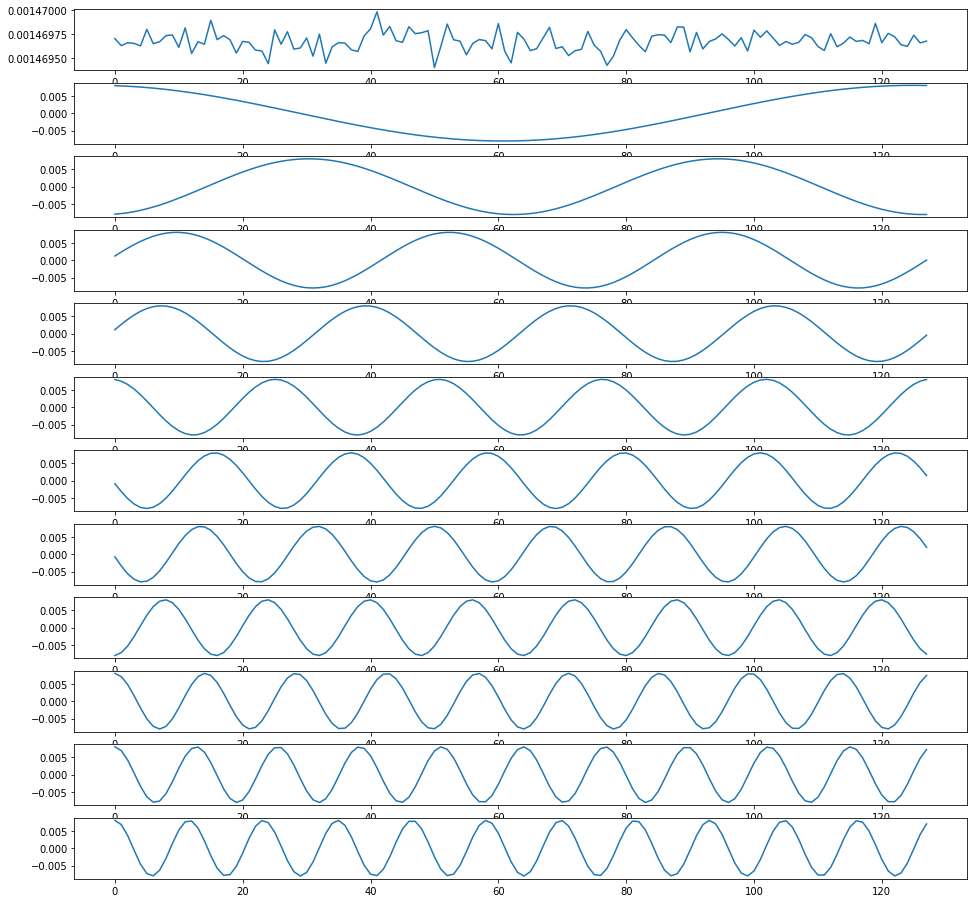

module.c_layer2.conv_r.weight tensor([[[[ 0.0069, -0.0069,  0.0069,  ..., -0.0069,  0.0069, -0.0069]]],


        [[[ 0.0034, -0.0037,  0.0041,  ..., -0.0024,  0.0027, -0.0031]]],


        [[[ 0.0049, -0.0043,  0.0037,  ..., -0.0064,  0.0060, -0.0055]]],


        ...,


        [[[-0.0059,  0.0051, -0.0042,  ...,  0.0074, -0.0071,  0.0066]]],


        [[[ 0.0023, -0.0016,  0.0008,  ..., -0.0043,  0.0037, -0.0030]]],


        [[[-0.0039,  0.0036, -0.0032,  ...,  0.0048, -0.0045,  0.0042]]]],
       device='cuda:0', dtype=torch.float64)


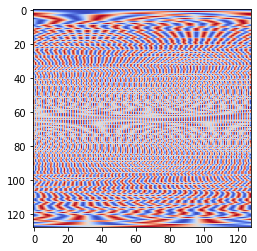

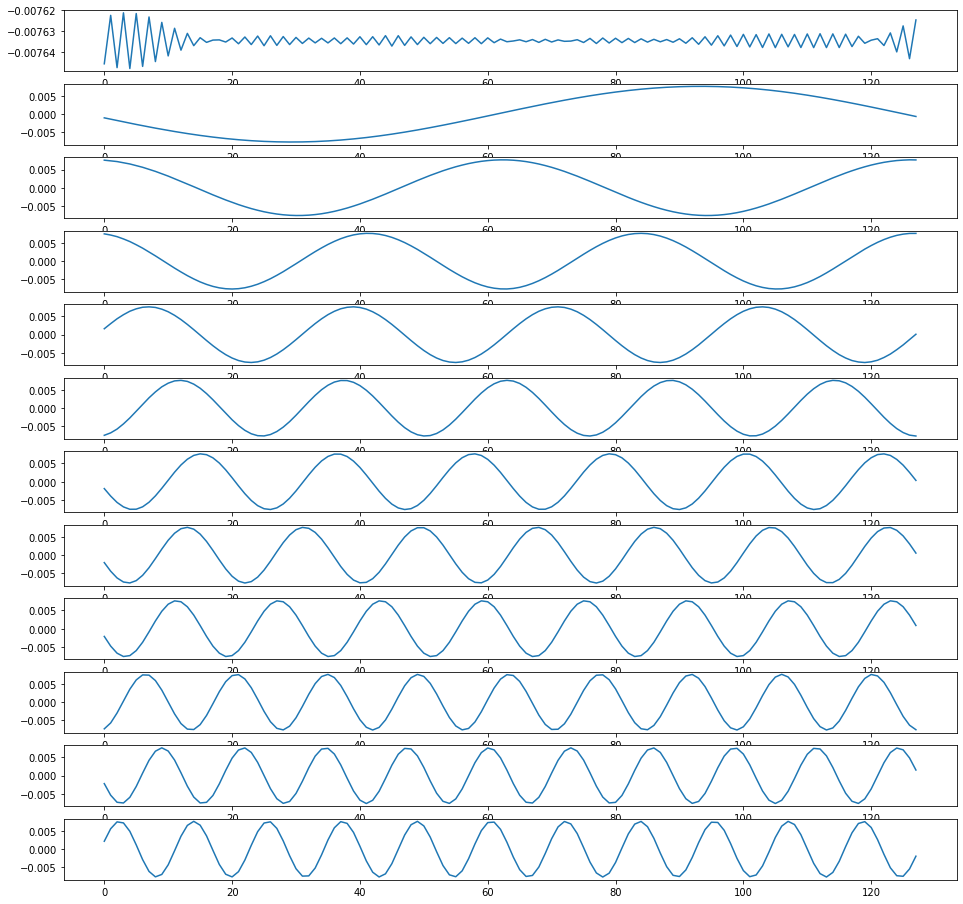

module.c_layer2.conv_i.weight tensor([[[[ 0.0034, -0.0034,  0.0034,  ..., -0.0034,  0.0034, -0.0034]]],


        [[[-0.0069,  0.0067, -0.0065,  ...,  0.0073, -0.0072,  0.0070]]],


        [[[ 0.0059, -0.0063,  0.0067,  ..., -0.0042,  0.0048, -0.0054]]],


        ...,


        [[[ 0.0049, -0.0057,  0.0064,  ..., -0.0019,  0.0030, -0.0040]]],


        [[[-0.0073,  0.0075, -0.0076,  ...,  0.0063, -0.0067,  0.0070]]],


        [[[ 0.0066, -0.0068,  0.0069,  ..., -0.0060,  0.0062, -0.0064]]]],
       device='cuda:0', dtype=torch.float64)


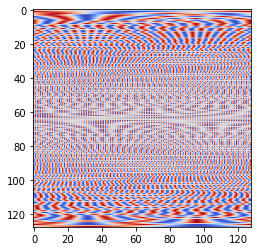

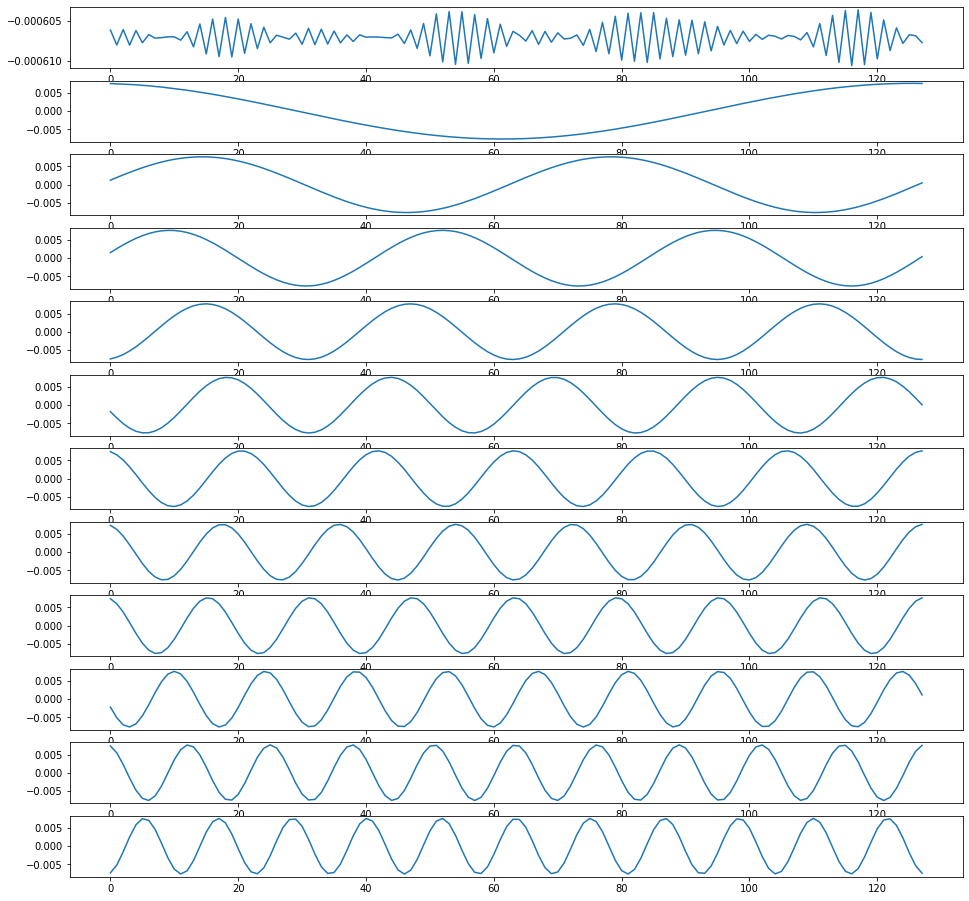

In [17]:
for name, param in model.named_parameters():
    if param.requires_grad:
        print(name, param.data)
        #plt.imshow(nf.ifftshift(param.data.cpu()[:,0,0,:]), vmin=-1, vmax=1, cmap='coolwarm')
        # Heat map of neuron weights
        weights=nf.ifftshift(param.data.cpu()[:,0,0,:])
        np.save(name+'.npy', param.data.cpu())
        plt.imshow(weights, vmin=np.min(param.data.cpu().numpy()), vmax=np.max(param.data.cpu().numpy()), cmap='coolwarm')
        plt.show()
        fig,ax=plt.subplots(args.resolution//10,1,figsize=(16,16))
        for i in range(args.resolution//10):
            ax[i].plot(weights[i,:args.resolution])
        plt.show()

In [11]:
def train_plain(args): 
    args.exp_dir.mkdir(parents=True, exist_ok=True)
    writer = SummaryWriter(logdir=str(args.logdir)) #log directory for run
    if args.resume: #be aware of the option
        checkpoint, model, optimizer = load_model(args.checkpoint,args)
        args = checkpoint['args']
        best_dev_loss = checkpoint['best_dev_loss']
        #start_epoch = checkpoint['epoch']
        start_epoch = 0
        del checkpoint
    else:
        model = build_model(args)
        optimizer = build_optim(args, model.parameters())
        best_dev_loss = 1e9
        start_epoch = 0
    #train_loader,dev_loader,test_loader = create_data_loaders()
    scheduler = torch.optim.lr_scheduler.StepLR(optimizer, args.lr_step_size, args.lr_gamma)
    optimizer.step()

    for epoch in range(start_epoch, args.num_epochs):
        ti=time.time()
        scheduler.step(epoch)
        train_loss, train_time = train_epoch(args, epoch, model, train_loader, optimizer, writer)
        dev_loss, dev_time = evaluate(args, epoch, model, dev_loader, writer)
        #visualize(args, epoch, model, train_loader, writer)

#         is_new_best = dev_loss < best_dev_loss
#         best_dev_loss = min(best_dev_loss, dev_loss)
#         save_model(args, args.exp_dir, epoch, model, optimizer, best_dev_loss, is_new_best)
    writer.close()
    return dev_loss

def run_model(lr):
    print(lr)
    args.lr=lr
    return train_plain(args)

In [12]:
from hyperopt import hp, tpe, fmin

# Single line bayesian optimization of polynomial function
args.num_epochs=100
best = fmin(fn=lambda x: run_model(x),
            space=hp.normal('x', 0.0001, 0.5),
            algo=tpe.suggest,
            max_evals=100)

0.08807207169355596                                    
Model build successfully                               
[0]                                                    
  0%|          | 0/100 [00:00<?, ?trial/s, best loss=?]

/opt/conda/lib/python3.6/site-packages/torch/optim/lr_scheduler.py:143: UserWarning: The epoch parameter in `scheduler.step()` was not necessary and is being deprecated where possible. Please use `scheduler.step()` to step the scheduler. During the deprecation, if epoch is different from None, the closed form is used instead of the new chainable form, where available. Please open an issue if you are unable to replicate your use case: https://github.com/pytorch/pytorch/issues/new/choose.
  warnings.warn(EPOCH_DEPRECATION_WARNING, UserWarning)



Dev_Loss                                               
0.0024690348454741123                                  
Epoch                                                  
0                                                      
[0]                                                    
  0%|          | 0/100 [00:03<?, ?trial/s, best loss=?]


KeyboardInterrupt: 

In [ ]:
print(best)

In [ ]:
c=args.checkpoint#"/mnt/mnt/5TB_slot2/Tobias/Thesis/FF_lrelu_pure_inverse_fourier/best_model.pt
c='/mnt/mnt/5TB_slot2/Tobias/Thesis/FF_lrelu_ComplexEndToEnd'+'/model.pt'
checkpoint, model, optimizer = load_model(c,args)
model.eval()
for iter, data in enumerate(train_loader):
            f, t = data
            plt.hist(f[abs(f) >= 0.00001].flatten(),bins=1000)
            plt.show()
            plt.imshow(abs(nu.make_ift(nu.to_complex(f)))[0,0,:,:])
            plt.show()
            input = f.to(f'{args.device}:{model.device_ids[0]}')
            target = t.to(f'{args.device}:{model.device_ids[0]}')
            output = model(input).squeeze(1)
            #print(output)
            image=output.to('cpu').detach().numpy()
            plt.imshow(image[0,:,:])
            plt.show()
            plt.imshow(target[0,:,:].to('cpu').detach().numpy())
            plt.show()
            #break;